# imports

In [179]:
import sys
sys.path.append('./lib')

import os
import h5py
import optuna

# setup paths
iteration = 1 # which version of this tutorial to run (in case want results in different dirs)
NBname = 'color_cloud_initial{}'.format(iteration)

myhost = os.uname()[1] # get name of machine
print("Running on Computer: [%s]" %myhost)

datadir = '/home/dbutts/ColorV1/Data/'
dirname = '/home/dbutts/ColorV1/CLRworkspace/' # Working directory 

import numpy as np
import torch
import pickle
import os
import optuna
from time import time
import scipy.io as sio
import matplotlib.pyplot as plt
import scipy.io as sio
import matplotlib
from copy import deepcopy

# plotting
import matplotlib.pyplot as plt

# Import torch
import torch
from torch import nn

# NDN tools
import NDNT.utils as utils # some other utilities
import NDNT.NDNT as NDN
from NDNT.modules.layers import NDNLayer, ConvLayer, STconvLayer, Tlayer, ChannelLayer, IterSTlayer, ReadoutLayer
from NDNT.networks import FFnetwork
from time import time
import dill

from NTdatasets.generic import GenericDataset
import NTdatasets.conway.cloud_datasets as datasets

# Utilities
import ColorDataUtils.ConwayUtils as CU
import ColorDataUtils.EyeTrackingUtils as ETutils
import ColorDataUtils.mattplotlib
import ColorDataUtils.RFutils as RFutils
from NDNT.utils import imagesc   # because I'm lazy
from NDNT.utils import ss        # because I'm real lazy

device = torch.device("cuda:1")
dtype = torch.float32

# Where saved models and checkpoints go -- this is to be automated
print( 'Save_dir =', dirname)
print(device)
%load_ext autoreload
%autoreload 2

torch.cuda.empty_cache()

class Model:
    def __init__(self, ndn_model, LLs):
        self.ndn = ndn_model
        self.LLs = LLs

Running on Computer: [ca1]
Save_dir = /home/dbutts/ColorV1/CLRworkspace/
cuda:1
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# load data

In [2]:
fn = 'Jocamo_220715_full_CC_ETCC_nofix_v08'
num_lags=16

t0 = time()
data = datasets.ColorClouds(
    datadir=datadir, filenames=[fn], eye_config=3, drift_interval=16,
    luminance_only=True, binocular=False, include_MUs=True, num_lags=num_lags,
    trial_sample=True)
t1 = time()
print(t1-t0, 'sec elapsed')

NT = data.robs.shape[0]
NA = data.Xdrift.shape[1]
print("%d (%d valid) time points"%(NT, len(data)))
#data.valid_inds = np.arange(NT, dtype=np.int64)

lam_units = np.where(data.channel_map < 32)[0]
ETunits = np.where(data.channel_map >= 32)[0]
UTunits = np.where(data.channel_map >= 32+127)[0]

print( "%d laminar units, %d ET units"%(len(lam_units), len(ETunits)))

# Replace DFs
matdat = sio.loadmat(datadir+'Jocamo_220715_full_CC_ETCC_nofix_v08_DFextra.mat')
data.dfs = torch.tensor( matdat['XDF'][:NT, :], dtype=torch.float32 )

# Pull correct saccades
matdat = sio.loadmat( datadir+'Jocamo_220715_full_CC_ETCC_v08_ETupdate.mat')
sac_ts_all = matdat['ALLsac_bins'][0, :]

data.process_fixations( sac_ts_all )
sac_tsB = matdat['sac_binsB'][0, :]
sac_tsL = matdat['sac_binsL'][0, :]
sac_tsR = matdat['sac_binsR'][0, :]

NFIX = torch.max(data.fix_n).detach().numpy()
print(NFIX, 'fixations')
et1kHzB = matdat['et1kHzB']
et60B = matdat['et60HzB']
et60all = matdat['et60Hz_all']

Reducing stimulus channels (3) to first dimension
Loading data into memory...
Adjusting stimulus read from disk: mean | std = -0.000 | 0.269
T-range: 0 167520
  Trimming experiment 365280->167520 time points based on eye_config and Tmax
101.7686710357666 sec elapsed
167520 (167520 valid) time points
29 laminar units, 210 ET units
  Redoing fix_n with saccade inputs: 6827 saccades
3795 fixations


In [3]:
# Set cells-to-analyze and pull best model configuration and mus
Reff = torch.mul(data.robs[:, UTunits], data.dfs[:, UTunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valET = UTunits[a]
NCv = len(valET)
print("%d out of %d units used"%(len(valET), len(UTunits)))

## CONVERT LLsNULL, which is based on 

# Read in previous data
dirname2 = dirname+'0715/et/'
matdat = sio.loadmat(dirname2+'LLsGLM.mat')
Dreg = matdat['Dreg']
top_corner = matdat['top_corner'][:, 0]

data.set_cells(valET)

174 out of 195 units used
Output set to 174 cells


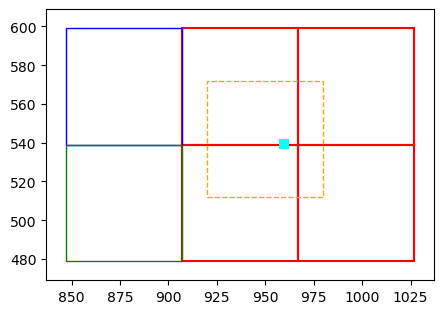

  Stim expansion for shift: [900, 492, 1000, 592]
  Writing lam stim 0: overlap 60, 47
  Writing lam stim 1: overlap 60, 53
  Writing lam stim 2: overlap 33, 53
  Writing lam stim 3: overlap 33, 47
  Writing ETstim 0: overlap 7, 53
  Writing ETstim 1: overlap 7, 47
  Adding fixation point
  Shifting stim...
  CROP: New stim size: 60 x 60
  Done


In [4]:
# Load shifts and previous models
dirname2 = dirname+'0715/et/'
SHfile = sio.loadmat( dirname2 + 'BDshifts1.mat' )
fix_n = SHfile['fix_n']
shifts = SHfile['shifts']
metricsLL = SHfile['metricsLL']
metricsTH = SHfile['metricsTH']
ETshifts = SHfile['ETshifts']
ETmetrics = SHfile['ETmetrics']
Ukeeps = SHfile['Ctrain']
XVkeeps = SHfile['Cval']

# Make 60x60 STAs (and GLMs)
Xshift = 14 #8+4 
Yshift = -3 #-10+4
NX = 60

new_tc = np.array([top_corner[0]-Xshift, top_corner[1]-Yshift], dtype=np.int64)
data.draw_stim_locations(top_corner = new_tc, L=NX)

data.assemble_stimulus(top_corner=[new_tc[0], new_tc[1]], L=NX, fixdot=0, shifts=-shifts, num_lags=num_lags)

In [5]:
goodfix = np.where(ETmetrics[:,1] < 0.80)[0]
valfix = torch.zeros([ETmetrics.shape[0], 1], dtype=torch.float32)
valfix[goodfix] = 1.0
# Test base-level performance (full DFs and then modify DFs)
#DFsave = deepcopy(data2.dfs)  # this is also in data.dfs
data.dfs_out *= valfix
("%0.1f%% fixations remaining"%(100*len(goodfix)/ETmetrics.shape[0]))
dirname2 = dirname+'0715/NewGLMs/'
matdat = sio.loadmat(dirname2+'J0715ProcGLMinfo.mat')

data.dfs.shape

torch.Size([167520, 239])

# interesting cells

In [6]:
# with open('models/dan_gqms/LLinfo.mat', 'rb') as f:
#     LLinfo = sio.loadmat(f)
#     
# print(LLinfo.keys())
# print(LLinfo['ULLsNULL'][0,:])
# print(LLinfo['Udrift_terms'][0,:])
# print(LLinfo['Ucells'][0,:])

In [8]:
num_lags = 16

#interesting_cells = [15, 18, 24, 38, 46, 54, 57]
#interesting_cells = [5,23,39,60,4,93,15,36,37,44]
interesting_cells = [4,39,37,44,8,36]

# load the GLMs and GQMs (from robs and from pred)
cnns_folder = 'cnns_04'
robs_folder = 'dan_gqms' # 'dan_gqms' 'glms_04_debug4'
pred_folder = 'glms_04_pred4'

pred = None
with open('models/'+cnns_folder+'/pred.pkl', 'rb') as f:
    pred = pickle.load(f)

robs_drifts = {}
pred_drifts = {}
robs_glms = {}
robs_gqms = {}
pred_glms = {}  
pred_gqms = {}
for cc in interesting_cells:
    if cc < 10:
        glm_model_filename = 'models/'+robs_folder+'/glmU00'+str(cc)+'.pkl'
        gqm_model_filename = 'models/'+robs_folder+'/gqmU00'+str(cc)+'.pkl'
    elif cc < 100:
        glm_model_filename = 'models/'+robs_folder+'/glmU0'+str(cc)+'.pkl'
        gqm_model_filename = 'models/'+robs_folder+'/gqmU0'+str(cc)+'.pkl'
    else:
        glm_model_filename = 'models/'+robs_folder+'/glmU'+str(cc)+'.pkl'
        gqm_model_filename = 'models/'+robs_folder+'/gqmU'+str(cc)+'.pkl'
        
    with open('models/'+robs_folder+'/drift_model_cc'+str(cc)+'.pkl', 'rb') as f:
        robs_drifts[cc] = pickle.load(f)
    # with open('models/'+robs_folder+'/glm_model_cc'+str(cc)+'.pkl', 'rb') as f:
    #     robs_glms[cc] = pickle.load(f)
    with open(glm_model_filename, 'rb') as f:
        robs_glms[cc] = Model(pickle.load(f), 0)
    # with open('models/'+robs_folder+'/gqm_model_cc'+str(cc)+'.pkl', 'rb') as f:
    #     robs_gqms[cc] = pickle.load(f)
    with open(gqm_model_filename, 'rb') as f:
        robs_gqms[cc] = Model(pickle.load(f), 0)
    with open('models/'+pred_folder+'/drift_model_cc'+str(cc)+'.pkl', 'rb') as f:
        pred_drifts[cc] = pickle.load(f)
    with open('models/'+pred_folder+'/glm_model_cc'+str(cc)+'.pkl', 'rb') as f:
        pred_glms[cc] = pickle.load(f)
    with open('models/'+pred_folder+'/gqm_model_cc'+str(cc)+'.pkl', 'rb') as f:
        pred_gqms[cc] = pickle.load(f)

In [46]:
robs_stas = []
for lag in range(1,8):
    Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
    nspks = torch.sum(Reff, axis=0)
    robs_stas.append(((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy())

pred_stas = []
for lag in range(1,8):
    Reff = torch.mul(pred, data.dfs[:pred.shape[0], valET])
    nspks = torch.sum(Reff, axis=0)
    pred_stas.append(((data.stim[:pred.shape[0]-lag, :].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).detach().numpy())

Null Correlation 562.5282
All Correlation 340.00946
Linear Correlation 340.4593
Quadratic Correlation 480.6946
-------------------
Null CorrCoef 0.020696710291971003
All CorrCoef 0.04376318203128087
Linear CorrCoef 0.043766183745048405
Quadratic CorrCoef 0.01873143616939793
-------------------
Null R2 -11.416091918945312
All R2 -3.3759355545043945
Linear R2 -3.3855485916137695
Quadratic R2 -8.51012897491455
-------------------
Null MSE 0.41569752
All MSE 0.14650871
Linear MSE 0.14683054
Quadratic MSE 0.31840432
-------------------
Null LL 3.8024457
All LL -0.007749319
Linear LL -0.007938623
Quadratic LL -0.015017748
-------------------
Linear Shapley -0.22038128226995468
Quadratic Shapley -0.04880751669406891
Total Shapley -0.2691887989640236
Total LL -0.26918882
-------------------
Linear Shapley 6.58236837387085
Quadratic Shapley 1.4577879905700684
Total Shapley 8.040156364440918
Total LL 8.040156364440918
-------------------
Linear Shapley -181.3770294189453
Quadratic Shapley -41.14

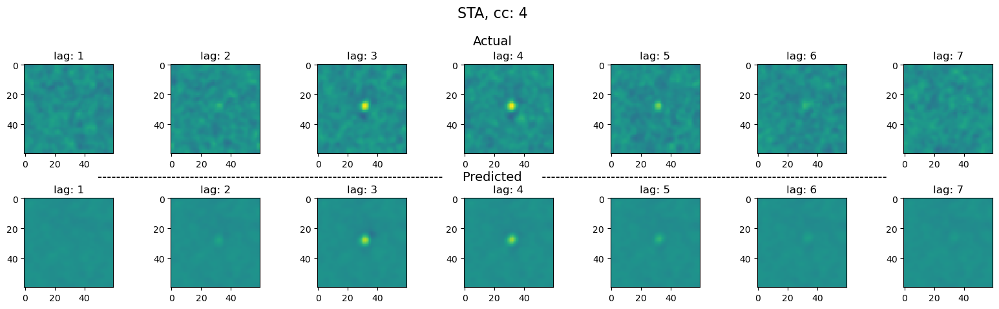

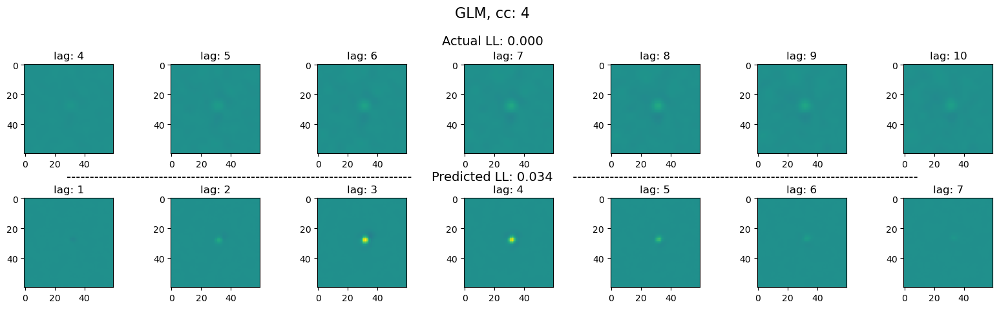

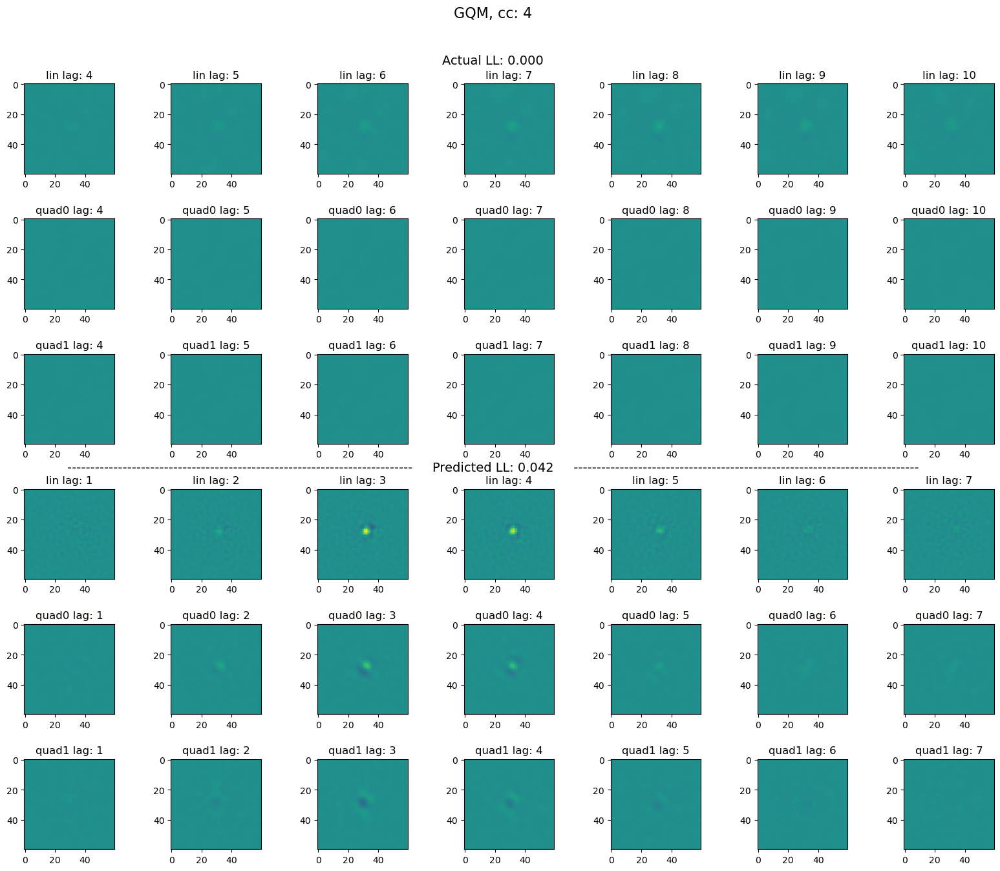

Null Correlation 879.9247
All Correlation 645.4269
Linear Correlation 645.43066
Quadratic Correlation 838.8154
-------------------
Null CorrCoef 0.06543432193770707
All CorrCoef 0.06890769655291347
Linear CorrCoef 0.06890861156712898
Quadratic CorrCoef 0.06638938557464306
-------------------
Null R2 -16.942487716674805
All R2 -8.657255172729492
Linear R2 -8.65733528137207
Quadratic R2 -15.221208572387695
-------------------
Null MSE 0.579251
All MSE 0.31177253
Linear MSE 0.31177512
Quadratic MSE 0.52368164
-------------------
Null LL 3.690331
All LL -0.008999348
Linear LL -0.009011984
Quadratic LL -0.0076904297
-------------------
Linear Shapley -0.23969249427318573
Quadratic Shapley -0.027785971760749817
Total Shapley -0.26747846603393555
Total LL -0.26747847
-------------------
Linear Shapley 7.424552917480469
Quadratic Shapley 0.8606796264648438
Total Shapley 8.285232543945312
Total LL 8.285232543945312
-------------------
Linear Shapley -213.9412841796875
Quadratic Shapley -20.5565

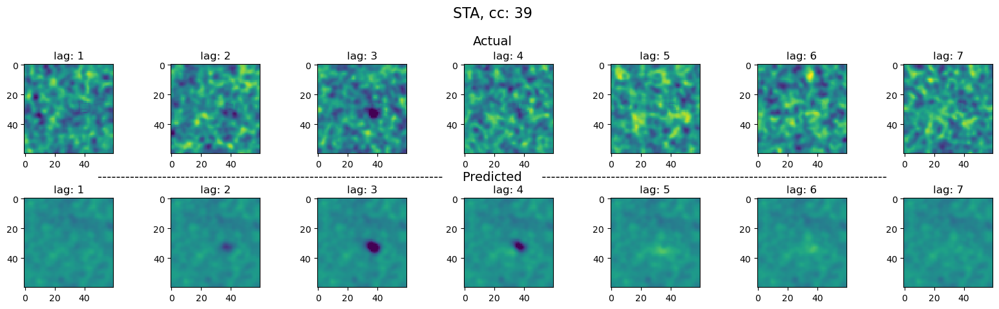

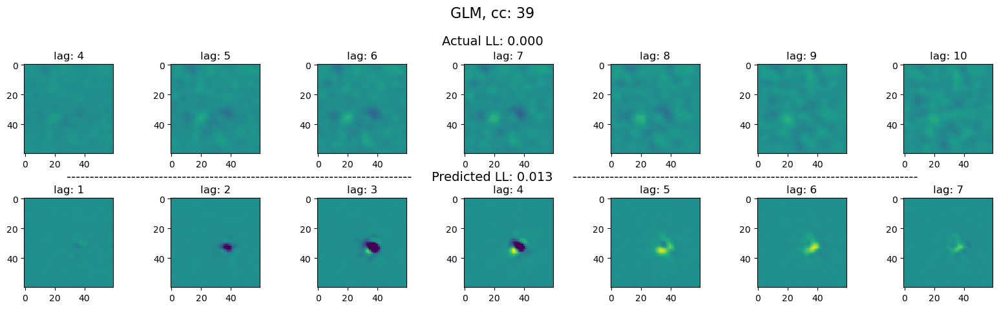

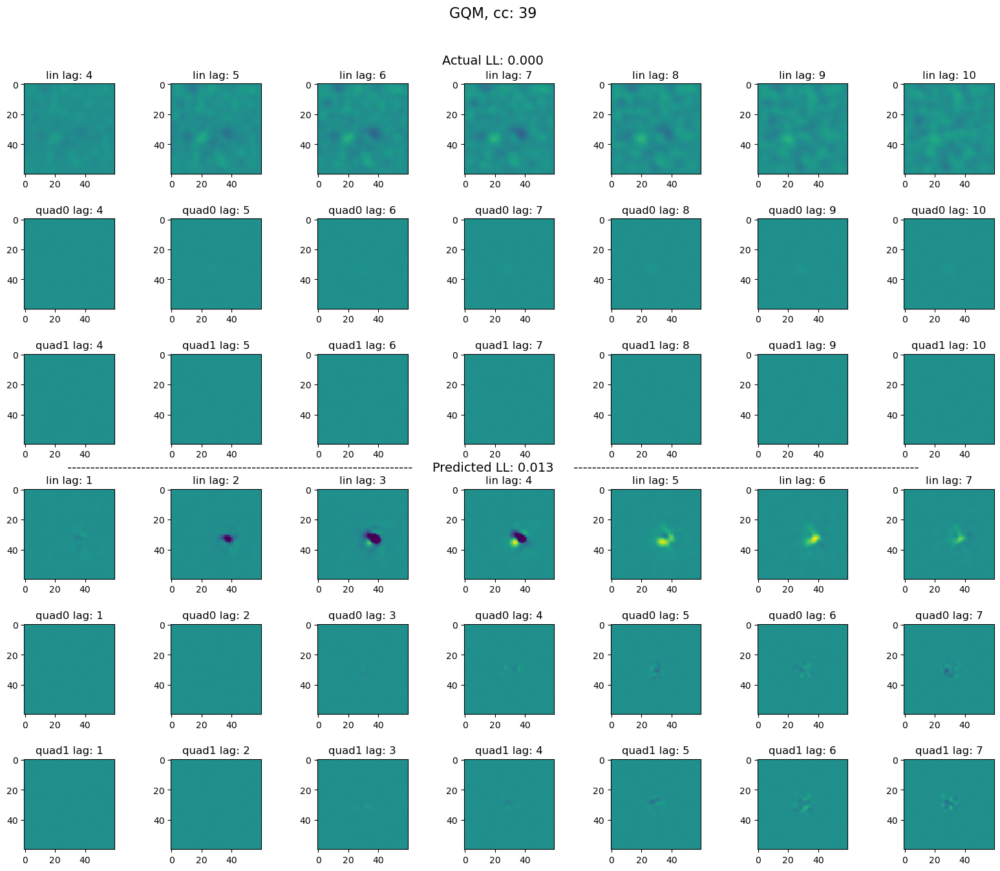

Null Correlation 24597.027
All Correlation 15481.231
Linear Correlation 22170.91
Quadratic Correlation 15697.817
-------------------
Null CorrCoef 0.2117058451085691
All CorrCoef 0.22999393690035844
Linear CorrCoef 0.2133567630666003
Quadratic CorrCoef 0.22810818071831312
-------------------
Null R2 0.04477584362030029
All R2 -0.04560244083404541
Linear R2 0.03946810960769653
Quadratic R2 -0.041376590728759766
-------------------
Null MSE 0.99336183
All MSE 1.0873485
Linear MSE 0.99888146
Quadratic MSE 1.0829539
-------------------
Null LL 5.211093
All LL 0.026796818
Linear LL 0.29341125
Quadratic LL 0.030231476
-------------------
Linear Shapley 0.004957079887390137
Quadratic Shapley 0.08902955055236816
Total Shapley 0.0939866304397583
Total LL 0.09398663
-------------------
Linear Shapley -0.004766792058944702
Quadratic Shapley -0.085611492395401
Total Shapley -0.0903782844543457
Total LL -0.0903782844543457
-------------------
Linear Shapley -1321.3515625
Quadratic Shapley -7794.444

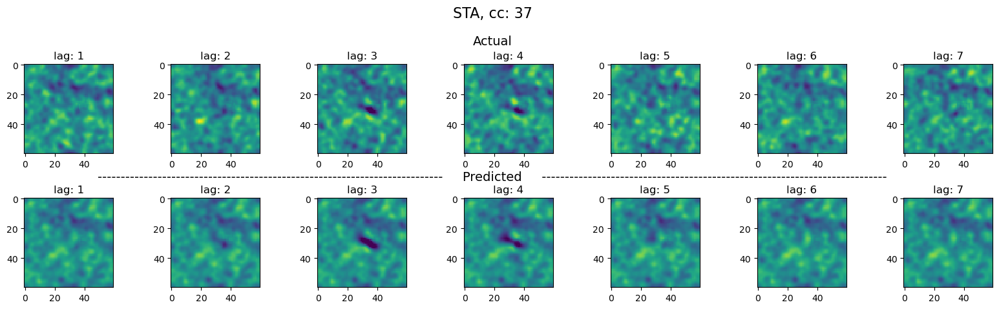

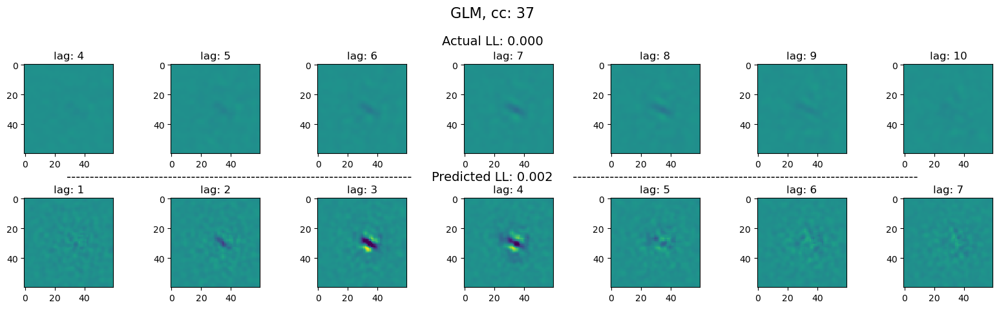

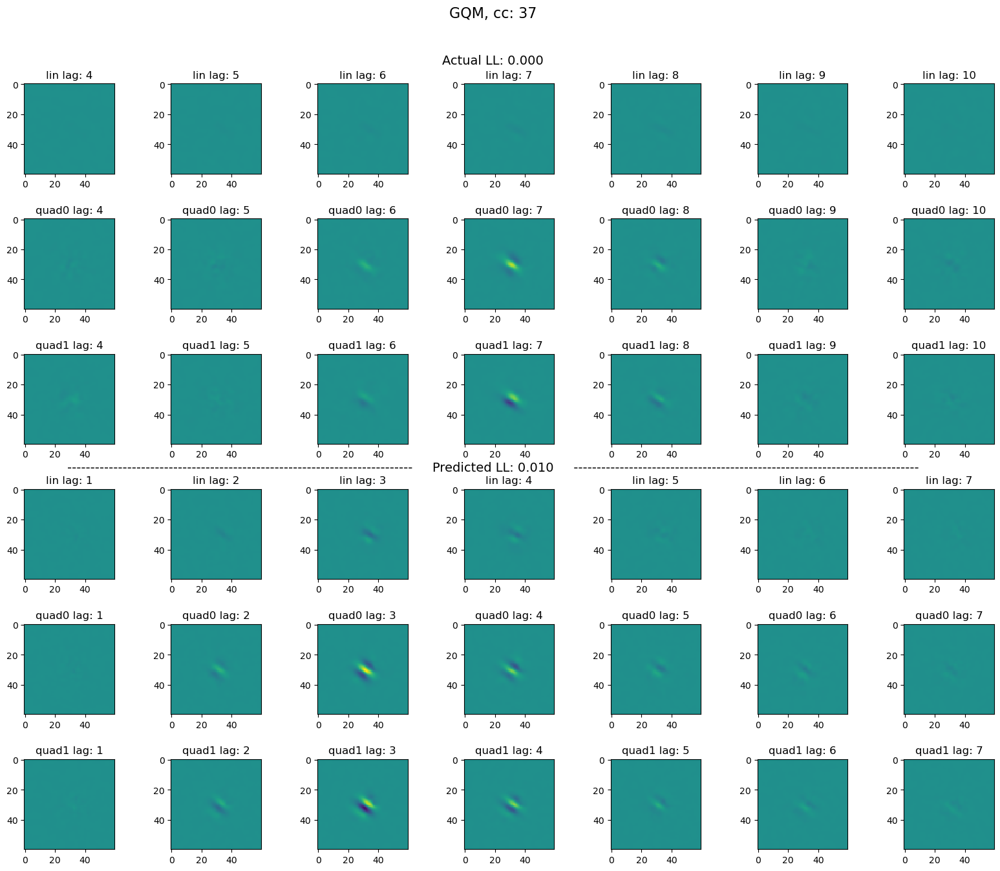

Null Correlation 2352.217
All Correlation 1526.5159
Linear Correlation 2247.2542
Quadratic Correlation 1008.03345
-------------------
Null CorrCoef 0.025808944524128928
All CorrCoef 0.0666408480038532
Linear CorrCoef 0.03759203092434366
Quadratic CorrCoef 0.060312412234561956
-------------------
Null R2 -0.599992036819458
All R2 -0.09981858730316162
Linear R2 -0.4376692771911621
Quadratic R2 -0.023864150047302246
-------------------
Null MSE 0.26638415
All MSE 0.18310982
Linear MSE 0.23935889
Quadratic MSE 0.17046408
-------------------
Null LL 2.7445738
All LL -0.0020987988
Linear LL -0.0052933693
Quadratic LL -0.0022602081
-------------------
Linear Shapley -0.007189765572547913
Quadratic Shapley -0.07608456909656525
Total Shapley -0.08327433466911316
Total LL -0.083274335
-------------------
Linear Shapley 0.04318416118621826
Quadratic Shapley 0.4569892883300781
Total Shapley 0.5001734495162964
Total LL 0.5001734495162964
-------------------
Linear Shapley 206.759765625
Quadratic Sh

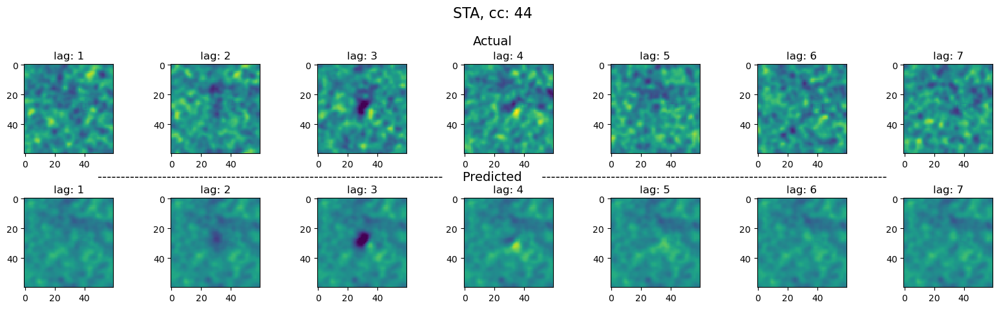

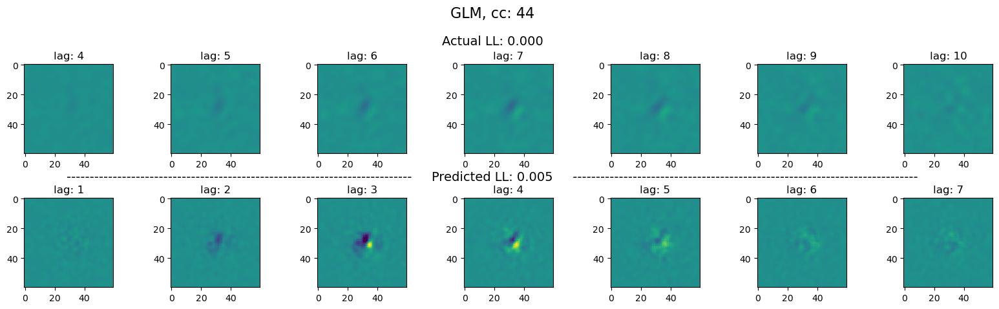

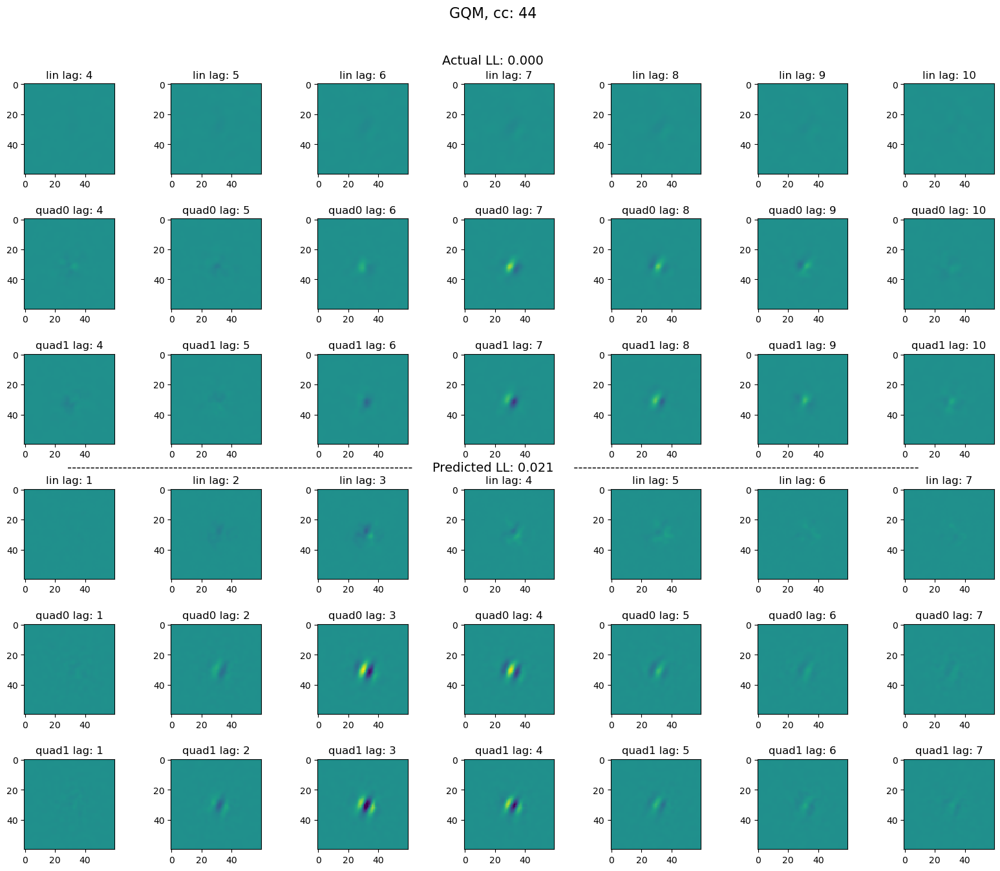

Null Correlation 2384.8477
All Correlation 968.5318
Linear Correlation 1842.007
Quadratic Correlation 1156.221
-------------------
Null CorrCoef 0.10329916849620517
All CorrCoef 0.12060052434667767
Linear CorrCoef 0.11388104943152849
Quadratic CorrCoef 0.11071488118485741
-------------------
Null R2 -3.6162047386169434
All R2 -0.3098996877670288
Linear R2 -1.8842129707336426
Quadratic R2 -0.5592893362045288
-------------------
Null MSE 0.49241439
All MSE 0.13972808
Linear MSE 0.30766138
Quadratic MSE 0.16633068
-------------------
Null LL 2.873675
All LL -0.009339333
Linear LL -0.04014063
Quadratic LL -0.0065658092
-------------------
Linear Shapley -0.10567779839038849
Quadratic Shapley -0.24700850993394852
Total Shapley -0.352686308324337
Total LL -0.3526863
-------------------
Linear Shapley 0.9906907081604004
Quadratic Shapley 2.315614342689514
Total Shapley 3.3063050508499146
Total LL 3.3063050508499146
-------------------
Linear Shapley -365.2649230957031
Quadratic Shapley -1051.

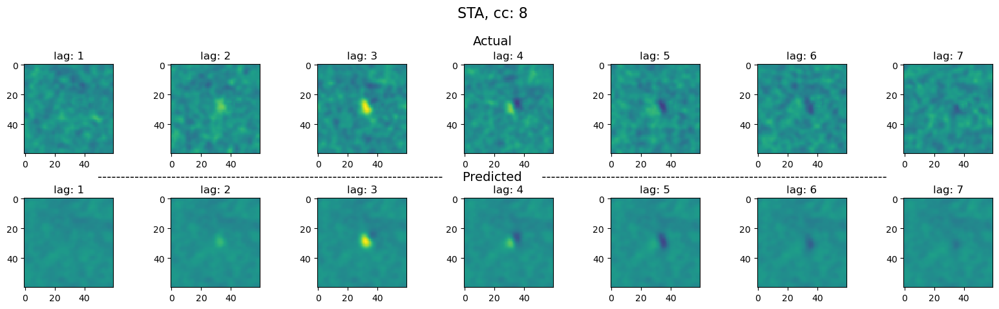

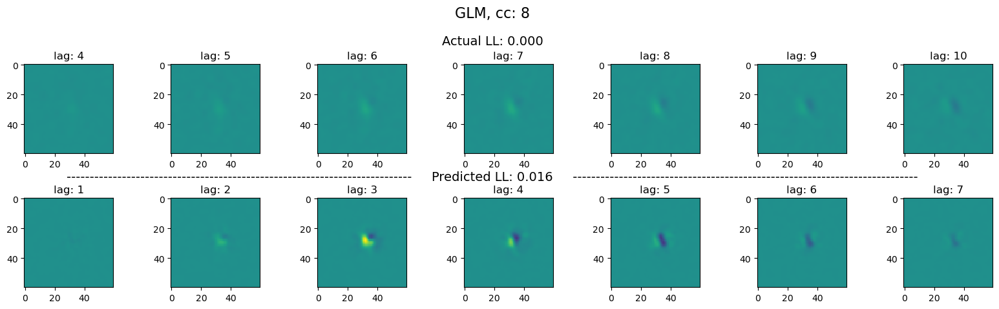

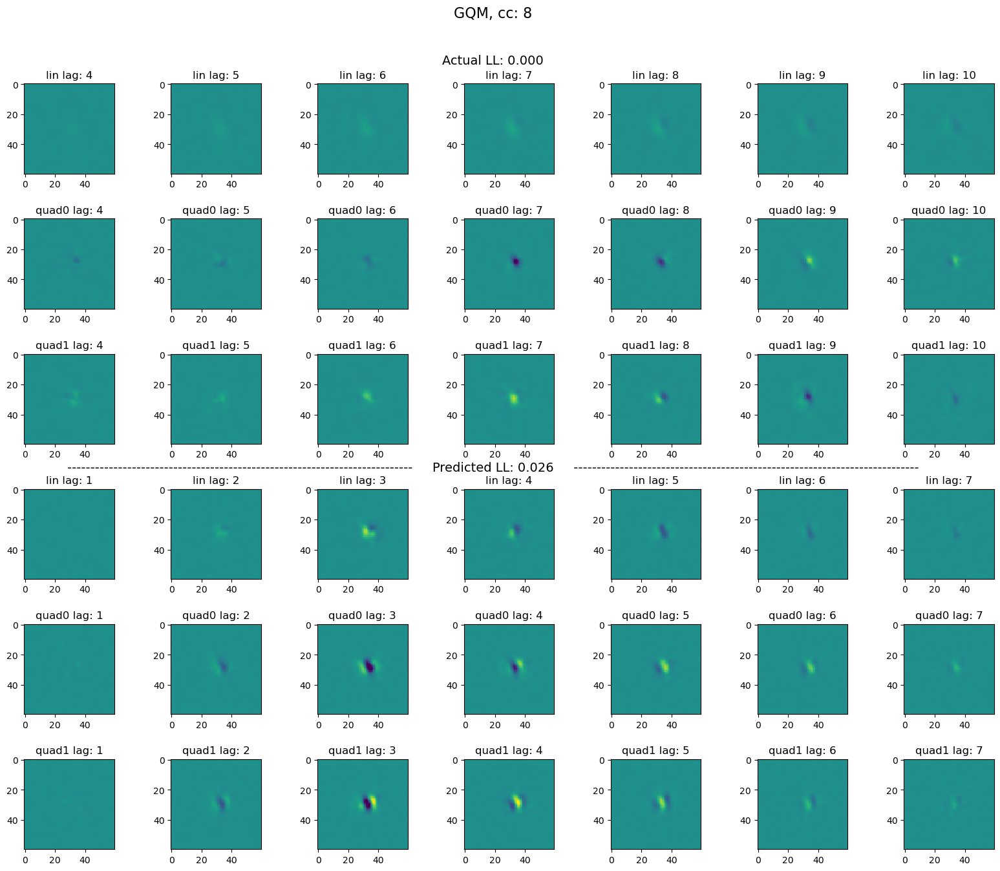

Null Correlation 11504.624
All Correlation 5131.533
Linear Correlation 9063.854
Quadratic Correlation 5833.172
-------------------
Null CorrCoef 0.06429520689423854
All CorrCoef 0.13008999823697892
Linear CorrCoef 0.09171217638973696
Quadratic CorrCoef 0.11155093010536263
-------------------
Null R2 -0.37076735496520996
All R2 0.012719690799713135
Linear R2 -0.11657285690307617
Quadratic R2 0.011631250381469727
-------------------
Null MSE 0.71038514
All MSE 0.51164716
Linear MSE 0.57865167
Quadratic MSE 0.51221126
-------------------
Null LL 3.2140598
All LL -0.0020444393
Linear LL 0.124957085
Quadratic LL 0.006736517
-------------------
Linear Shapley -0.0661487877368927
Quadratic Shapley -0.132589191198349
Total Shapley -0.1987379789352417
Total LL -0.19873798
-------------------
Linear Shapley 0.1276414692401886
Quadratic Shapley 0.2558455765247345
Total Shapley 0.3834870457649231
Total LL 0.3834870457649231
-------------------
Linear Shapley -1571.20458984375
Quadratic Shapley -48

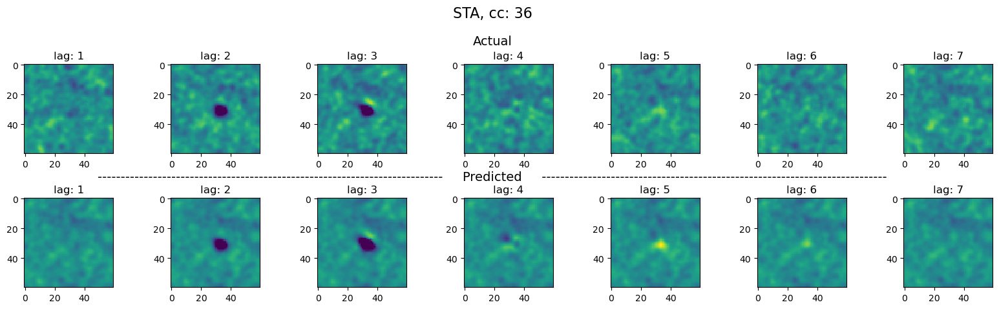

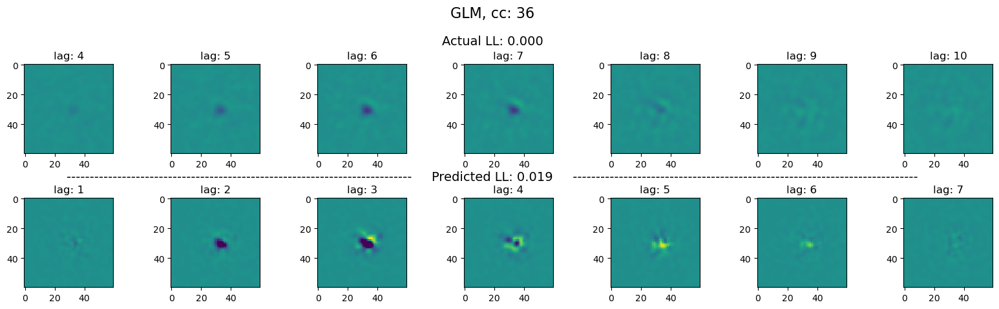

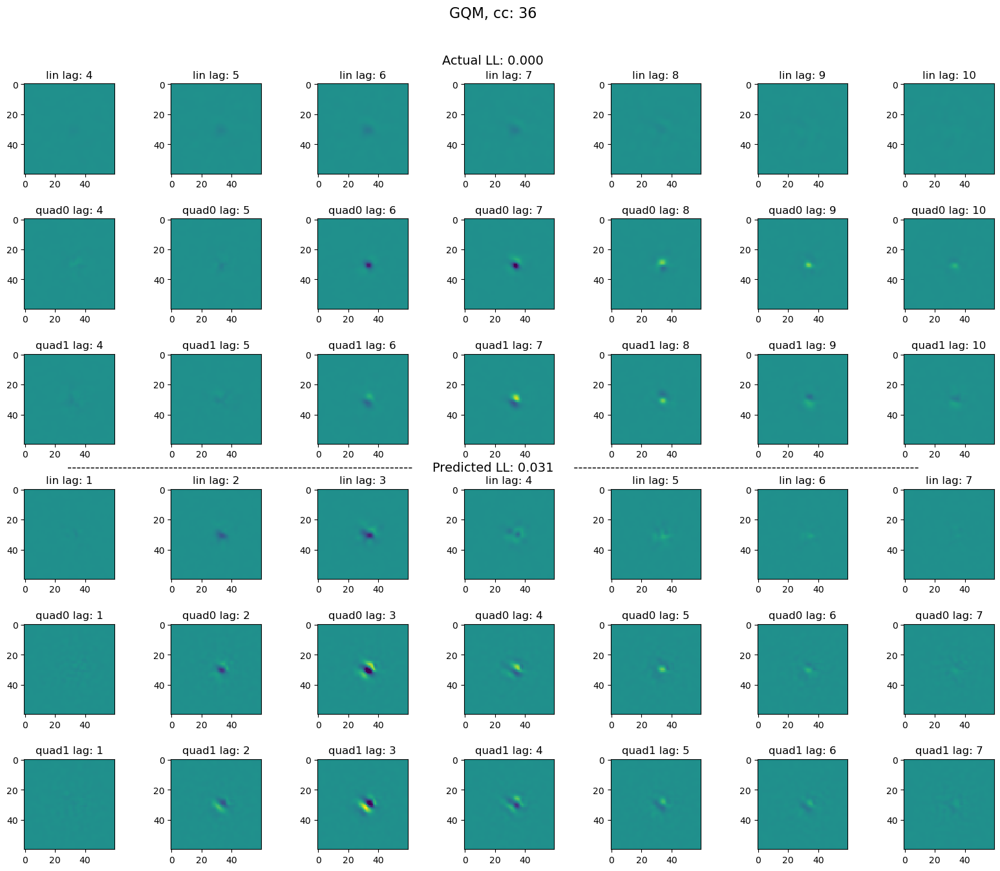

In [47]:
robs_complex_scores = []
pred_complex_scores = []
for cc in interesting_cells:
    #### Complexity ####
    robs_complex_score_corr_robs, robs_complex_score_corr_pred, robs_complex_score_shap_mse, robs_complex_score_shap_r2, robs_complex_score_shap_corr, robs_complex_score_shap_coef, robs_complex_score_shap_ll = complexity(robs_drifts[cc].ndn, robs_gqms[cc].ndn, cc)
    
    robs_complex_scores.append([robs_complex_score_corr_robs, robs_complex_score_corr_pred, robs_complex_score_shap_mse, robs_complex_score_shap_r2, robs_complex_score_shap_corr, robs_complex_score_shap_coef, robs_complex_score_shap_ll])
    
    pred_complex_score_corr_robs, pred_complex_score_corr_pred, pred_complex_score_shap_mse, pred_complex_score_shap_r2, pred_complex_score_shap_corr, pred_complex_score_shap_coef, pred_complex_score_shap_ll = complexity(pred_drifts[cc].ndn, pred_gqms[cc].ndn, cc)
    
    pred_complex_scores.append([pred_complex_score_corr_robs, pred_complex_score_corr_pred, pred_complex_score_shap_mse, pred_complex_score_shap_r2, pred_complex_score_shap_corr, pred_complex_score_shap_coef, pred_complex_score_shap_ll])

    print(f"{'':<15}{'CorrRobs':<15}{'CorrPred':<15}{'ShapleyMSE':<15}{'ShapleyR2':<15}{'ShapleyCorr':<15}{'ShapleyCoef':<15}{'ShapleyLL':<15}")
    print(f"{'   actual':<15}{'%0.3f' % robs_complex_score_corr_robs:<15}{'%0.3f' % robs_complex_score_corr_pred:<15}{'%0.3f' % robs_complex_score_shap_mse:<15}{'%0.3f' % robs_complex_score_shap_r2:<15}{'%0.3f' % robs_complex_score_shap_corr:<15}{'%0.3f' % robs_complex_score_shap_coef:<15}{'%0.3f' % robs_complex_score_shap_ll:<15}")
    print(f"{'   predicted':<15}{'%0.3f' % pred_complex_score_corr_pred:<15}{'%0.3f' % pred_complex_score_corr_pred:<15}{'%0.3f' % pred_complex_score_shap_mse:<15}{'%0.3f' % pred_complex_score_shap_r2:<15}{'%0.3f' % pred_complex_score_shap_corr:<15}{'%0.3f' % pred_complex_score_shap_coef:<15}{'%0.3f' % pred_complex_score_shap_ll:<15}")
    print('-------------------')
    
    
    ##### STA #####
    max_weights = np.max([np.max([np.max(robs_stas[lag][:,:, cc]) for lag in range(len(robs_stas))]),
                         np.max([np.max(pred_stas[lag][:,:, cc]) for lag in range(len(pred_stas))])])

    fig = plt.figure(figsize=(20, 5))
    grid = matplotlib.gridspec.GridSpec(2, 7)
    grid.update(hspace=0.5) # put spacing between rows

    # plot the robs STA
    for col, lag in enumerate(range(len(robs_stas))):
        ax = plt.subplot(grid[0, col])
        imagesc(robs_stas[lag][:,:, cc], max=max_weights, ax=ax)
        plt.title('lag: ' + str(lag+1))

    # plot the pred STA
    for col, lag in enumerate(range(len(pred_stas))):
        ax = plt.subplot(grid[1, col])
        imagesc(pred_stas[lag][:,:, cc], max=max_weights, ax=ax)
        plt.title('lag: ' + str(lag+1))

    # plot text indicating the start of the robs section
    plt.text(0.5, 0.86, 'Actual', horizontalalignment='center', transform=fig.transFigure, fontsize=14)
    # plot text indicating the start of the robs section
    plt.text(0.5, 0.44, '---------------------------------------------------------------------------     Predicted     ---------------------------------------------------------------------------', horizontalalignment='center', transform=fig.transFigure, fontsize=14)

    # adjust the plot down
    plt.subplots_adjust(top=0.8)
    plt.suptitle('STA, cc: ' + str(cc), fontsize=16)


    ##### GLM #####
    max_weights = np.max([np.max(robs_glms[cc].ndn.networks[0].layers[0].get_weights()),
                          np.max(pred_glms[cc].ndn.networks[0].layers[0].get_weights())])

    fig = plt.figure(figsize=(20, 5))
    grid = matplotlib.gridspec.GridSpec(2, 7)
    grid.update(hspace=0.5) # put spacing between rows

    # plot the robs GLM
    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[0, col])
        imagesc(robs_glms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lag: ' + str(15-lag))

    # plot the pred GLM
    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[1, col])
        imagesc(pred_glms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lag: ' + str(15-lag))

    # plot text indicating the start of the robs section
    plt.text(0.5, 0.86, 'Actual LL: %0.3f' % robs_glms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)
    # plot text indicating the start of the robs section
    plt.text(0.5, 0.44, '---------------------------------------------------------------------------     Predicted LL: %0.3f     ---------------------------------------------------------------------------' % pred_glms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)

    # super title
    plt.subplots_adjust(top=0.8)
    plt.suptitle('GLM, cc: ' + str(cc), fontsize=16)


    ##### GQM #####
    max_weights = 0
    weights_lin = np.max([np.max(robs_gqms[cc].ndn.networks[0].layers[0].get_weights()),
                          np.max(pred_gqms[cc].ndn.networks[0].layers[0].get_weights())])
    weights_quad = np.max([np.max(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()),
                           np.max(pred_gqms[cc].ndn.networks[2].layers[0].get_weights())])
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    fig = plt.figure(figsize=(20, 15))
    grid = matplotlib.gridspec.GridSpec(6, 7)
    grid.update(hspace=0.5) # put spacing between rows

    # plot the robs GQM
    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[0, col])
        imagesc(robs_gqms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lin lag: ' + str(15-lag))

    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[1, col])
        imagesc(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('quad0 lag: ' + str(15-lag))

    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[2, col])
        imagesc(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.title('quad1 lag: ' + str(15-lag))
        col += 1

    # plot the pred GQM
    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[3, col])
        imagesc(pred_gqms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lin lag: ' + str(15-lag))

    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[4, col])
        imagesc(pred_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('quad0 lag: ' + str(15-lag))

    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[5, col])
        imagesc(pred_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.title('quad1 lag: ' + str(15-lag))

    # plot text indicating the start of the robs section
    plt.text(0.5, 0.92, 'Actual LL: %0.3f' % robs_gqms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)
    # plot text indicating the start of the robs section
    plt.text(0.5, 0.5, '---------------------------------------------------------------------------     Predicted LL: %0.3f     ---------------------------------------------------------------------------' % pred_gqms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)

    # super title
    plt.subplots_adjust(top=0.9)
    plt.suptitle('GQM, cc: ' + str(cc), fontsize=16)
    plt.show()

# complexity measure

In [58]:
dfs = data.dfs.detach().numpy()

lin_corrs = []
quad_corrs = []
complex_scores = []

for cc in interesting_cells:
    print(cc)
    ll = robs_gqms[cc].LLs
    model = robs_gqms[cc].ndn
    z_lin = model.networks[0].layers[0](data.stim[data.val_inds,:]) # lin
    z_lin = z_lin.cpu().detach().numpy().squeeze()*dfs[data.val_inds,valET[cc]]
    z_quad = model.networks[2].layers[0](data.stim[data.val_inds,:]) # quad
    z_quad = np.sum(z_quad.cpu().detach().numpy(), axis=1)*dfs[data.val_inds, valET[cc]]
    robs = data.robs[data.val_inds,valET[cc]]*dfs[data.val_inds,valET[cc]]
    robs = robs.detach().numpy()

    # rectify the linear
    z_lin = np.where(z_lin < 0, 0, z_lin)

    # min-max scale the activations
    z_lin = (z_lin - np.min(z_lin)) / (np.max(z_lin) - np.min(z_lin))
    z_quad = (z_quad - np.min(z_quad)) / (np.max(z_quad) - np.min(z_quad))

    # correlation between robs and z_lin and z_quad
    lin_corr = np.correlate(robs, z_lin)[0]
    quad_corr = np.correlate(robs, z_quad)[0]

    rect_lin_corr = 0 if lin_corr < 0 else lin_corr
    rect_quad_corr = 0 if quad_corr < 0 else quad_corr
    complex_score = rect_quad_corr / sum([rect_lin_corr, rect_quad_corr])

    lin_corrs.append(lin_corr)
    quad_corrs.append(quad_corr)
    complex_scores.append(complex_score)

    print('Linear Correlation', lin_corr)
    print('Quadratic Correlation', quad_corr)
    print('Complex Score', complex_score)

    # fig = plt.figure(figsize=(15,5))
    # plt.plot(z_lin, label='lin')
    # plt.plot(z_quad, label='quad')
    # #plt.plot(robs, label='robs')
    # plt.legend()
    # plt.show()

4
Linear Correlation 127.63495
Quadratic Correlation 19.081463
Complex Score 0.1300567717901646
8
Linear Correlation 413.91324
Quadratic Correlation 238.83047
Complex Score 0.3658870548399732
9
Linear Correlation 1216.0548
Quadratic Correlation 1300.6611
Complex Score 0.5168088741795156
15
Linear Correlation 1004.43604
Quadratic Correlation 865.6766
Complex Score 0.4629007740717381
36
Linear Correlation 1633.2412
Quadratic Correlation 1484.88
Complex Score 0.4762098398705682
37
Linear Correlation 2717.2998
Quadratic Correlation 2600.266
Complex Score 0.48899555800420097
44
Linear Correlation 531.37836
Quadratic Correlation 501.06024
Complex Score 0.4853172308384619


## lab measure

In [102]:
a = [1, 2, 3]
b = [1, 2, 3]
np.correlate(a, b)[0], np.dot(a,b), np.corrcoef(a,b)[0,0], np.cov(a,b)[0,0], np.sum((a - np.mean(a)) * (b - np.mean(b))) / (len(a)-1)

(14, 14, 1.0, 1.0, 1.0)

In [134]:
def GQM_complexity(cur_mod, data, cellidx, lin_net, quad_net):
    # example: GQM_complexity(gqms[cc], data, valLP[cc], 0, 2 )
    
    # get outputs of linear and quadratic networks
    z_lin = cur_mod.networks[lin_net].layers[0](data.stim[data.val_inds,:]) # lin
    z_quad = cur_mod.networks[quad_net].layers[0](data.stim[data.val_inds,:]) # quad
    robs = data.robs[data.val_inds,cellidx].detach().numpy()
    dfs = data.dfs.detach().numpy()

    robs_valid = robs*dfs[data.val_inds,cellidx]
    z_lin_valid = z_lin.cpu().detach().numpy().squeeze()*dfs[data.val_inds,cellidx]
    z_quad_valid = np.sum(z_quad.cpu().detach().numpy(), axis=1)*dfs[data.val_inds, cellidx]

    # correlation between robs and z_lin and z_quad
    # this is actually just the dot-product of the two vectors
    lin_corr0 = np.correlate(robs_valid, z_lin_valid)[0]
    quad_corr0 = np.correlate(robs_valid, z_quad_valid)[0]
    lin_corr0 = np.sum(robs_valid*z_lin_valid - np.mean(robs_valid)*np.mean(z_lin_valid))
    quad_corr0 = np.sum(robs_valid*z_quad_valid - np.mean(robs_valid)*np.mean(z_quad_valid))
    
    # this is actually the covariance of the two vectors
    lin_corr1 = np.sum((robs_valid - np.mean(robs_valid)) * (z_lin_valid - np.mean(z_lin_valid)))
    quad_corr1 = np.sum((robs_valid - np.mean(robs_valid)) * (z_quad_valid - np.mean(z_quad_valid)))
    
    print(lin_corr0, np.cov(robs_valid, z_lin_valid))
    
    # rectify correlations (don't want anticorrelated noise injected into measure)
    rect_lin_corr0 = 0 if lin_corr0 < 0 else lin_corr0
    rect_quad_corr0 = 0 if quad_corr0 < 0 else quad_corr0

    rect_lin_corr1 = 0 if lin_corr1 < 0 else lin_corr1
    rect_quad_corr1 = 0 if quad_corr1 < 0 else quad_corr1
    
    if rect_lin_corr0 == 0 and rect_quad_corr0 == 0:
        complex_score0 = -1
    else:
        complex_score0 = rect_quad_corr0 / sum([rect_lin_corr0, rect_quad_corr0])

    if rect_lin_corr1 == 0 and rect_quad_corr1 == 0:
        complex_score1 = -1
    else:
        complex_score1 = rect_quad_corr1 / sum([rect_lin_corr1, rect_quad_corr1])
    
    return complex_score0, complex_score1, lin_corr0, quad_corr0, lin_corr1, quad_corr1

In [135]:
for cc in interesting_cells:
    print(GQM_complexity(robs_gqms[cc].ndn, data, valET[cc], 0, 2))

46.200233 [[0.03348154 0.00137505]
 [0.00137505 0.03040053]]
(0.0, 0.0, 46.200233, -0.008338086, 46.20024, -0.008338067)
9.805224 [[0.03228472 0.00029183]
 [0.00029183 0.00661478]]
(0.0, 0.0, 9.805224, -0.0010043088, 9.80522, -0.0010043068)
42.612507 [[1.03995646 0.00126827]
 [0.00126827 0.00168434]]
(0.918387927535116, 0.9183879734540853, 42.612507, 479.52234, 42.61249, 479.52246)
24.82156 [[0.16649588 0.00073876]
 [0.00073876 0.00383168]]
(0.6966508022888452, 0.6966506357054149, 24.82156, 57.00348, 24.821583, 57.003487)
49.271946 [[0.106674   0.00146647]
 [0.00146647 0.0081093 ]]
(0.5557934613072083, 0.5557936409376141, 49.271946, 61.649307, 49.27192, 61.64932)
159.08784 [[0.51825449 0.0047349 ]
 [0.0047349  0.00980675]]
(0.6482112542168922, 0.6482112379496738, 159.08784, 293.13766, 159.0879, 293.13776)


## Shapley values

In [40]:
cc = 15

In [106]:
# [stim_net, drift_net, stim_qnet, net2_comb]
# 1) calculate the correlation between the entire model and the robs
# 2) ablate the linear filter and then the quadratic filter

In [37]:
def r2_score(y_true, y_pred):
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    return 1 - np.sum((y_true - y_pred)**2) / np.sum((y_true - np.mean(y_true))**2)


def complexity(drift, gqm, cc):
    dfs = data.dfs.detach().numpy()
    
    # null predictions
    res_null = drift(data[data.val_blks]).detach().numpy()[:,0]
    res_null = res_null * dfs[data.val_inds,valET[cc]]
    res_null = (res_null - np.min(res_null)) / (np.max(res_null) - np.min(res_null))
    
    # no ablation
    res_all = gqm(data[data.val_blks]).detach().numpy()[:,0]
    res_all = res_all * dfs[data.val_inds,valET[cc]]
    res_all = (res_all - np.min(res_all)) / (np.max(res_all) - np.min(res_all))
    
    # ablate the quadratic filter
    mod_lin = deepcopy(gqm)
    mod_lin.networks[2].layers[0].weight.data = torch.zeros(mod_lin.networks[2].layers[0].weight.data.shape)
    res_lin = mod_lin(data[data.val_blks]).detach().numpy()[:,0]
    res_lin = res_lin * dfs[data.val_inds,valET[cc]]
    res_lin = (res_lin - np.min(res_lin)) / (np.max(res_lin) - np.min(res_lin))
    
    # ablate the linear filter
    mod_quad = deepcopy(gqm)
    mod_quad.networks[0].layers[0].weight.data = torch.zeros(mod_quad.networks[0].layers[0].weight.data.shape)
    res_quad = mod_quad(data[data.val_blks]).detach().numpy()[:,0]
    res_quad = res_quad * dfs[data.val_inds,valET[cc]]
    res_quad = (res_quad - np.min(res_quad)) / (np.max(res_quad) - np.min(res_quad))
    
    robs_cc = data.robs[data.val_inds, valET[cc]].detach().numpy() * dfs[data.val_inds,valET[cc]]
    
    ##########
    z_lin = gqm.networks[0].layers[0](data.stim[data.val_inds,:]) # lin
    z_lin = z_lin.cpu().detach().numpy().squeeze()*dfs[data.val_inds,valET[cc]]
    z_quad = gqm.networks[2].layers[0](data.stim[data.val_inds,:]) # quad
    z_quad = np.sum(z_quad.cpu().detach().numpy(), axis=1)*dfs[data.val_inds, valET[cc]]
    # rectify the linear
    z_lin = np.where(z_lin < 0, 0, z_lin)
    # min-max scale the activations
    z_lin = (z_lin - np.min(z_lin)) / (np.max(z_lin) - np.min(z_lin))
    z_quad = (z_quad - np.min(z_quad)) / (np.max(z_quad) - np.min(z_quad))
    # correlation between robs and z_lin and z_quad
    lin_corr = np.correlate(robs_cc, z_lin)[0]
    quad_corr = np.correlate(robs_cc, z_quad)[0]
    rect_lin_corr = 0 if lin_corr < 0 else lin_corr
    rect_quad_corr = 0 if quad_corr < 0 else quad_corr
    complex_score_corr_robs = rect_quad_corr / sum([rect_lin_corr, rect_quad_corr])
    ##########


    ##########
    z = gqm(data[data.val_blks]).detach().numpy()[:,0]
    z = z * dfs[data.val_inds,valET[cc]]
    z_lin = gqm.networks[0].layers[0](data.stim[data.val_inds,:]) # lin
    z_lin = z_lin.cpu().detach().numpy().squeeze()*dfs[data.val_inds,valET[cc]]
    z_quad = gqm.networks[2].layers[0](data.stim[data.val_inds,:]) # quad
    z_quad = np.sum(z_quad.cpu().detach().numpy(), axis=1)*dfs[data.val_inds, valET[cc]]
    # rectify the linear
    z_lin = np.where(z_lin < 0, 0, z_lin)
    # min-max scale the activations
    z = (z - np.min(z)) / (np.max(z) - np.min(z))
    z_lin = (z_lin - np.min(z_lin)) / (np.max(z_lin) - np.min(z_lin))
    z_quad = (z_quad - np.min(z_quad)) / (np.max(z_quad) - np.min(z_quad))
    # correlation between robs and z_lin and z_quad
    lin_corr = np.correlate(z, z_lin)[0]
    quad_corr = np.correlate(z, z_quad)[0]
    rect_lin_corr = 0 if lin_corr < 0 else lin_corr
    rect_quad_corr = 0 if quad_corr < 0 else quad_corr
    complex_score_corr_pred = rect_quad_corr / sum([rect_lin_corr, rect_quad_corr])
    ##########
    
    
    # calculate the correlation between the ablated filter and the robs
    res_null_corr = np.correlate(robs_cc, res_null)[0]
    res_all_corr = np.correlate(robs_cc, res_all)[0]
    res_lin_corr = np.correlate(robs_cc, res_lin)[0]
    res_quad_corr = np.correlate(robs_cc, res_quad)[0]
    print('Null Correlation', res_null_corr)
    print('All Correlation', res_all_corr)
    print('Linear Correlation', res_lin_corr)
    print('Quadratic Correlation', res_quad_corr)

    # calculate the correlation between the ablated filter and the robs
    res_null_coef = np.corrcoef(robs_cc, res_null)[0,1]
    res_all_coef = np.corrcoef(robs_cc, res_all)[0,1]
    res_lin_coef = np.corrcoef(robs_cc, res_lin)[0,1]
    res_quad_coef = np.corrcoef(robs_cc, res_quad)[0,1]
    print('-------------------')
    print('Null CorrCoef', res_null_coef)
    print('All CorrCoef', res_all_coef)
    print('Linear CorrCoef', res_lin_coef)
    print('Quadratic CorrCoef', res_quad_coef)

    # calculate r2 between the ablated filter and the robs
    res_null_r2 = r2_score(robs_cc, res_null)
    res_all_r2 = r2_score(robs_cc, res_all)
    res_lin_r2 = r2_score(robs_cc, res_lin)
    res_quad_r2 = r2_score(robs_cc, res_quad)
    print('-------------------')
    print('Null R2', res_null_r2)
    print('All R2', res_all_r2)
    print('Linear R2', res_lin_r2)
    print('Quadratic R2', res_quad_r2)

    # calculate the MSE between the ablated filter and the robs
    res_null_mse = np.mean((robs_cc - res_null)**2)
    res_all_mse = np.mean((robs_cc - res_all)**2)
    res_lin_mse = np.mean((robs_cc - res_lin)**2)
    res_quad_mse = np.mean((robs_cc - res_quad)**2)
    print('-------------------')
    print('Null MSE', res_null_mse)
    print('All MSE', res_all_mse)
    print('Linear MSE', res_lin_mse)
    print('Quadratic MSE', res_quad_mse)
    
    # log-likelihood
    res_null_ll = drift.eval_models(data[data.val_blks], null_adjusted=False)[0]
    res_all_ll = res_null_ll - gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]
    res_lin_ll = res_null_ll - mod_lin.eval_models(data[data.val_blks], null_adjusted=False)[0]
    res_quad_ll = res_null_ll - mod_quad.eval_models(data[data.val_blks], null_adjusted=False)[0]
    print('-------------------')
    print('Null LL', res_null_ll)
    print('All LL', res_all_ll)
    print('Linear LL', res_lin_ll)
    print('Quadratic LL', res_quad_ll)
    
    # calculate the shapley values
    shap_lin_mse = (1/2) * (res_lin_mse - res_null_mse) + (1/2) * (res_all_mse - res_quad_mse)
    shap_quad_mse = (1/2) * (res_quad_mse - res_null_mse) + (1/2) * (res_all_mse - res_lin_mse)
    total_shap_mse = shap_lin_mse + shap_quad_mse
    print('-------------------')
    print('Linear Shapley', shap_lin_mse)
    print('Quadratic Shapley', shap_quad_mse)
    print('Total Shapley', total_shap_mse)
    print('Total LL', res_all_mse - res_null_mse)
    complex_score_shap_mse = shap_quad_mse / total_shap_mse

    shap_lin_r2 = (1/2) * (res_lin_r2 - res_null_r2) + (1/2) * (res_all_r2 - res_quad_r2)
    shap_quad_r2 = (1/2) * (res_quad_r2 - res_null_r2) + (1/2) * (res_all_r2 - res_lin_r2)
    total_shap_r2 = shap_lin_r2 + shap_quad_r2
    print('-------------------')
    print('Linear Shapley', shap_lin_r2)
    print('Quadratic Shapley', shap_quad_r2)
    print('Total Shapley', total_shap_r2)
    print('Total LL', res_all_r2 - res_null_r2)
    complex_score_shap_r2 = shap_quad_r2 / total_shap_r2

    shap_lin_corr = (1/2) * (res_lin_corr - res_null_corr) + (1/2) * (res_all_corr - res_quad_corr)
    shap_quad_corr = (1/2) * (res_quad_corr - res_null_corr) + (1/2) * (res_all_corr - res_lin_corr)
    total_shap_corr = shap_lin_corr + shap_quad_corr
    print('-------------------')
    print('Linear Shapley', shap_lin_corr)
    print('Quadratic Shapley', shap_quad_corr)
    print('Total Shapley', total_shap_corr)
    print('Total LL', res_all_corr - res_null_corr)
    complex_score_shap_corr = shap_quad_corr / total_shap_corr

    shap_lin_coef = (1/2) * (res_lin_coef - res_null_coef) + (1/2) * (res_all_coef - res_quad_coef)
    shap_quad_coef = (1/2) * (res_quad_coef - res_null_coef) + (1/2) * (res_all_coef - res_lin_coef)
    total_shap_coef = shap_lin_coef + shap_quad_coef
    print('-------------------')
    print('Linear Shapley', shap_lin_coef)
    print('Quadratic Shapley', shap_quad_coef)
    print('Total Shapley', total_shap_coef)
    print('Total LL', res_all_coef - res_null_coef)
    complex_score_shap_coef = shap_quad_coef / total_shap_coef

    shap_lin_ll = (1/2) * (res_lin_ll - res_null_ll) + (1/2) * (res_all_ll - res_quad_ll)
    shap_quad_ll = (1/2) * (res_quad_ll - res_null_ll) + (1/2) * (res_all_ll - res_lin_ll)
    total_shap_ll = shap_lin_ll + shap_quad_ll
    print('-------------------')
    print('Linear Shapley', shap_lin_ll)
    print('Quadratic Shapley', shap_quad_ll)
    print('Total Shapley', total_shap_ll)
    print('Total LL', res_all_ll - res_null_ll)
    complex_score_shap_ll = shap_quad_ll / total_shap_ll
    
    print('-------------------')
    print('Complex Score CorrRobs: ', complex_score_corr_robs)
    print('Complex Score CorrPred: ', complex_score_corr_pred)
    print('Complex Score ShapleyMSE: ', complex_score_shap_mse)
    print('Complex Score ShapleyR2: ', complex_score_shap_r2)
    print('Complex Score ShapleyCorr: ', complex_score_shap_corr)
    print('Complex Score ShapleyCoef: ', complex_score_shap_coef)
    print('Complex Score ShapleyLL: ', complex_score_shap_ll)
    
    return complex_score_corr_robs, complex_score_corr_pred, complex_score_shap_mse, complex_score_shap_r2, complex_score_shap_corr, complex_score_shap_coef, complex_score_shap_ll

In [ ]:
dfs = data.dfs.detach().numpy()

lin_corrs = []
quad_corrs = []
complex_scores = []

z_lin = model.networks[0].layers[0](data.stim[data.val_inds,:]) # lin
z_lin = z_lin.cpu().detach().numpy().squeeze()*dfs[data.val_inds,valET[cc]]
z_quad = model.networks[2].layers[0](data.stim[data.val_inds,:]) # quad
z_quad = np.sum(z_quad.cpu().detach().numpy(), axis=1)*dfs[data.val_inds, valET[cc]]
robs = data.robs[data.val_inds,valET[cc]]*dfs[data.val_inds,valET[cc]]
robs = robs.detach().numpy()

# set the lin weights to zero
model.networks[0].layers[0].weight(np.zeros(model.networks[0].layers[0].get_weights().shape))

# rectify the linear
z_lin = np.where(z_lin < 0, 0, z_lin)

# min-max scale the activations
z_lin = (z_lin - np.min(z_lin)) / (np.max(z_lin) - np.min(z_lin))
z_quad = (z_quad - np.min(z_quad)) / (np.max(z_quad) - np.min(z_quad))

# correlation between robs and z_lin and z_quad
lin_corr = np.correlate(robs, z_lin)[0]
quad_corr = np.correlate(robs, z_quad)[0]

rect_lin_corr = 0 if lin_corr < 0 else lin_corr
rect_quad_corr = 0 if quad_corr < 0 else quad_corr
complex_score = rect_quad_corr / sum([rect_lin_corr, rect_quad_corr])

lin_corrs.append(lin_corr)
quad_corrs.append(quad_corr)
complex_scores.append(complex_score)

print('Linear Correlation', lin_corr)
print('Quadratic Correlation', quad_corr)
print('Complex Score', complex_score)

# STAs

In [ ]:
Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
nspks = torch.sum(Reff, axis=0)
lag = 4
stas = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy()
print(stas.shape)

# plot some STAs
ss(29,6)
for cc in range(NCv):
    plt.subplot(29,6, cc+1)
    imagesc(stas[:,:, cc])
    plt.title(str(cc) + ' -- ' + str(valET[cc]))
plt.show()

# simplest GLM

In [14]:
lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-8,
    tolerance_grad=1e-8,
    history_size=100,
    batch_size=20,
    max_epochs=3,
    max_iter=500,
    device=device)

# glm net
Treg = 1
Xreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 10.0 # [4.0]
glm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=1, bias=True, num_lags=num_lags,
    NLtype='softplus', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

glm = NDN.NDN(ffnet_list = [stim_net], loss_type='poisson')
glm.block_sample=True

glm.fit(data, force_dict_training=True, **lbfgs_pars)
LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]
print('LL: ' + str(LL))


GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 10.01384687423706 sec elapsed
LL: 2.7501824


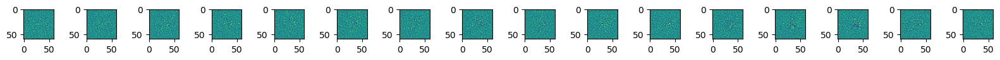

In [15]:
max_weights = np.max(glm.networks[0].layers[0].get_weights())
ss(1,num_lags)
col = 1
for lag in range(num_lags):
    plt.subplot(1,num_lags, col)
    imagesc(glm.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
    col += 1
plt.show()

# define models

In [6]:
#set up fits
Treg = 1
Xreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 10.0 # [4.0]

# drift network
drift_pars1 = NDNLayer.layer_dict(
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} }
# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'
drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

# glm net
glm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

# gqm net
num_subs = 2
gqm_layer = Tlayer.layer_dict(
    input_dims=data.stim_dims, num_filters=num_subs, num_inh=0, bias=False, num_lags=num_lags,
    NLtype='square', initialize_center = True)
gqm_layer['reg_vals'] = {'d2x': Xreg, 'd2t': Treg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':10}
stim_qnet =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [gqm_layer] )

#combine glm
comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#combine gqm
comb2_layer = ChannelLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb2_layer['weights_initializer'] = 'ones'

net2_comb = FFnetwork.ffnet_dict(
    xstim_n = None, ffnet_n=[0,1,2],
    layer_list = [comb2_layer], ffnet_type='normal')
net2_comb['layer_list'][0]['bias'] = True

# Drifts

## fit Drifts

In [28]:
def fit_drift(i, cc, folder):
    drift_model_filename = 'models/'+folder+'/drift_model_cc'+str(cc)+'.pkl'

    # continue if the file already exists
    if os.path.isfile(drift_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(drift_model_filename, 'rb') as f:
            drift = pickle.load(f)
        return drift

    #data.set_cells(valET[cc])
    data.set_cells(cc)

    lbfgs_pars = utils.create_optimizer_params(
        optimizer_type='lbfgs',
        tolerance_change=1e-8,
        tolerance_grad=1e-8,
        history_size=100,
        batch_size=20,
        max_epochs=3,
        max_iter = 500,
        device = device)

    drift_ndn = NDN.NDN(
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_ndn.block_sample=True
    drift_ndn.networks[0].xstim_n = 'Xdrift'

    drift_ndn.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LL = drift_ndn.eval_models(data[data.val_blks], null_adjusted=False)[0]

    drift_model = Model(drift_ndn, LL)

    with open(drift_model_filename, 'wb') as f:
        pickle.dump(drift_model, f)

    return drift_model

In [29]:
drifts = []
for i, cc in enumerate(range(NCv)):
    drift = fit_drift(i, cc, 'glms_04')
    drifts.append(drift)

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot Drifts

2.7355845
1.2411203
3.0280707
2.854318
4.6128283
3.698863
3.0716097
3.0932338
3.2692719
1.9164429
2.8974762
2.451341
2.300203
2.828572
2.957735
2.3432038
1.812411
2.9674172
4.4622984
2.9897134
2.2309422
2.4930203
1.8570822
1.642056
3.4153469
2.7380903
3.3126922


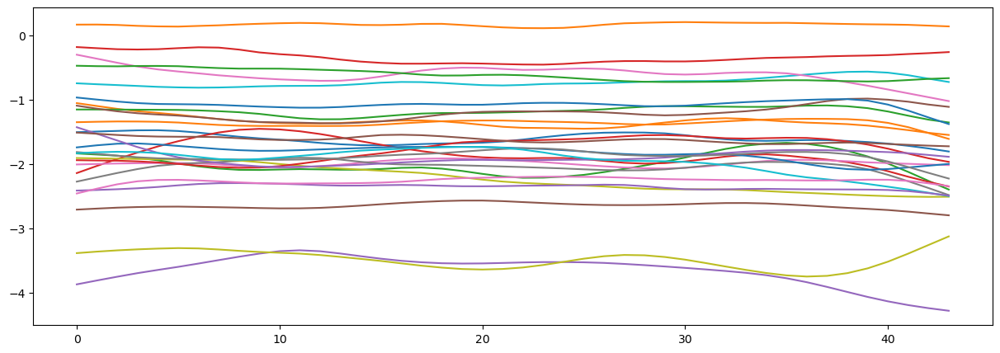

In [156]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    print(drift.LLs)
    plt.plot(drift.ndn.networks[0].layers[0].get_weights())

# GLMs

## fit GLMs

In [211]:
from ColorDataUtils.optimize import Optimizer

d2x_vals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
glocal_vals = [0.001, 0.1, 1, 10, 100, 1000] # glocal
l1_vals = [0.001, 0.01, 0.1, 1] # L1

val_lists_map = {'d2x': d2x_vals, 'd2t': d2x_vals, 'glocalx': glocal_vals, 'l1': l1_vals}

def fit_glm(i, cc, folder):
    glm_model_filename = 'models/'+folder+'/glm_model_cc'+str(cc)+'.pkl'
    # if i < 10:
    #     glm_model_filename = 'models/'+folder+'/glmU00'+str(cc)+'.pkl'
    # elif i < 100:
    #     glm_model_filename = 'models/'+folder+'/glmU0'+str(cc)+'.pkl'
    # else:
    #     glm_model_filename = 'models/'+folder+'/glmU'+str(cc)+'.pkl'

    drift_weights = drifts[i].ndn.networks[0].layers[0].weight.data[:,0]

    # continue if the file already exists
    if os.path.isfile(glm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(glm_model_filename, 'rb') as f:
            glm = pickle.load(f)
        return glm

    #data.set_cells(valET[cc])
    data.set_cells(cc)

    LLsNULL = drifts[i].LLs

    lbfgs_pars = utils.create_optimizer_params(
        optimizer_type='lbfgs',
        tolerance_change=1e-8,
        tolerance_grad=1e-8,
        history_size=100,
        batch_size=20,
        max_epochs=3,
        max_iter=500,
        device=device)
    
    # optimize the d2x, d2t, d2xt, and glocalx first
    def objective(key, val, best_model):
        if best_model is None:
            glm = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
            glm.block_sample=True
            glm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
            glm.networks[1].layers[0].set_parameters(val=False)
            glm.networks[2].layers[0].set_parameters(val=False,name='weight')
        else:
            glm = deepcopy(best_model)

        # set the reg_vals for the key
        glm.networks[0].layers[0].reg.vals[key] = val

        glm.fit(data, force_dict_training=True, **lbfgs_pars)
        LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]

        null_adjusted_LL = LLsNULL - LL

        return glm, null_adjusted_LL

    optimizer = Optimizer(objective, val_lists_map)

    best_model, best_LL, best_vals, best_LLs = optimizer.optimize()

    glm_model = Model(best_model, best_LL)

    with open(glm_model_filename, 'wb') as f:
        pickle.dump(glm_model, f)

    return glm_model

In [168]:
glms = []
for i, cc in enumerate(range(NCv)):
    glm = fit_glm(i, cc, 'dan_gqms')
    glms.append(glm)

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot GLMs

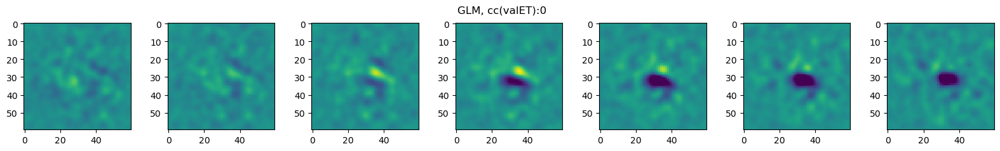

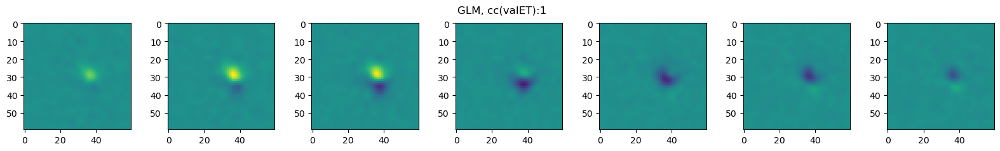

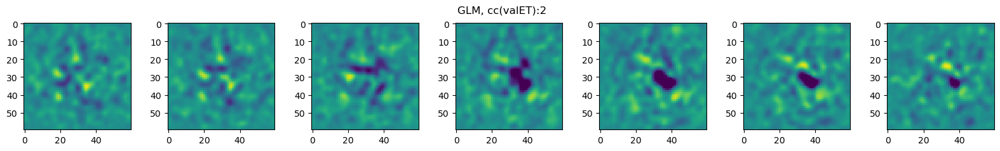

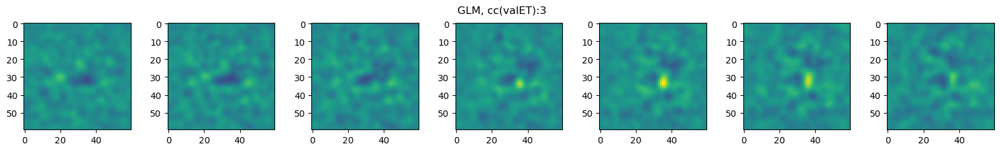

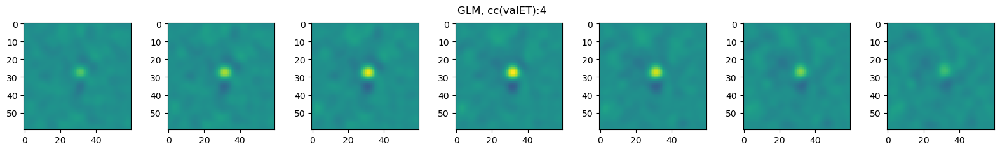

...

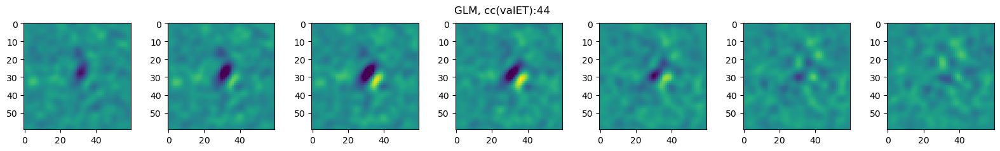

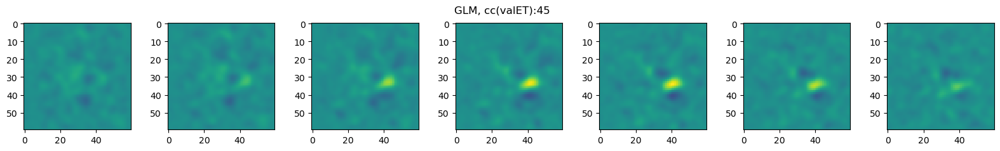

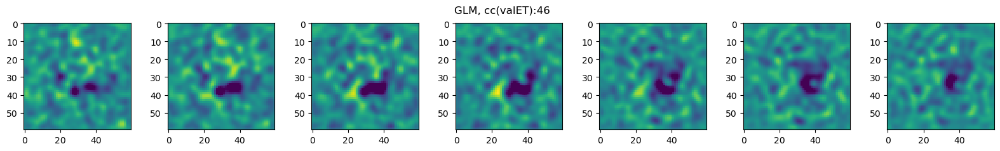

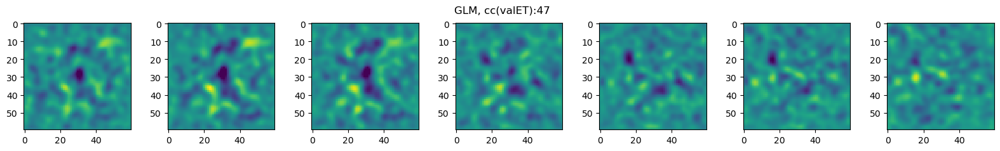

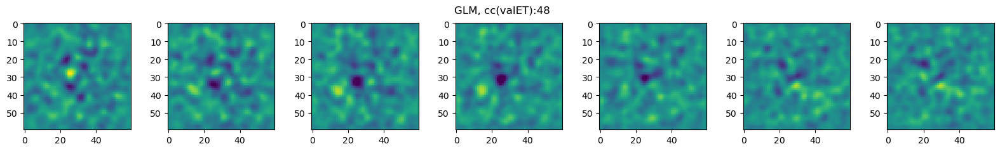


KeyboardInterrupt



In [197]:
num_lags = 12
for i in range(len(glms)):
    max_weights = np.max(glms[i].networks[0].layers[0].get_weights())
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(glms[i].networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        #plt.suptitle('GLM, cc(valET):' + str(i) + ' LL: ' + str(glms[i].LLs))
        plt.suptitle('GLM, cc(valET):' + str(i))
        col += 1
    plt.show()

# GQMs

## fit GQMs (2)

In [12]:
from ColorDataUtils.optimize import Optimizer

d2x_vals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
glocal_vals = [0.001, 0.1, 1, 10, 100, 1000] # glocal
l1_vals = [0.001, 0.01, 0.1, 1] # L1

val_lists_map = {'d2x': d2x_vals, 'd2t': d2x_vals, 'glocalx': glocal_vals, 'l1': l1_vals}

# fit a GQM using my simpler Optimizer
def fit_gqm2(i, cc, folder):
    #gqm_model_filename = 'models/'+folder+'/gqm_model_cc'+str(cc)+'.pkl'
    if i < 10:
        gqm_model_filename = 'models/'+folder+'/gqmU00'+str(cc)+'.pkl'
    elif i < 100:
        gqm_model_filename = 'models/'+folder+'/gqmU0'+str(cc)+'.pkl'
    else:
        gqm_model_filename = 'models/'+folder+'/gqmU'+str(cc)+'.pkl'
    
    # continue if the file already exists
    if os.path.isfile(gqm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(gqm_model_filename, 'rb') as f:
            gqm = pickle.load(f)
        return gqm

    drift_weights = drifts[i].ndn.networks[0].layers[0].weight.data[:,0]
    
    #data.set_cells(valET[cc])
    data.set_cells(cc)
    
    LLsNULL = drifts[i].LLs
    
    # get the best reg_vals for the GLM
    best_reg_vals = glms[i].ndn.networks[0].layers[0].reg.vals
    
    lbfgs_pars = utils.create_optimizer_params(
        optimizer_type='lbfgs',
        tolerance_change=1e-8,
        tolerance_grad=1e-8,
        history_size=100,
        batch_size=20,
        max_epochs=3,
        max_iter = 500,
        device = device)
    
    
    # optimize the d2x, d2t, d2xt, and glocalx first
    def objective(key, val, best_model):
        # get the best reg_vals for the GLM
        stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)
        
        if best_model is None:
            gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
            gqm.networks[0].layers[0] = deepcopy(glms[i].ndn.networks[0].layers[0])
            gqm.block_sample=True
            gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
            gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
            gqm.networks[1].layers[0].set_parameters(val=False)
        else:
            gqm = deepcopy(best_model)
    
        # set the reg_vals for the key
        gqm.networks[2].layers[0].reg.vals[key] = val
        
        gqm.fit(data, force_dict_training=True, **lbfgs_pars)
        LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]
    
        null_adjusted_LL = LLsNULL - LL
    
        return gqm, null_adjusted_LL
    
    optimizer = Optimizer(objective, val_lists_map)

    best_model, best_LL, best_vals, best_LLs = optimizer.optimize()

    gqm_model = Model(best_model, best_LL)
    
    with open(gqm_model_filename, 'wb') as f:
        pickle.dump(gqm_model, f)
    
    return gqm_model

In [13]:
gqms = []
for i, cc in enumerate(range(NCv)):
    gqm = fit_gqm2(i, cc, 'dan_gqms')
    gqms.append(gqm)

loading model 0
loading model 1
loading model 2
loading model 3
loading model 4
loading model 5
loading model 6
loading model 7
loading model 8
loading model 9
loading model 10
loading model 11
loading model 12
loading model 13
loading model 14
loading model 15
loading model 16
loading model 17
loading model 18
loading model 19
loading model 20
loading model 21
loading model 22
loading model 23
loading model 24
loading model 25
loading model 26
loading model 27
loading model 28
loading model 29
loading model 30
loading model 31
loading model 32
loading model 33
loading model 34
loading model 35
loading model 36
loading model 37
loading model 38
loading model 39
loading model 40
loading model 41
loading model 42
loading model 43
loading model 44
loading model 45
loading model 46
loading model 47
loading model 48
loading model 49
loading model 50
loading model 51
loading model 52
loading model 53
loading model 54
loading model 55
loading model 56
loading model 57
loading model 58
loading

## plot GQMs (2)

complexity 0.359 motion 0.348 x 0.077 y 0.348
-------------


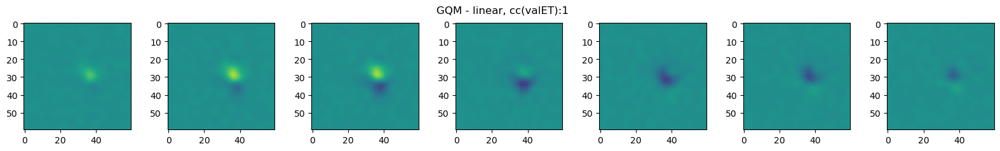

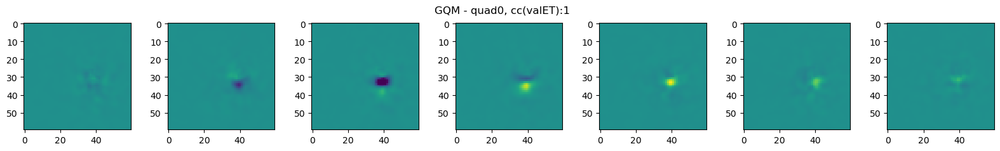

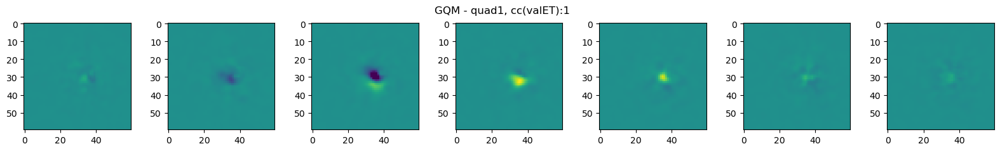

complexity 0.0 motion 0.282 x 0.282 y -0.06
-------------


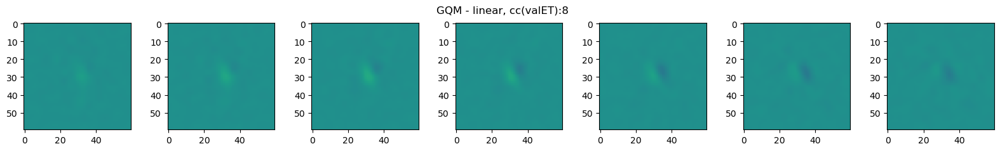

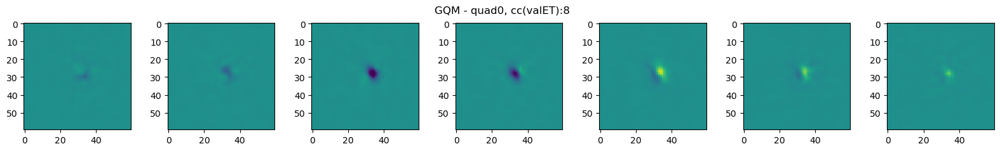

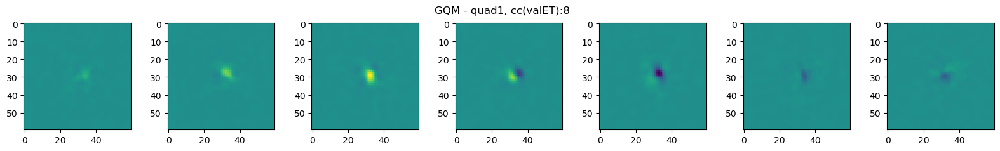

complexity 0.617 motion 0.273 x 0.273 y 0.173
-------------


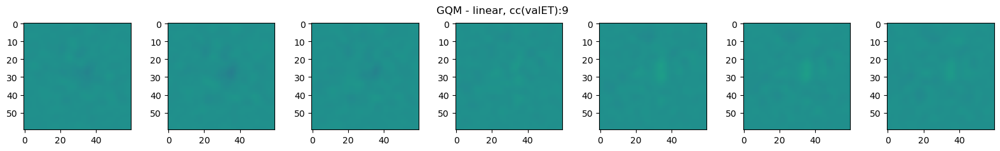

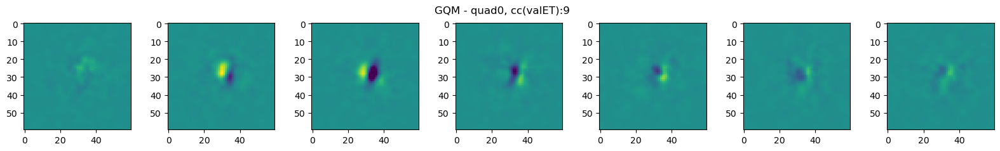

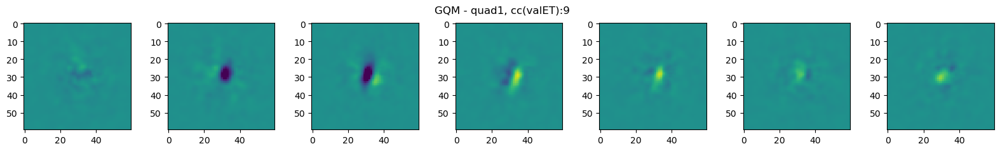

complexity 0.5 motion 0.207 x 0.207 y 0.087
-------------


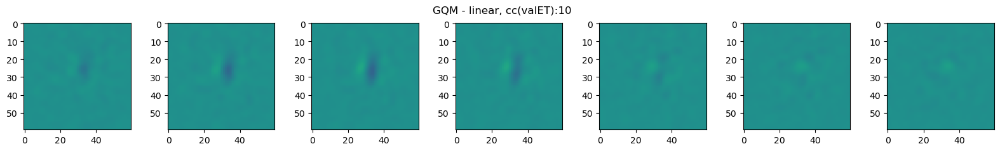

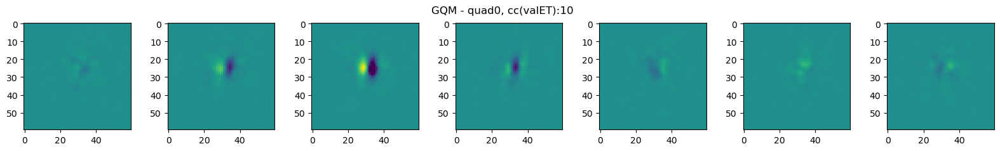

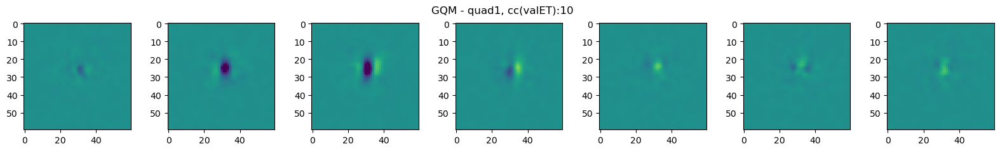

complexity 1.0 motion 0.215 x 0.215 y 0.201
-------------


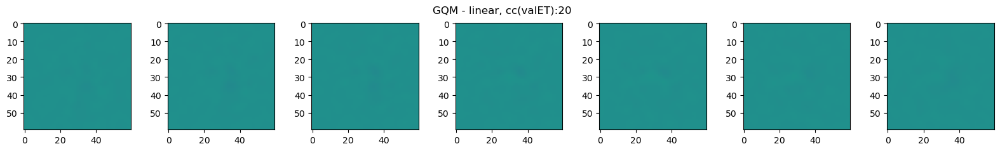

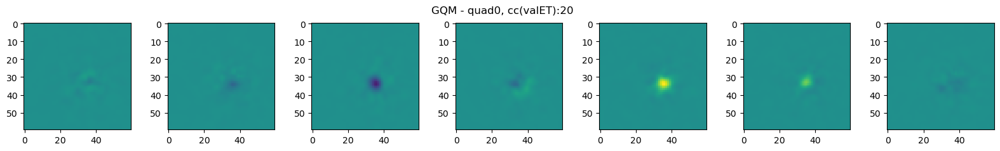

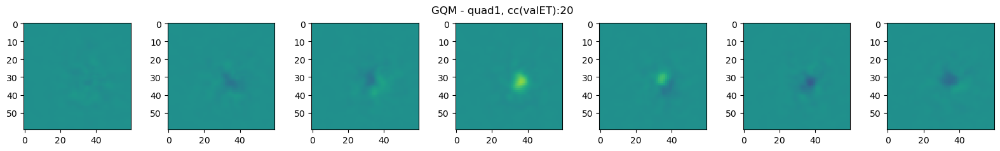

complexity 0.581 motion 0.273 x 0.273 y 0.214
-------------


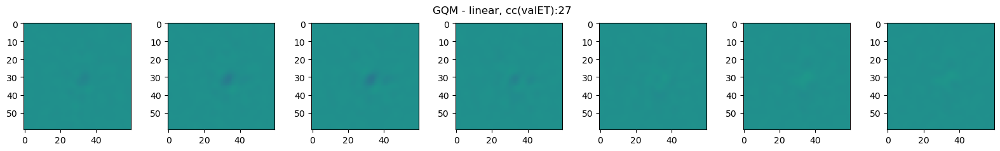

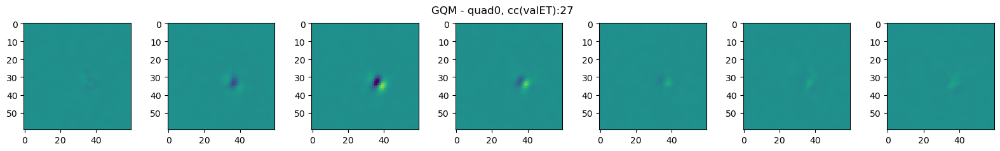

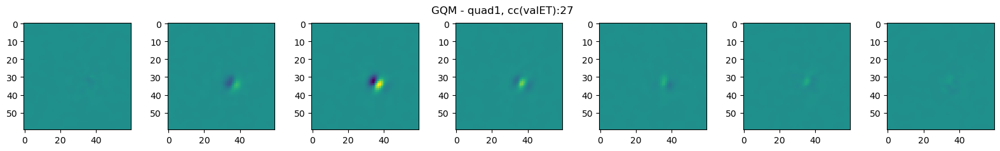

complexity 1.0 motion 0.266 x 0.135 y -0.266
-------------


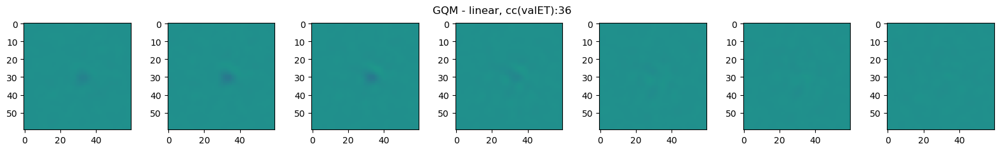

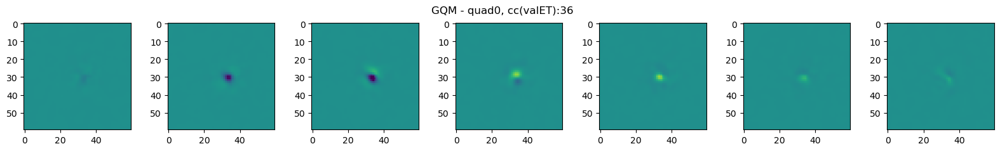

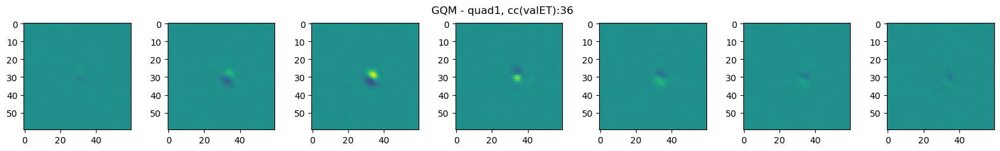

complexity 1.0 motion 0.204 x -0.204 y -0.057
-------------


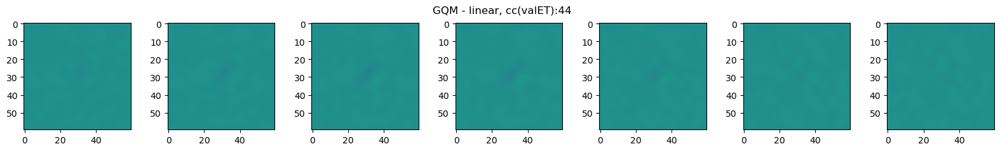

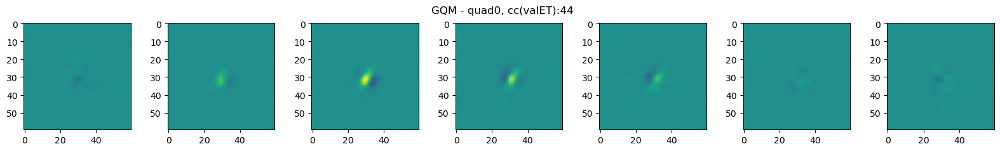

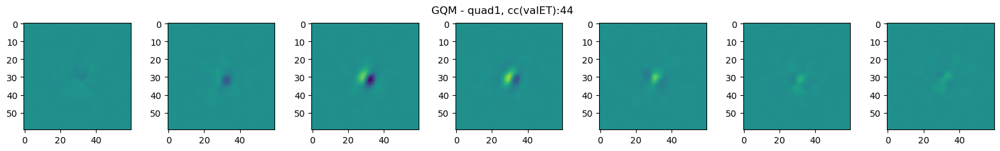

complexity 0.645 motion 0.279 x -0.279 y -0.12
-------------


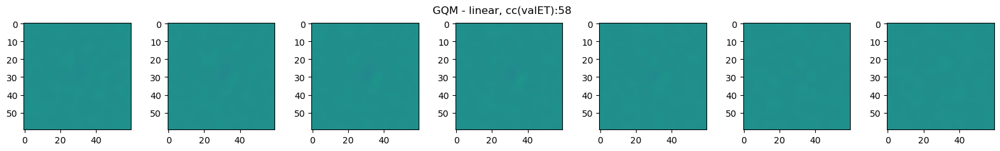

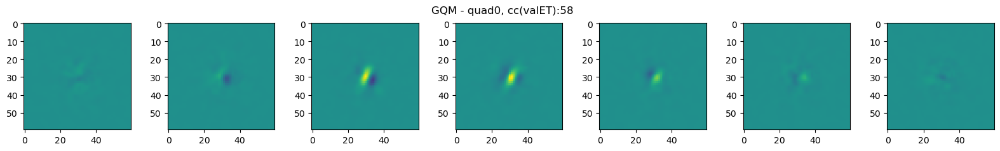

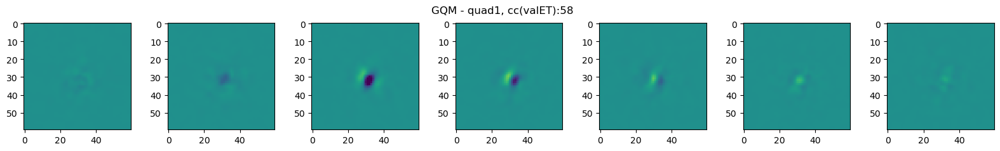

complexity 1.0 motion 0.221 x -0.221 y -0.118
-------------


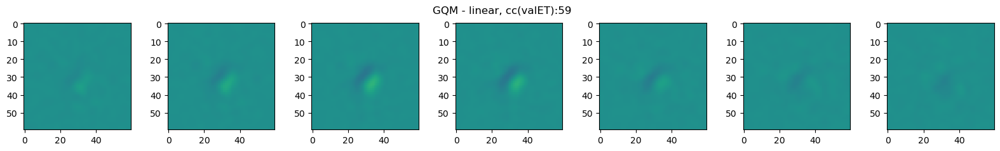

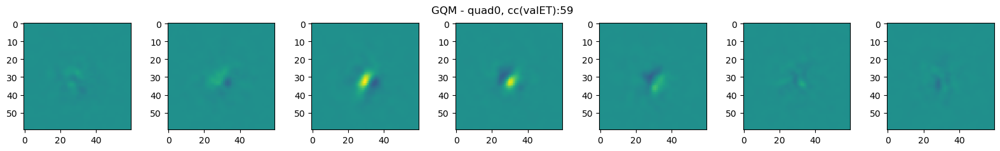

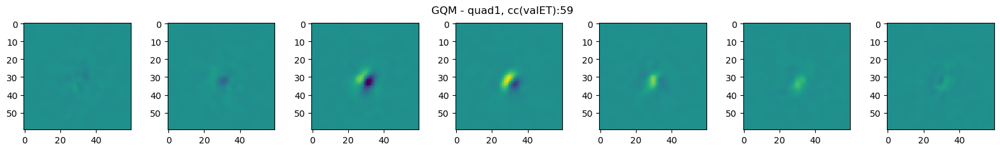

complexity 0.5 motion 0.358 x 0.358 y -0.148
-------------


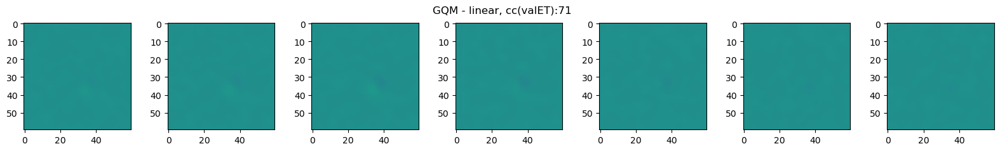

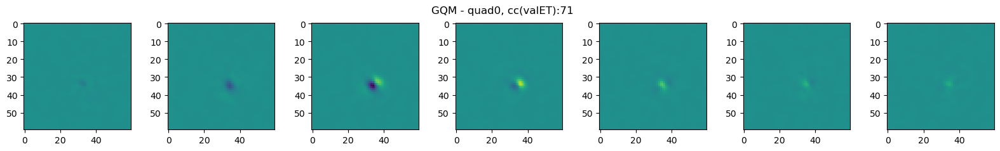

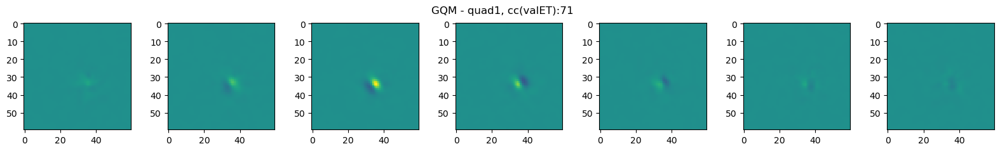

complexity 0.399 motion 0.263 x -0.253 y 0.263
-------------


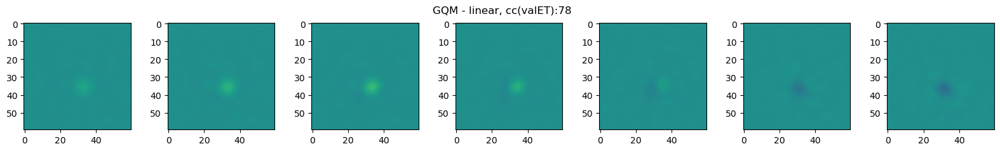

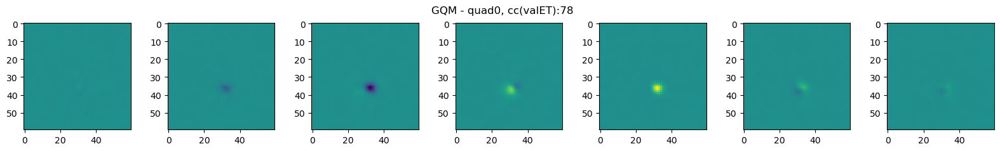

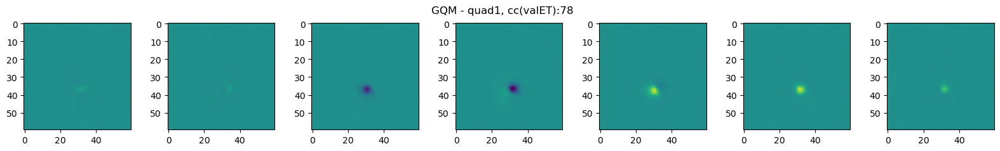

complexity 0.449 motion 0.286 x 0.286 y 0.079
-------------


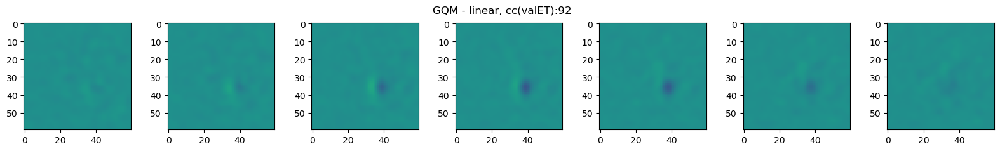

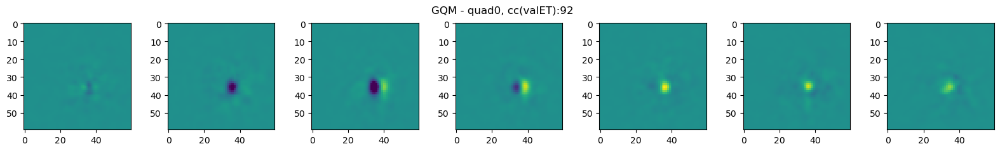

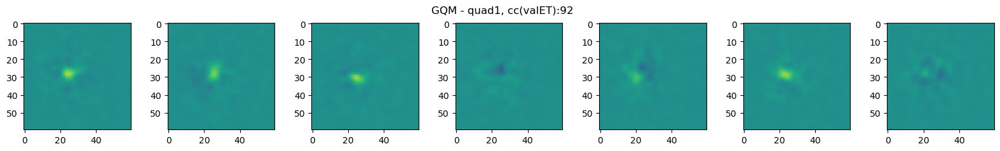

complexity nan motion 0.461 x 0.461 y 0.274
-------------


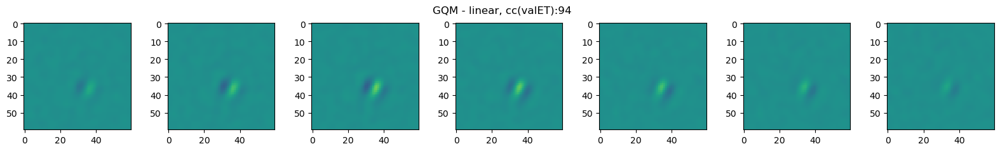

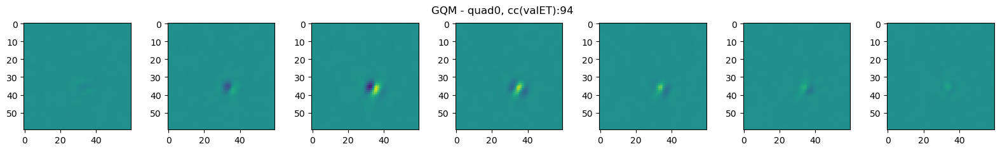

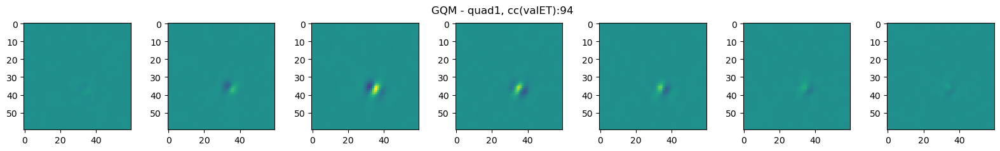

complexity 0.5 motion 0.264 x -0.076 y 0.264
-------------


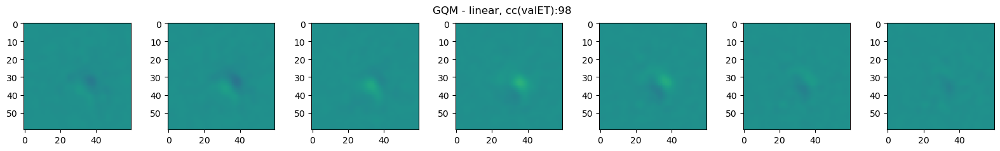

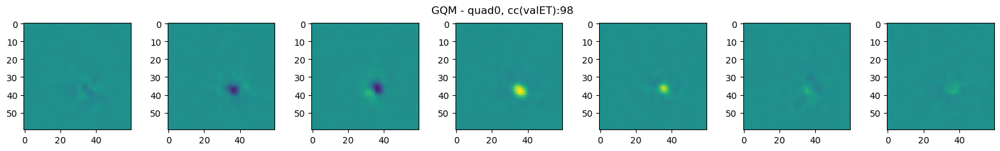

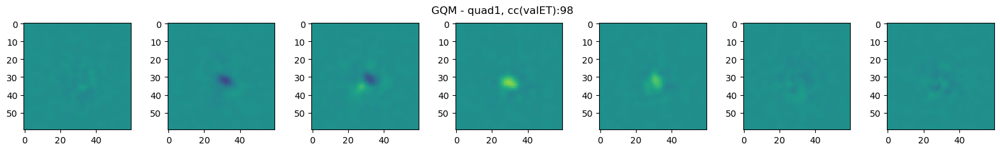

complexity 0.507 motion 0.284 x 0.284 y 0.138
-------------


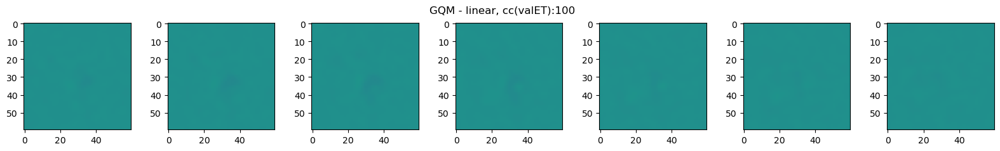

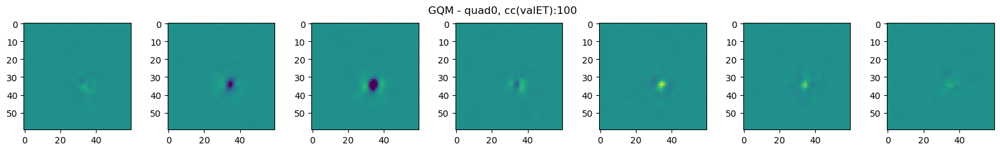

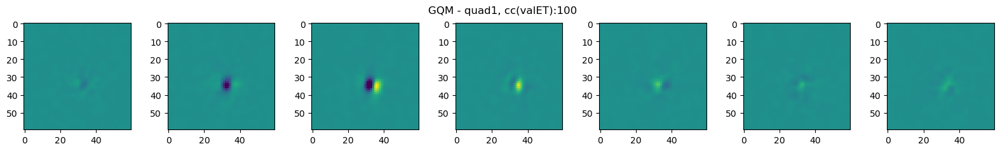

complexity nan motion 0.2 x 0.2 y 0.063
-------------


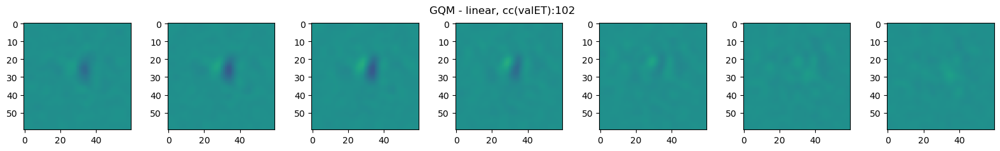

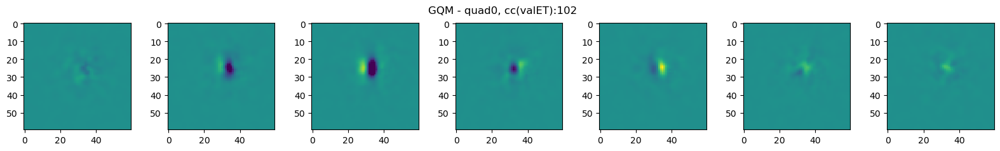

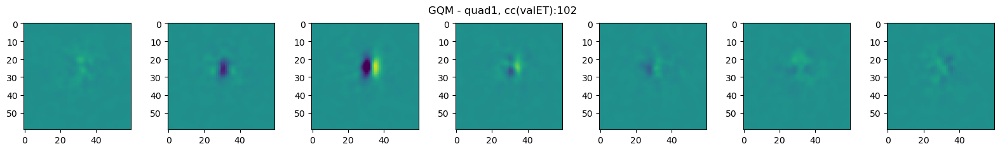

complexity 0.5 motion 0.228 x 0.228 y 0.065
-------------


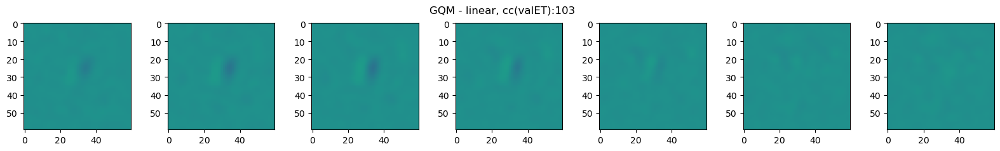

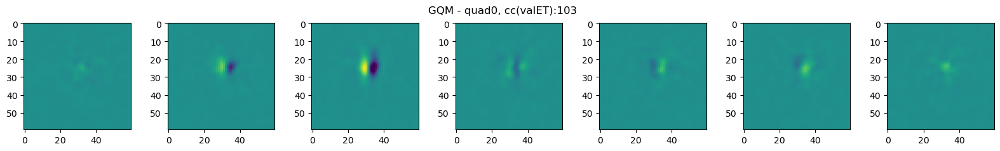

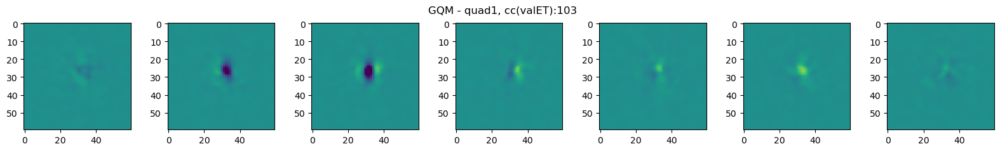

complexity 1.0 motion 0.203 x 0.079 y 0.203
-------------


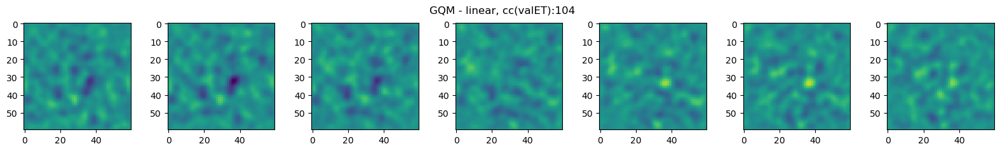

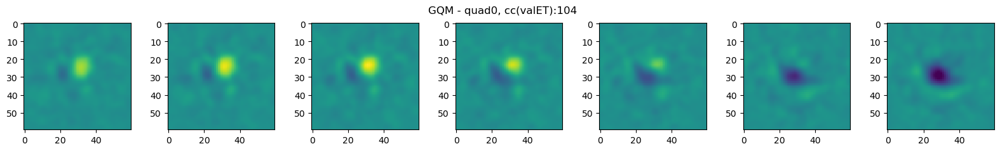

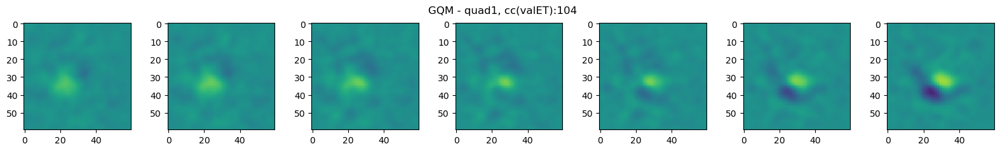

complexity 1.0 motion 0.203 x 0.052 y 0.203
-------------


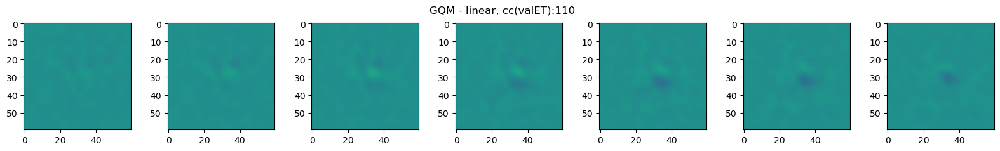

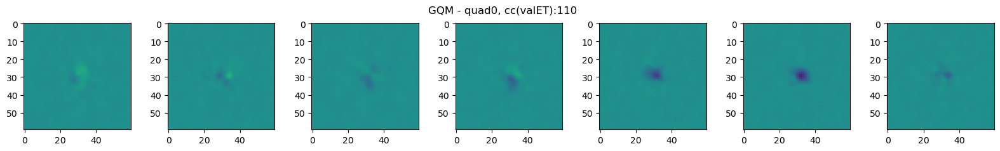

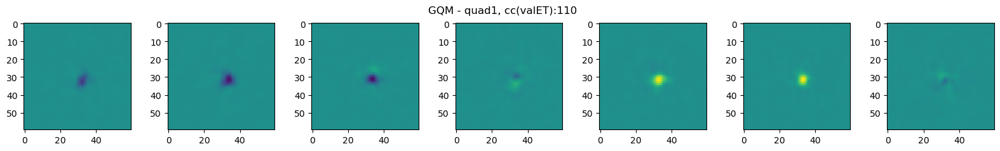

complexity 0.0 motion 0.313 x 0.313 y -0.027
-------------


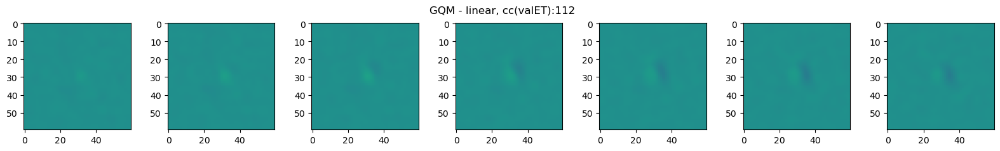

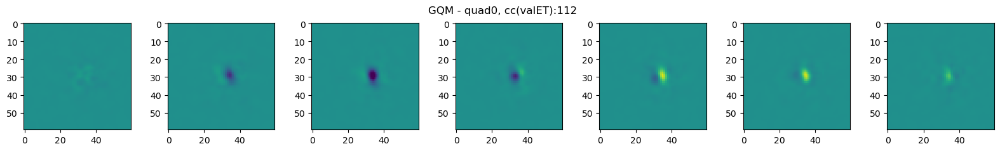

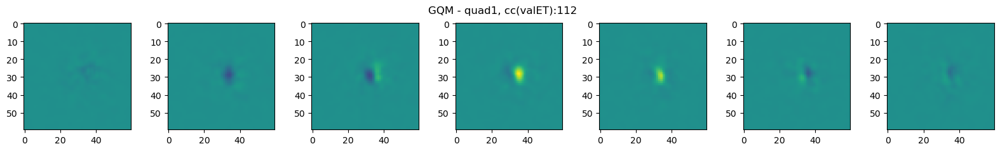

complexity 0.56 motion 0.225 x 0.225 y 0.179
-------------


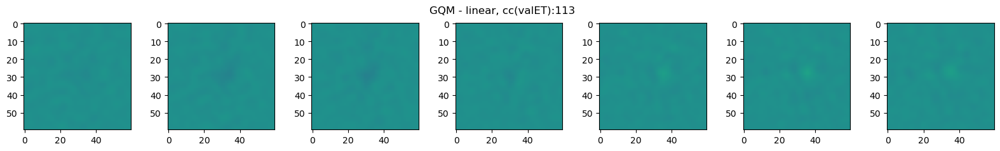

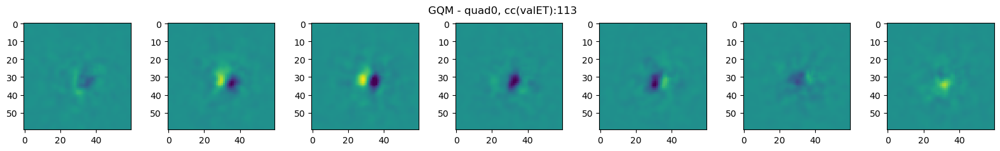

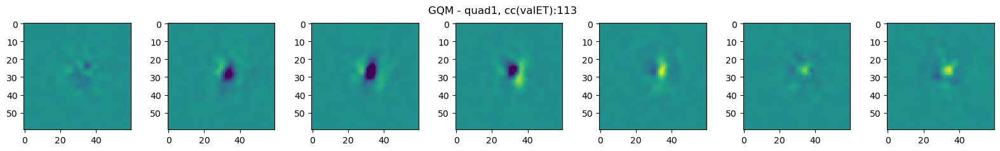

complexity nan motion 0.341 x 0.341 y -0.316
-------------


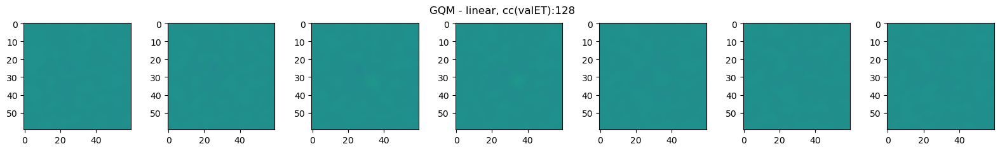

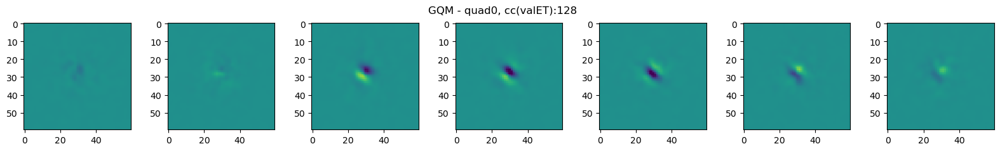

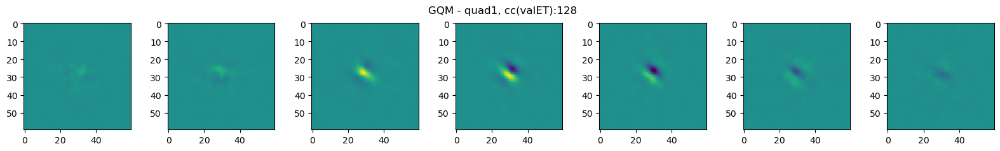

complexity nan motion 0.279 x 0.279 y -0.118
-------------


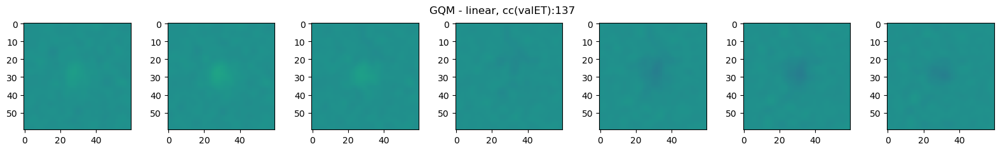

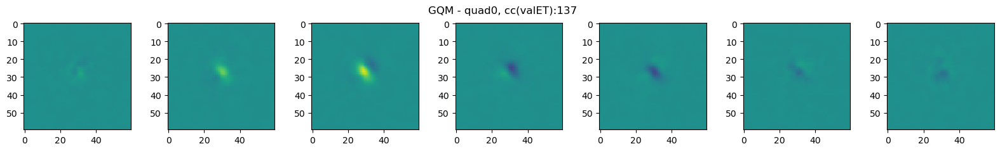

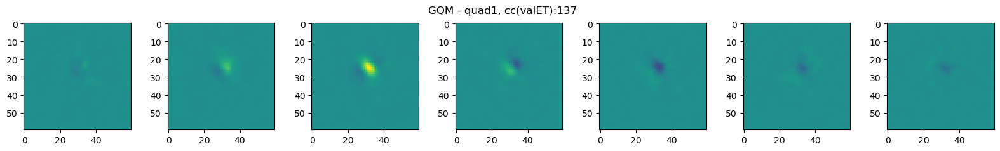

complexity 1.0 motion 0.226 x 0.226 y -0.038
-------------


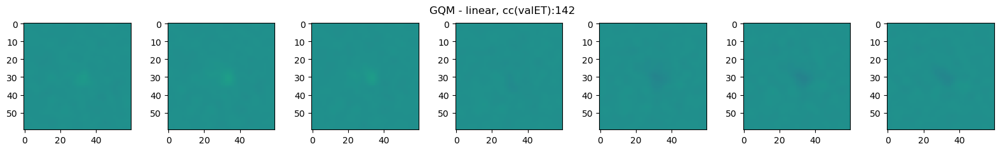

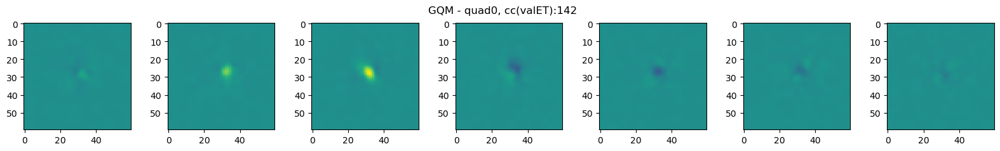

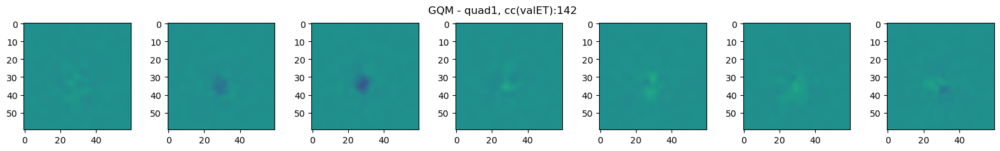

complexity 0.482 motion 0.268 x 0.109 y 0.268
-------------


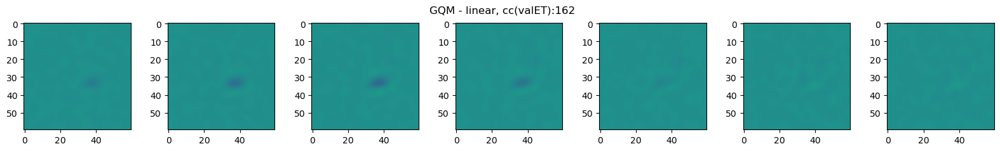

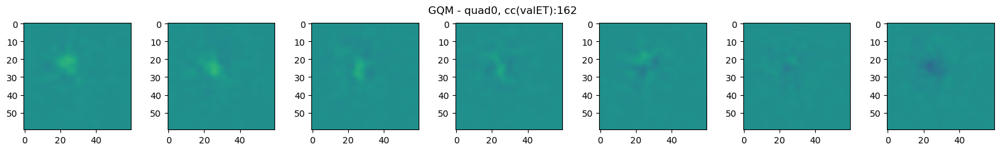

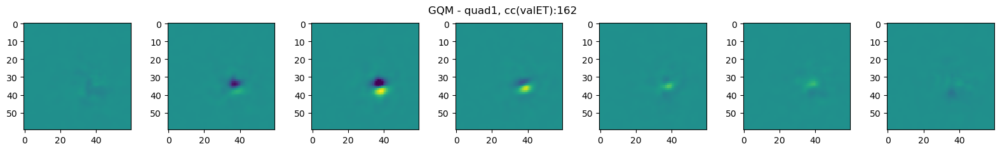

In [192]:
num_lags = 12
for i in range(len(gqms)):
    complexity = complexity_values[i][0]
    motion_x = motion_values[i][0]
    motion_y = motion_values[i][1]
    motion = np.max([np.abs(motion_x), np.abs(motion_y)])
    #if complexity > 0.5:
    #    continue
    if motion > 0.05 and motion < 0.2:
        continue
    print('complexity', np.round(complexity, 3), 'motion', np.round(motion, 3), 'x', np.round(motion_x, 3), 'y', np.round(motion_y, 3))
    
    max_weights = 0
    weights_lin = np.max(gqms[i].networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    print('-------------')
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        #plt.suptitle('GQM - linear, cc(valET):' + str(i) + ' LL: ' + str(gqms[i].LLs))
        plt.suptitle('GQM - linear, cc(valET):' + str(i))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc(valET):' + str(i))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc(valET):' + str(i))
        col += 1
    plt.show()

## complexity score histogram

In [181]:
import tqdm

complexity_values = []
motion_values = []
for i in tqdm.tqdm(range(len(gqms))):
    complexity_values.append(RFutils.GQM_complexity(gqms[i], data, i, 0, 2))
    motion_values.append(RFutils.GQM_motion(gqms[i], 0, 2))

  2%|█▌                                                                                       | 3/174 [00:04<04:23,  1.54s/it]/home/mattjac/projects/mattjac/v1/ColorDataUtils/RFutils.py:186: RuntimeWarning: invalid value encountered in scalar divide
  complex_score = rect_quad_corr / sum([rect_lin_corr, rect_quad_corr])
100%|███████████████████████████████████████████████████████████████████████████████████████| 174/174 [04:26<00:00,  1.53s/it]


In [182]:
# save out complexity scores
with open('models/dan_gqms/complexity_values.pkl', 'wb') as f:
    pickle.dump(complexity_values, f)

with open('models/dan_gqms/complexity_values.pkl', 'rb') as f:
    complexity_values = pickle.load(f)
    
# save out motion scores
with open('models/dan_gqms/motion_values.pkl', 'wb') as f:
    pickle.dump(motion_values, f)
    
with open('models/dan_gqms/motion_values.pkl', 'rb') as f:
    motion_values = pickle.load(f)

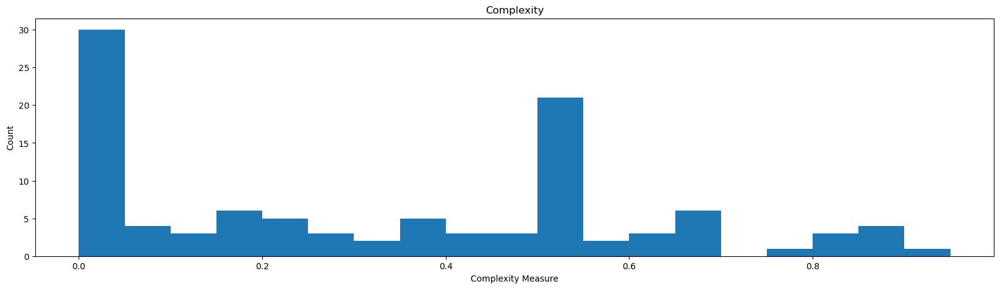

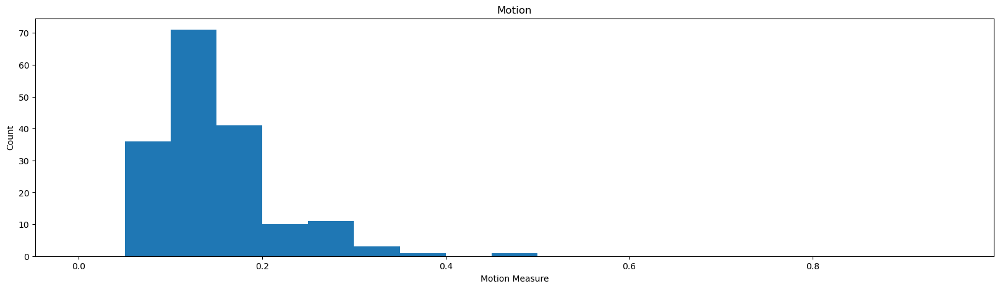

In [191]:
vals_complex = np.array([val[0] for val in complexity_values])
fig = plt.figure(figsize=(20,5))
plt.hist(vals_complex, bins=np.arange(0, 1, 0.05))
plt.xlabel('Complexity Measure')
plt.ylabel('Count')
plt.title('Complexity')
plt.show()

vals_motion = np.array([np.max([np.abs(val[0]), np.abs(val[1])]) for val in motion_values])
fig = plt.figure(figsize=(20,5))
plt.hist(vals_motion, bins=np.arange(0, 1, 0.05))
plt.xlabel('Motion Measure')
plt.ylabel('Count')
plt.title('Motion')
plt.show()

## fit GQMs

In [278]:
def fit_gqm(i, cc, folder):
    gqm_model_filename = 'models/'+folder+'/gqm_model_cc'+str(cc)+'.pkl'
    gqm_study_filename = 'models/'+folder+'/gqm_study_cc'+str(cc)+'.pkl'
    
    drift_weights = drifts[i].ndn_model.networks[0].layers[0].weight.data[:,0]
    
    # continue if the file already exists
    if os.path.isfile(gqm_model_filename):
        # load the model and continue
        print('loading model', cc)
        with open(gqm_model_filename, 'rb') as f:
            gqm = pickle.load(f)
        with open(gqm_study_filename, 'rb') as f:
            study = pickle.load(f)
        return gqm, study

    #data.set_cells(valET[cc])
    data.set_cells(cc)
    
    LLsNULL = drifts[i].LLs
    
    # get the best reg_vals for the GLM
    best_reg_vals = glms[i].ndn_model.networks[0].layers[0].reg.vals

    lbfgs_pars = utils.create_optimizer_params(
        optimizer_type='lbfgs',
        tolerance_change=1e-8,
        tolerance_grad=1e-8,
        history_size=100,
        batch_size=20,
        max_epochs=3,
        max_iter = 500,
        device = device)

    # optimize the d2x, d2t, d2xt, and glocalx first
    gqms_temp = []
    def objective(trial):
        # get the best reg_vals for the GLM
        stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)
        gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
        gqm.networks[0].layers[0] = deepcopy(glms[i].ndn_model.networks[0].layers[0])
        gqm.block_sample=True
        gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
        gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
        gqm.networks[1].layers[0].set_parameters(val=False)

        # adjust the linear part a little
        gqm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('lin_d2x',
                                                                        best_reg_vals['d2x']-0.1*best_reg_vals['d2x'],
                                                                        best_reg_vals['d2x']+0.1*best_reg_vals['d2x'])
        gqm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('lin_d2t',
                                                                        best_reg_vals['d2t']-0.1*best_reg_vals['d2t'],
                                                                        best_reg_vals['d2t']+0.1*best_reg_vals['d2t'])
        gqm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('lin_d2xt',
                                                                         best_reg_vals['d2xt']-0.1*best_reg_vals['d2xt'],
                                                                         best_reg_vals['d2xt']+0.1*best_reg_vals['d2xt'])
        gqm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('lin_glocalx',
                                                                            best_reg_vals['glocalx']-0.1*best_reg_vals['glocalx'],
                                                                            best_reg_vals['glocalx']+0.1*best_reg_vals['glocalx'])

        # adjust the quadratic part more
        gqm.networks[2].layers[0].reg.vals['d2x'] = trial.suggest_float('quad_d2x', 10, 30)
        gqm.networks[2].layers[0].reg.vals['d2t'] = trial.suggest_float('quad_d2t', 0.5, 2)
        gqm.networks[2].layers[0].reg.vals['d2xt'] = trial.suggest_float('quad_d2xt', 0.001, 10000)
        gqm.networks[2].layers[0].reg.vals['glocalx'] = trial.suggest_float('quad_glocalx', 0.01, 1)

        gqm.fit(data, force_dict_training=True, trial=trial, **lbfgs_pars)
        LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]

        null_adjusted_LL = LLsNULL - LL

        gqm_model = Model(gqm, null_adjusted_LL, trial)
        gqms_temp.append(gqm_model)

        return null_adjusted_LL


    study = optuna.create_study(direction='maximize')
    
    # add initial trials
    #rvals = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
    #rvalsG = [0.001, 0.1, 1, 10, 100, 1000] # glocal
    trial_template = {'lin_d2x': best_reg_vals['d2x'],
                      'lin_d2t': best_reg_vals['d2t'],
                      'lin_d2xt': best_reg_vals['d2xt'],
                      'lin_glocalx': best_reg_vals['glocalx'],
                      'quad_d2x': 10,
                      'quad_d2t': 0.5,
                      'quad_glocalx': 0.01}
    study.enqueue_trial(trial_template | {'quad_d2xt': 0.001})
    study.enqueue_trial(trial_template | {'quad_d2xt': 0.01})
    study.enqueue_trial(trial_template | {'quad_d2xt': 0.1})
    study.enqueue_trial(trial_template | {'quad_d2xt': 1})
    study.enqueue_trial(trial_template | {'quad_d2xt': 10})
    study.enqueue_trial(trial_template | {'quad_d2xt': 100})
    study.enqueue_trial(trial_template | {'quad_d2xt': 1000})
    study.enqueue_trial(trial_template | {'quad_d2xt': 10000})

    
    study.optimize(objective, n_trials=15)
    best_model = gqms_temp[study.best_trial.number]
    best_params = study.best_params

    # optimize the l1 last
    gqms_temp = []
    def objective(trial):
        if trial.number == 0:
            gqm = best_model.ndn_model
        else:
            # get the best reg_vals for the GLM
            stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)
            gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
            gqm.networks[0].layers[0] = deepcopy(glms[i].ndn_model.networks[0].layers[0])
            gqm.block_sample=True
            gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
            gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
            gqm.networks[1].layers[0].set_parameters(val=False)

        # adjust the linear part a little
        gqm.networks[0].layers[0].reg.vals['d2x'] = trial.suggest_float('lin_d2x',
                                                                        best_params['lin_d2x']-0.1*best_params['lin_d2x'],
                                                                        best_params['lin_d2x']+0.1*best_params['lin_d2x'])
        gqm.networks[0].layers[0].reg.vals['d2t'] = trial.suggest_float('lin_d2t',
                                                                        best_params['lin_d2t']-0.1*best_params['lin_d2t'],
                                                                        best_params['lin_d2t']+0.1*best_params['lin_d2t'])
        gqm.networks[0].layers[0].reg.vals['d2xt'] = trial.suggest_float('lin_d2xt',
                                                                         best_params['lin_d2xt']-0.1*best_params['lin_d2xt'],
                                                                         best_params['lin_d2xt']+0.1*best_params['lin_d2xt'])
        gqm.networks[0].layers[0].reg.vals['glocalx'] = trial.suggest_float('lin_glocalx',
                                                                             best_params['lin_glocalx']-0.1*best_params['lin_glocalx'],
                                                                             best_params['lin_glocalx']+0.1*best_params['lin_glocalx'])
        gqm.networks[0].layers[0].reg.vals['l1'] = trial.suggest_float('lin_l1',
                                                                       best_reg_vals['l1']-0.1*best_reg_vals['l1'],
                                                                       best_reg_vals['l1']+0.1*best_reg_vals['l1'])

        # adjust the quadratic part more
        gqm.networks[2].layers[0].reg.vals['d2x'] = trial.suggest_float('quad_d2x',
                                                                        best_params['quad_d2x']-0.1*best_params['quad_d2x'],
                                                                        best_params['quad_d2x']+0.1*best_params['quad_d2x'])
        gqm.networks[2].layers[0].reg.vals['d2t'] = trial.suggest_float('quad_d2t',
                                                                        best_params['quad_d2t']-0.1*best_params['quad_d2t'],
                                                                        best_params['quad_d2t']+0.1*best_params['quad_d2t'])
        gqm.networks[2].layers[0].reg.vals['d2xt'] = trial.suggest_float('quad_d2xt',
                                                                         best_params['quad_d2xt']-0.1*best_params['quad_d2xt'],
                                                                         best_params['quad_d2xt']+0.1*best_params['quad_d2xt'])
        gqm.networks[2].layers[0].reg.vals['glocalx'] = trial.suggest_float('quad_glocalx',
                                                                            best_params['quad_glocalx']-0.1*best_params['quad_glocalx'],
                                                                            best_params['quad_glocalx']+0.1*best_params['quad_glocalx'])
        gqm.networks[2].layers[0].reg.vals['l1'] = trial.suggest_float('quad_l1', 0.001, 1)
        

        gqm.fit(data, force_dict_training=True, trial=trial, **lbfgs_pars)
        LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]

        null_adjusted_LL = LLsNULL - LL

        gqm_model = Model(gqm, null_adjusted_LL, trial)
        gqms_temp.append(gqm_model)

        return null_adjusted_LL

    
    study = optuna.create_study(direction='maximize')

    #rvalsL = [0.001, 0.01, 0.1, 1] # L1
    trial_template = {'lin_d2x': best_params['lin_d2x'],
                      'lin_d2t': best_params['lin_d2t'],
                      'lin_glocalx': best_params['lin_glocalx'],
                      'lin_l1': best_reg_vals['l1'],
                      'quad_d2x': 20,
                      'quad_d2t': 1,
                      'quad_d2xt': 1,
                      'quad_glocalx': 10.0}
    study.enqueue_trial(trial_template | {'l1': 0.001})
    study.enqueue_trial(trial_template | {'l1': 0.01})
    study.enqueue_trial(trial_template | {'l1': 0.1})
    study.enqueue_trial(trial_template | {'l1': 1})
    study.enqueue_trial(trial_template | {'l1': 10})
    
    study.optimize(objective, n_trials=10)

    best_model = gqms_temp[study.best_trial.number]
    
    with open(gqm_model_filename, 'wb') as f:
        pickle.dump(best_model, f)
    
    with open(gqm_study_filename, 'wb') as f:
        pickle.dump(study, f)
    
    print(study.best_trial.number, study.best_params)
    return best_model, study

In [279]:
gqms = []
gqm_studies = []
for i, cc in enumerate(interesting_cells):
    gqm, study = fit_gqm(i, cc, 'glms_04')
    gqms.append(gqm)
    gqm_studies.append(study)

loading model 15


## plot GQMs

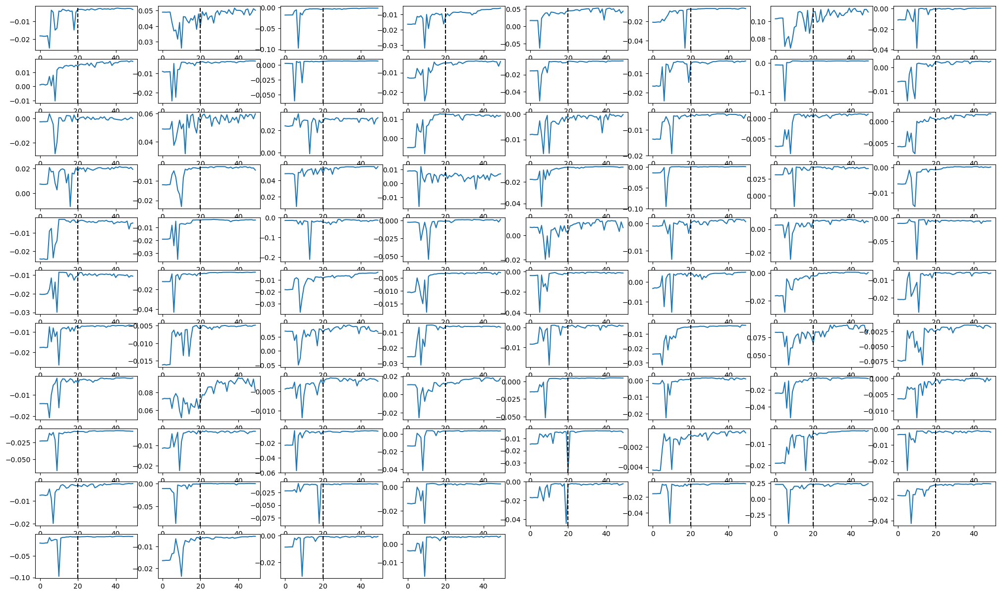

In [12]:
# plot GQM study
fig = plt.figure(figsize=(25, 15))
grid = plt.GridSpec(11, 8, hspace=0.2, wspace=0.2)
for i in range(84):
    row,col = np.unravel_index(i, (11,8))
    ax = fig.add_subplot(grid[row,col])
    ax.plot(gqm_studies[i].trials_dataframe()['value'])
    # draw vertical line
    ax.axvline(x=20, color='k', linestyle='--')

-------------


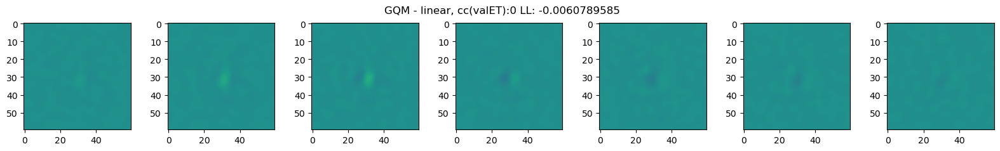

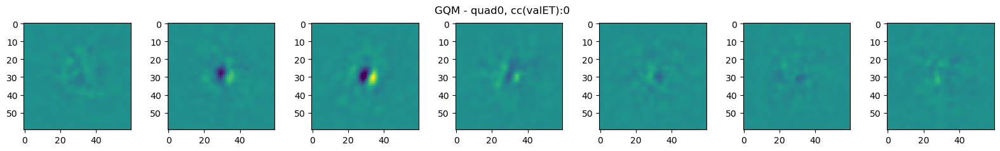

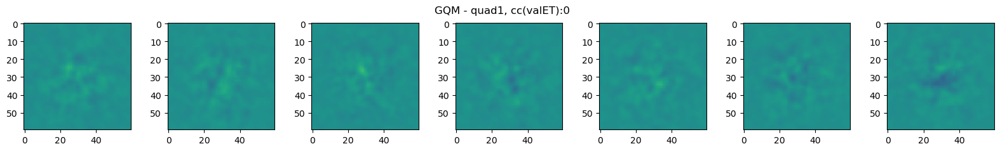

In [280]:
for i in range(len(gqms)):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn_model.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn_model.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad
        
    print('-------------')
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn_model.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - linear, cc(valET):' + str(i) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('GQM - quad0, cc(valET):' + str(i))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn_model.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('GQM - quad1, cc(valET):' + str(i))
        col += 1
    plt.show()

# CNNs

## load models

In [28]:
cnns = []
for i in range(0,14):
    with open('models/cnns_04/cnn_'+str(i)+'.pkl', 'rb') as f:
        cnns.append(pickle.load(f))

with open('models/cnns_04/study.pkl', 'rb') as f:
    study = pickle.load(f)

In [29]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_LGN_NLtype,params_LGN_num_filters,params_iter_filter_width,params_learning_rate,params_num_inh,params_num_iter,params_num_subs,params_proj_filter_width,params_weight_decay,system_attrs_fixed_params,state
0,0,0.026786,2023-07-13 19:22:51.129029,2023-07-13 19:47:08.365235,0 days 00:24:17.236206,lin,4,7,0.010000,0.500000,3,30,17,0.200000,"{'LGN_num_filters': 4, 'LGN_NLtype': 'lin', 'l...",COMPLETE
1,1,0.017043,2023-07-13 19:47:08.365604,2023-07-13 20:09:16.945503,0 days 00:22:08.579899,relu,4,7,0.010000,0.500000,3,30,17,0.200000,"{'LGN_num_filters': 4, 'LGN_NLtype': 'relu', '...",COMPLETE
2,2,0.029701,2023-07-13 20:09:16.945868,2023-07-13 21:01:37.344498,0 days 00:52:20.398630,lin,4,7,0.010000,0.500000,4,30,17,0.200000,"{'LGN_num_filters': 4, 'LGN_NLtype': 'lin', 'l...",COMPLETE
3,3,0.021871,2023-07-13 21:01:37.344861,2023-07-13 21:46:06.302097,0 days 00:44:28.957236,relu,4,7,0.010000,0.500000,4,30,17,0.200000,"{'LGN_num_filters': 4, 'LGN_NLtype': 'relu', '...",COMPLETE
4,4,0.005268,2023-07-13 21:46:06.302456,2023-07-13 22:08:04.678411,0 days 00:21:58.375955,lin,6,11,0.051131,0.273867,3,12,9,0.990007,NaN,COMPLETE
5,5,0.008785,2023-07-13 22:08:04.678760,2023-07-13 22:49:48.971444,0 days 00:41:44.292684,lin,5,9,0.063873,0.552769,3,48,15,0.515897,NaN,COMPLETE
6,6,0.011072,2023-07-13 22:49:48.971805,2023-07-14 00:59:54.391092,0 days 02:10:05.419287,lin,7,13,0.045658,0.648320,6,50,11,0.481092,NaN,COMPLETE
7,7,-0.002040,2023-07-14 00:59:54.391472,2023-07-14 01:08:43.711549,0 days 00:08:49.320077,relu,5,9,0.092664,0.690850,1,27,17,0.407649,NaN,COMPLETE
8,8,0.014368,2023-07-14 01:08:43.711886,2023-07-14 02:46:44.714834,0 days 01:38:01.002948,lin,8,15,0.008383,0.385018,2,38,13,0.669168,NaN,COMPLETE
9,9,0.016493,2023-07-14 02:46:44.715178,2023-07-14 03:16:03.585446,0 days 00:29:18.870268,lin,4,17,0.014899,0.440656,2,16,23,0.529099,NaN,COMPLETE


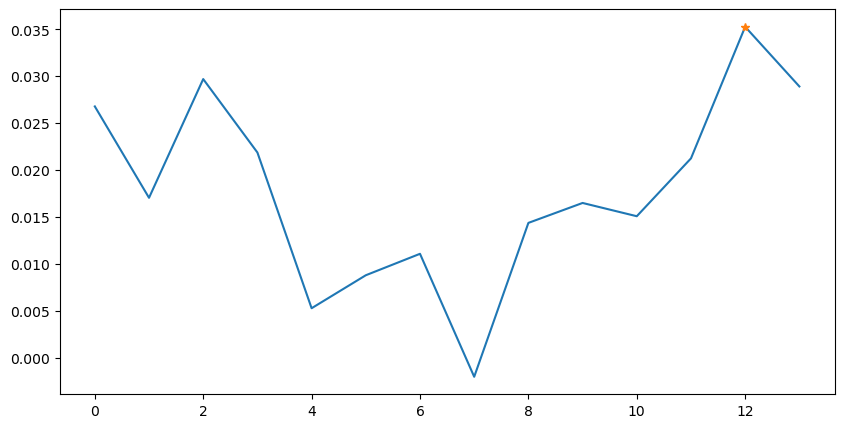

12


In [30]:
# plot LLs
fig = plt.figure(figsize=(10, 5))
plt.plot([np.mean(cnn.LLs) for cnn in cnns])
# put an asterisk on the best model
plt.plot(study.best_trial.number, np.mean(cnns[study.best_trial.number].LLs), '*')
plt.show()

best_cnn = cnns[study.best_trial.number].ndn_model
best_LLs = cnns[study.best_trial.number].LLs
best_trial = study.best_trial
print(study.best_trial.number)

(7, 7, 11, 4)


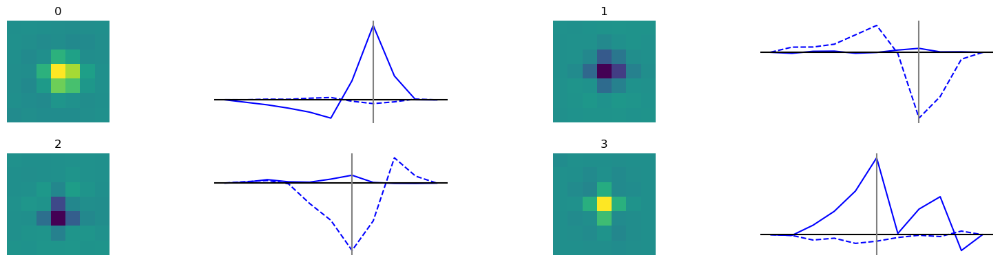

In [33]:
# get the weights for the LGN layer of cnn 2
with open('models/cnns_04/cnn_12.pkl', 'rb') as f:
    best = pickle.load(f)
    best_cnn = best.ndn_model
    best_trial = best.trial
print(best_cnn.networks[0].layers[0].get_weights().shape)
best_cnn.plot_filters()

0 0.035547442134769486


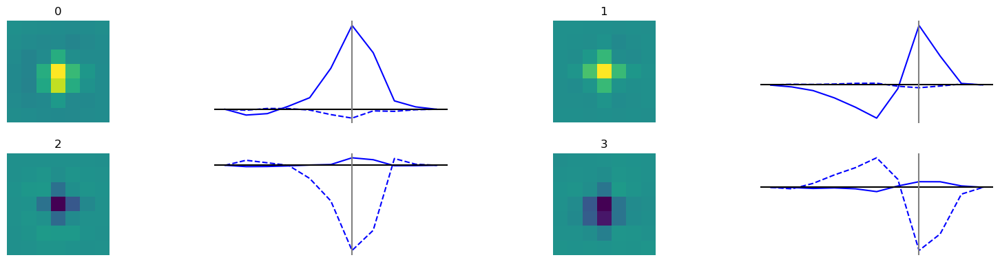

1 0.033662730249865304


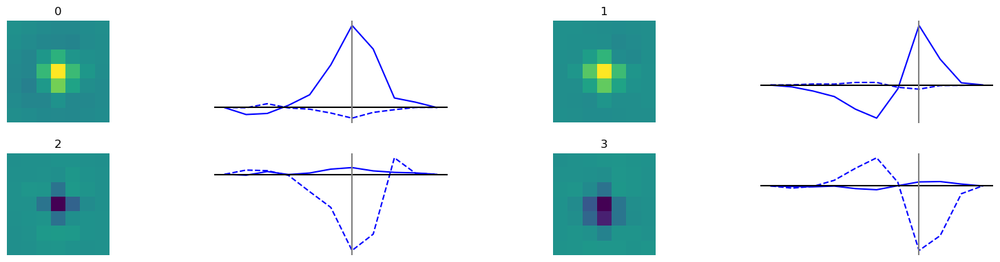

2 0.03171329251651106


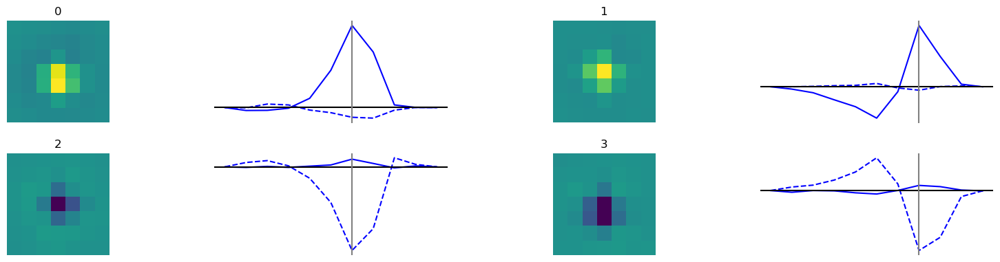

3 0.03238400234573189


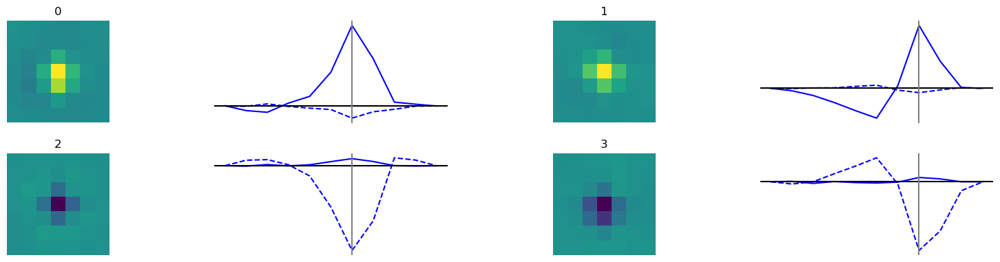

4 0.034402937039561654


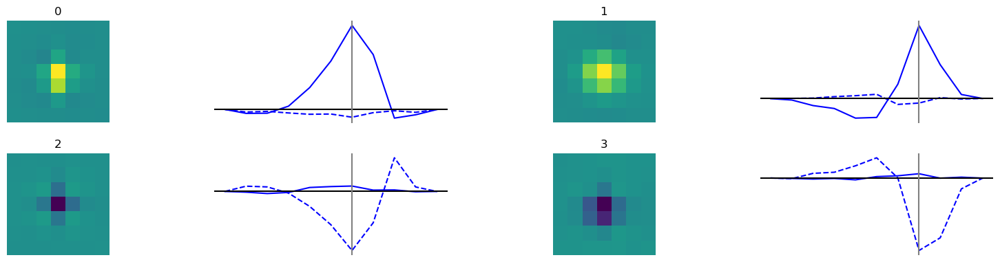

5 0.031151134392310834


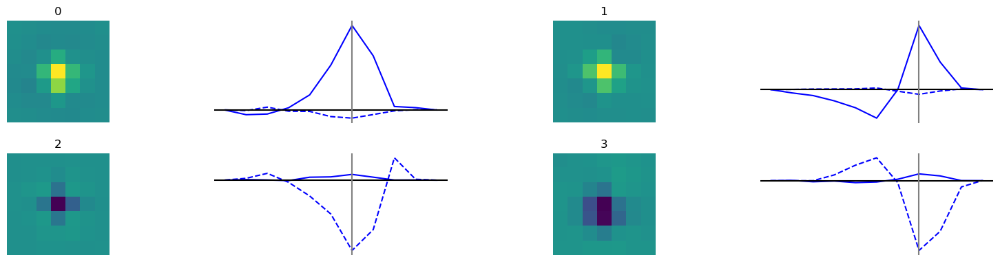

6 0.031276809073042595


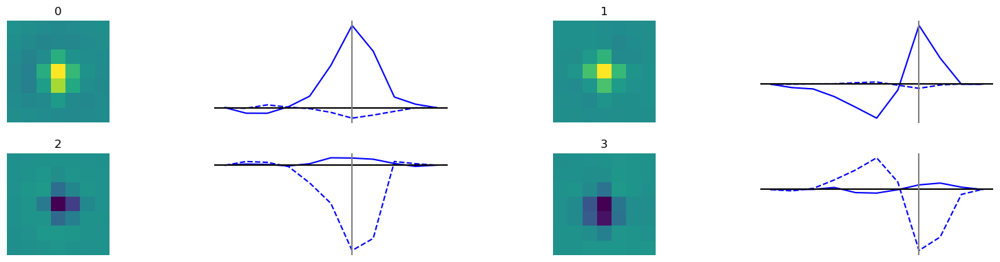

7 0.03403384315556493


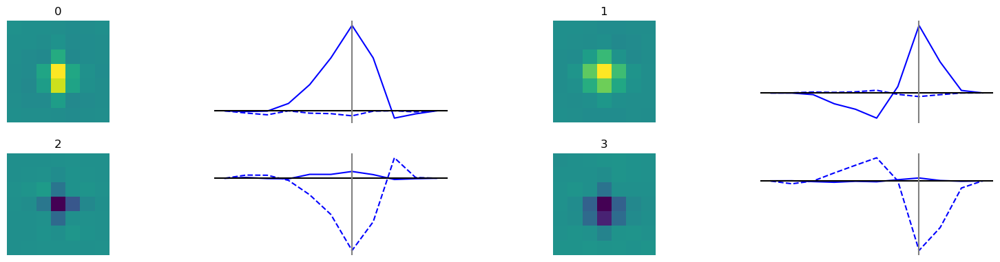

8 0.03286904028092308


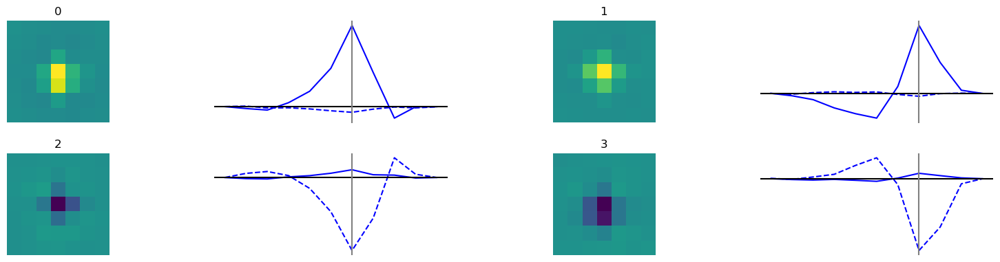

9 0.03201650751048121


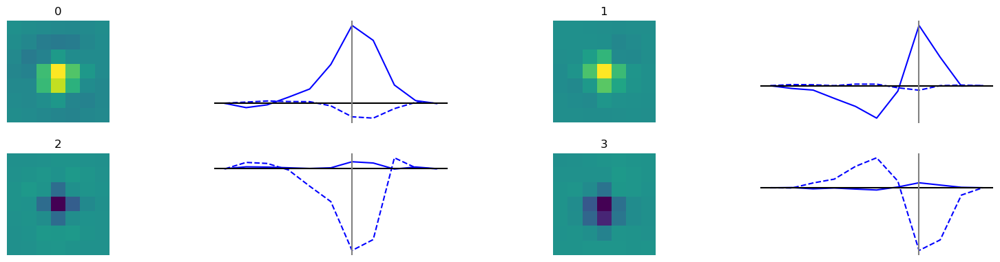

10 0.02819718506144381


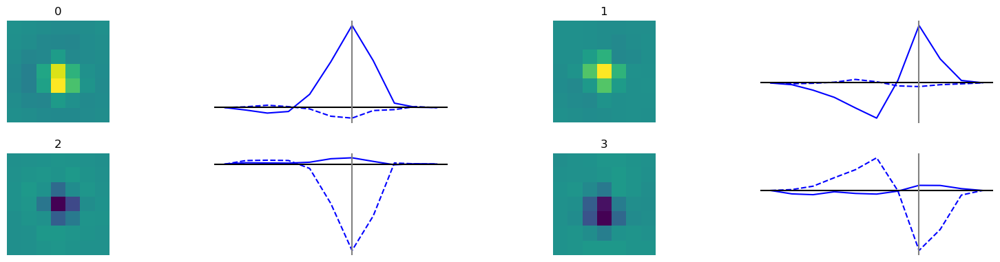

11 0.029405585650739998


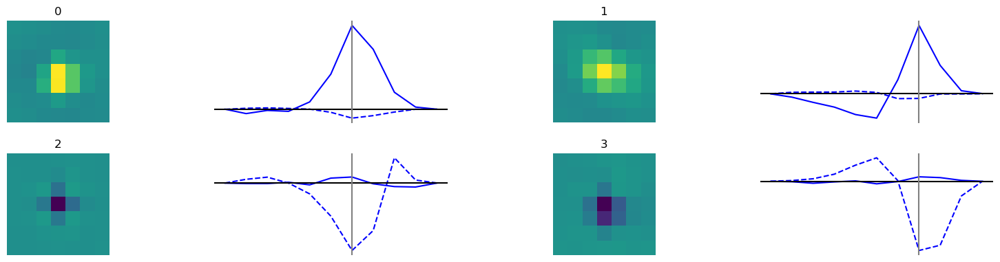

12 0.035026542756749296


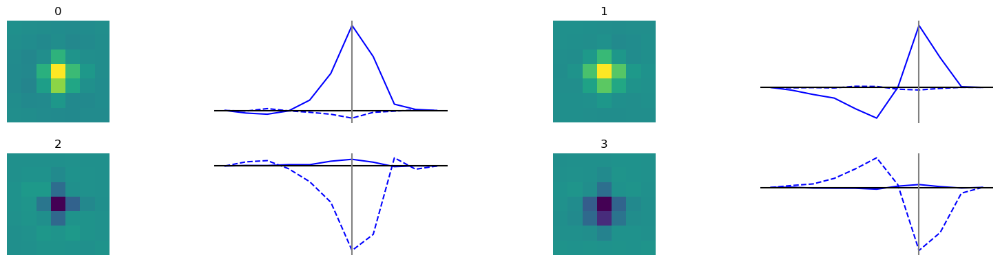

13 0.035734754184196735


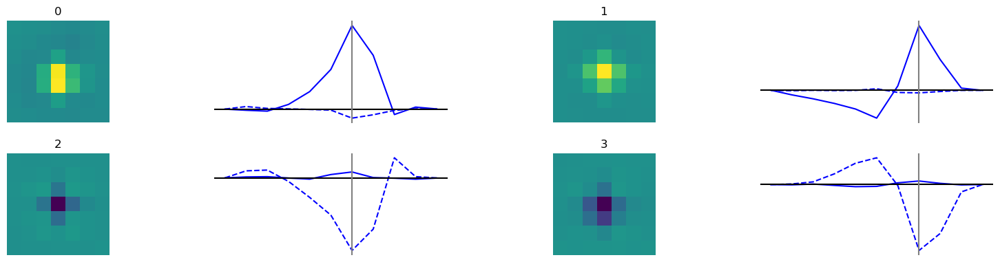

14 0.03416602775968354


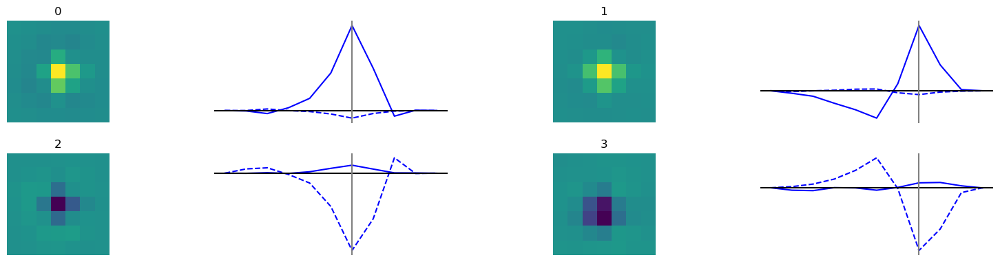

15 0.03524327826225895


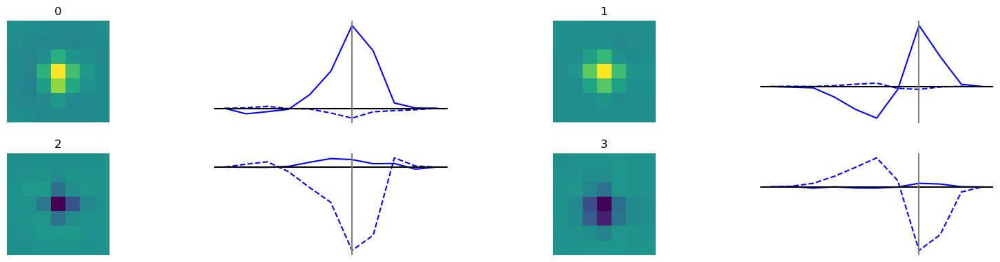

16 0.03321594821995702


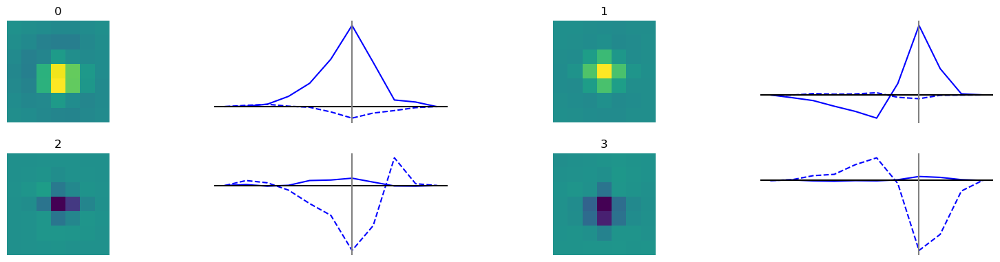

17 0.035510070022495316


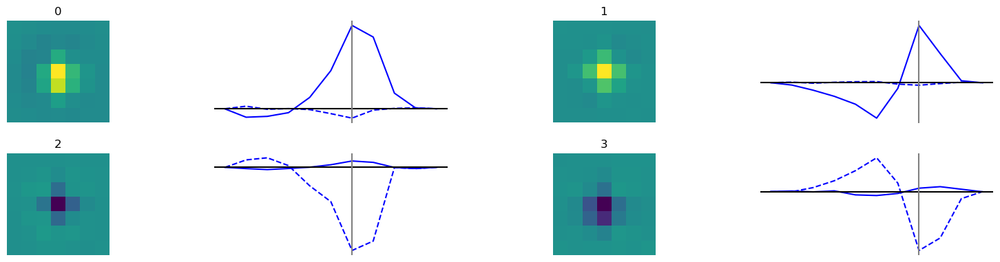

18 0.033668370082460604


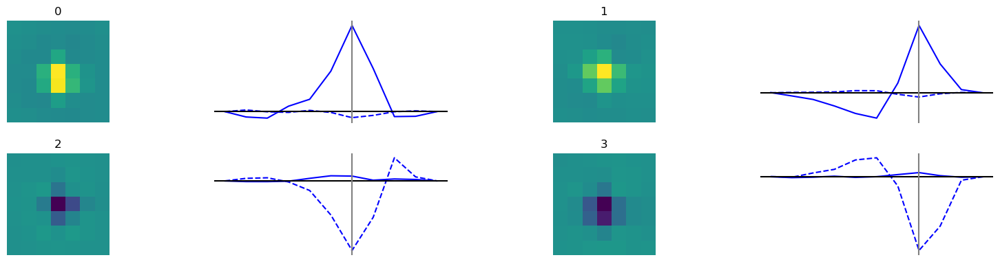

19 0.03519573225372139


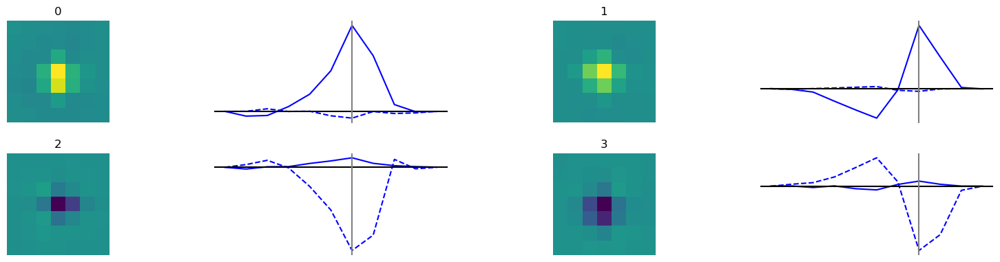

In [20]:
for i, cnn in enumerate(cnns):
    lls = np.mean(cnn.LLs)
    if lls > 0.025:
        print(i, np.mean(cnn.LLs))
        cnn.ndn_model.plot_filters()
        plt.show()

## best parameters

In [31]:
trials = study.trials

# sort trials by values[0]
fig = plt.figure(figsize=(25, 10))
trials = sorted(trials, key=lambda x: x.values[0] if x.values is not None else -100)

<Figure size 2500x1000 with 0 Axes>

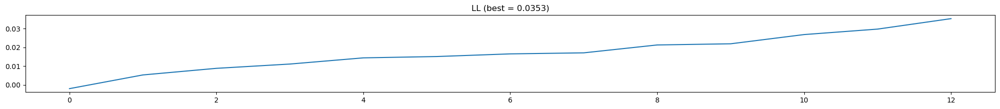

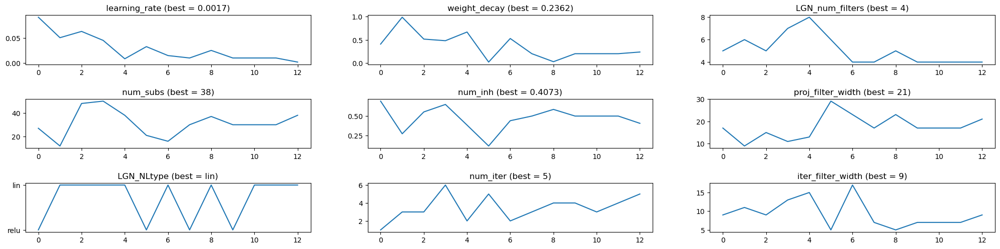

In [32]:
fig = plt.figure(figsize=(25, 2))
plt.plot([trial.values[0] for trial in trials if trial.values is not None])
plt.title('LL (best = ' + '%.4f' % trials[-1].values[0] + ')')
plt.show()

fig = plt.figure(figsize=(25, 10))
grid = matplotlib.gridspec.GridSpec(5, 3, hspace=0.7, wspace=0.2)
for i, k in enumerate(trials[-1].params.keys()):
    row,col = np.unravel_index(i, (5,3))
    plt.subplot(grid[row,col])
    plt.plot([trial.params[k] for trial in trials if trial.values is not None])
    # if number is a float
    if isinstance(trials[-1].params[k], float):
        plt.title(k + ' (best = ' + '%.4f' % trials[-1].params[k] + ')')
    else:
        plt.title(k + ' (best = ' + str(trials[-1].params[k]) + ')')

## predict from the CNN

In [60]:
pred = best_cnn.generate_predictions(data, batch_size=10)

Eval models: 100%|██████████████████████████████████████████████████████████████████████████████████████████| 70/70 [05:50<00:00,  5.00s/it]


In [210]:
data[0]['stim'].shape, len(data.block_inds)

(torch.Size([240, 3600]), 698)

## generate_predictions()

In [223]:
data[690:700]

IndexError: list index out of range

In [66]:
import tqdm
num_cells = 174 # data.NC
block_size = len(data.block_inds[0])
batch_size = 10 # in blocks
total = len(data.block_inds) # in blocks
assert total <= len(data.block_inds), 'total is larger than '+str(len(data.block_inds))
pred = torch.zeros((total*block_size, num_cells))
with torch.no_grad():
    for i in tqdm.tqdm(range(0, total, batch_size)):
        if i+batch_size > total:
            pred[i*block_size:] = best_cnn(data[i:])
        else:
            pred[i*block_size:(i+batch_size)*block_size] = best_cnn(data[i:i+batch_size])

  4%|████                                                                                          | 3/70 [00:59<22:00, 19.71s/it]


KeyboardInterrupt: 

In [13]:
# save the predictions
# with open('models/cnns_04/pred.pkl', 'wb') as f:
#     pickle.dump(pred, f)

# load the predictions
with open('models/cnns_04/pred.pkl', 'rb') as f:
    pred = pickle.load(f)

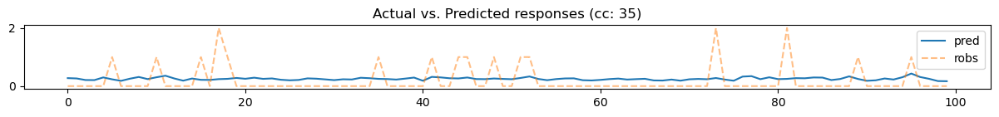

In [68]:
# plot preds vs. robs for each cell
for cc in interesting_cells:
    plt.figure(figsize=(15,1))
    plt.plot(pred[10000:10100, cc], label='pred')
    plt.plot(data.robs[10000:10100, valET[cc]], label='robs', linestyle='--', alpha=0.5)
    plt.title('Actual vs. Predicted responses (cc: ' + str(valET[cc]) + ')')
    plt.legend()
    plt.show()

In [217]:
def r_squared(pred, robs):
    return 1 - torch.sum((pred - robs)**2) / torch.sum((robs -torch.mean(robs))**2)

# calculate r2 for each cell
r2s = []
for cc in interesting_cells:
    r2 = r_squared(pred[:, cc], data.robs[:, valET[cc]])
    r2s.append(r2)
    
# plot r2s
plt.figure(figsize=(5,10))
plt.plot(r2s)
plt.title('r2s')
plt.xlabel('cell')
plt.ylabel('r2')
plt.show()

RuntimeError: The size of tensor a (120000) must match the size of tensor b (167520) at non-singleton dimension 0

In [108]:
pred.shape, data.robs.shape, data.stim[:-lag, :].shape

((24000, 174), torch.Size([167520, 239]), torch.Size([167519, 3600]))

## fit STAs from pred

In [205]:
stas = []
for lag in range(1,8):
    Reff = torch.mul(pred, data.dfs[:pred.shape[0], valET])
    #Reff = torch.mul(data.robs[:, valET], data.dfs[:, valET])
    nspks = torch.sum(Reff, axis=0)
    stas.append(((data.stim[:pred.shape[0]-lag, :].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).detach().numpy())

STAs


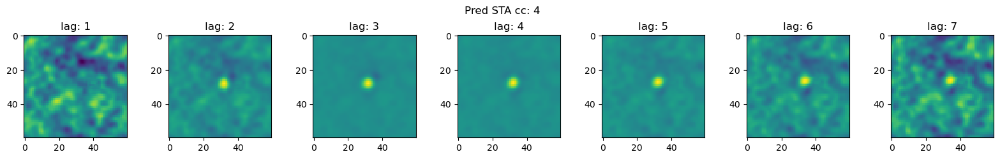

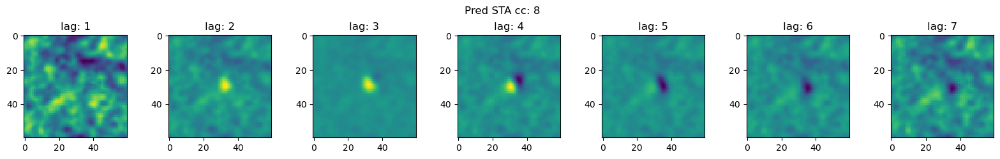

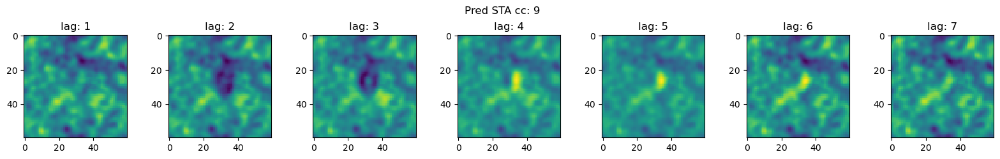

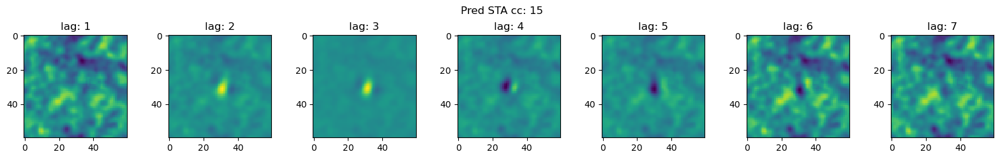

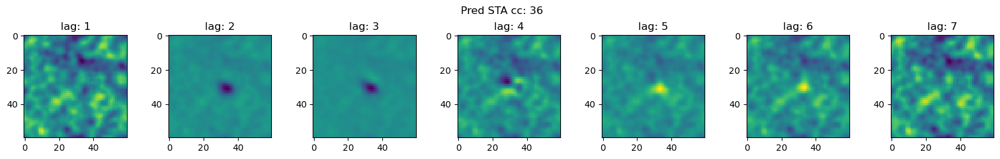

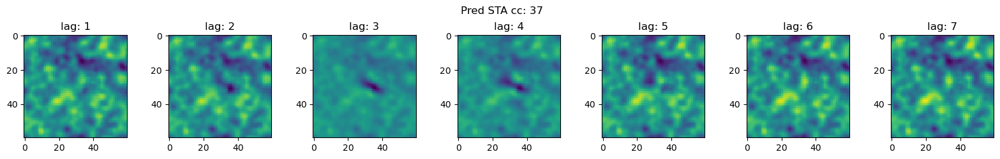

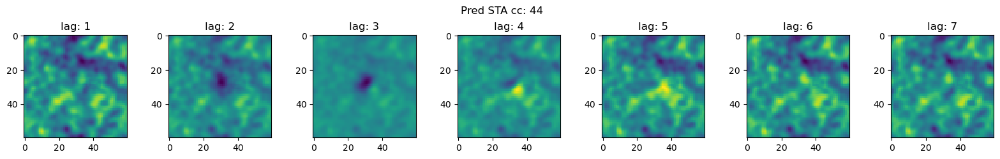

In [206]:
print("STAs")
for cc in interesting_cells:
    ss(1,7)
    col = 1
    for lag in range(len(stas)):
        plt.subplot(1,7, col)
        imagesc(stas[lag][:,:, cc])
        plt.title('lag: ' + str(lag+1))
        col += 1
    # adjust the plot down
    plt.subplots_adjust(top=0.8)
    plt.suptitle('Pred STA cc: ' + str(cc))
plt.show()

In [234]:
# # plot STAs
# ss(29,6)
# for cc in range(NCv):
#     plt.subplot(29,6, cc+1)
#     imagesc(stas[:,:, cc])
#     plt.title(str(cc) + ' -- ' + str(valET[cc]))
# plt.show()

## fit Drifts from pred

In [16]:
# set the robs in the data to the predicted robs
data.robs = pred

In [17]:
num_lags = 16

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-8,
    tolerance_grad=1e-8,
    history_size=100,
    batch_size=20,
    max_epochs=3,
    max_iter=500,
    device=device)

folder = 'glms_04_pred4'

In [20]:
drifts = []
for i, cc in enumerate([5,23,39,60]):
    drift_model_filename = 'models/'+folder+'/drift_model_cc'+str(cc)+'.pkl'
    data.set_cells(cc)
    drift_ndn = NDN.NDN(
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_ndn.block_sample=True
    drift_ndn.networks[0].xstim_n = 'Xdrift'
    drift_ndn.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LL = drift_ndn.eval_models(data[data.val_blks], null_adjusted=False)[0]
    drift_model = Model(drift_ndn, LL)
    drifts.append(drift_model)
    with open(drift_model_filename, 'wb') as f:
        pickle.dump(drift_model, f)

Output set to 1 cells
Output set to 1 cells
Output set to 1 cells
Output set to 1 cells


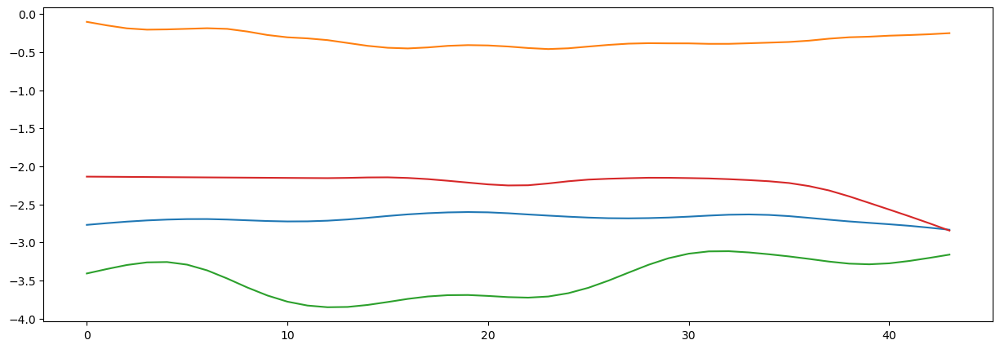

In [21]:
fig = plt.figure(figsize=(15,5))
for drift in drifts:
    plt.plot(drift.ndn.networks[0].layers[0].get_weights())

## fit GLM from pred

In [22]:
glms = []
for i, cc in enumerate([5,23,39,60]):
    glm_model_filename = 'models/'+folder+'/glm_model_cc'+str(cc)+'.pkl'
    data.set_cells(cc)
    LLsNULL = drifts[i].LLs
    glm = NDN.NDN(ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
    glm.block_sample=True
    drift_weights = drifts[i].ndn.networks[0].layers[0].weight.data[:,0]
    glm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    glm.networks[1].layers[0].set_parameters(val=False)
    glm.networks[2].layers[0].set_parameters(val=False,name='weight')
    glm.fit(data, force_dict_training=True, **lbfgs_pars)
    LL = glm.eval_models(data[data.val_blks], null_adjusted=False)[0]
    null_adjusted_LL = LLsNULL - LL
    glm_model = Model(glm, null_adjusted_LL)
    glms.append(glm_model)
    with open(glm_model_filename, 'wb') as f:
        pickle.dump(glm_model, f)

Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 5.846813201904297 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.158530950546265 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.740477800369263 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 4.143380165100098 sec elapsed


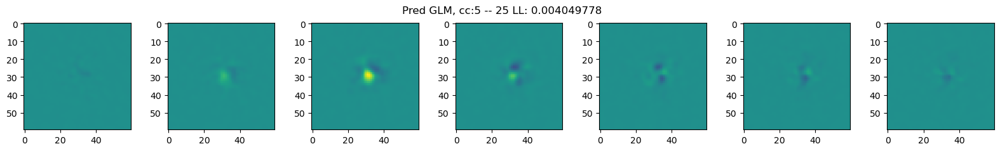

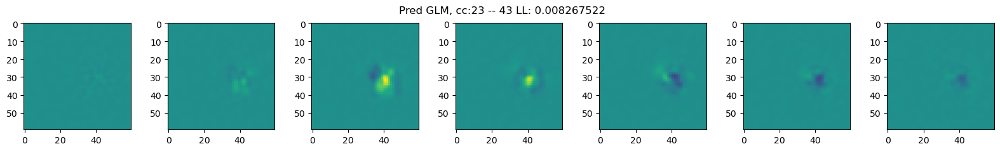

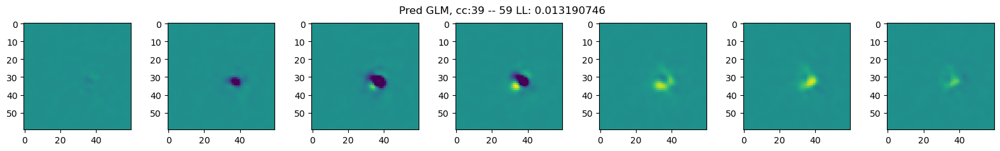

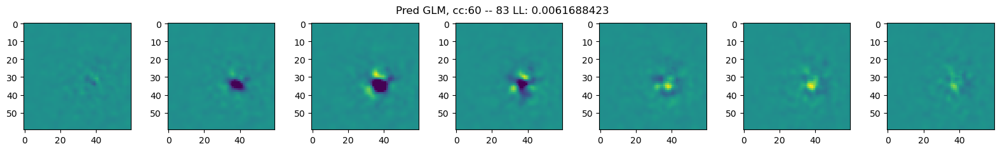

In [23]:
for i, cc in enumerate([5,23,39,60]):
    max_weights = np.max(glms[i].ndn.networks[0].layers[0].get_weights())
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(glms[i].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('Pred GLM, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(glms[i].LLs))
        col += 1
    plt.show()

## fit GQM from pred

In [24]:
gqms = []
for i, cc in enumerate([5,23,39,60]):
    gqm_model_filename = 'models/'+folder+'/gqm_model_cc'+str(cc)+'.pkl'
    drift_weights = drifts[i].ndn.networks[0].layers[0].weight.data[:,0]
    data.set_cells(cc)

    LLsNULL = drifts[i].LLs

    # get the best reg_vals for the GLM
    best_reg_vals = glms[i].ndn.networks[0].layers[0].reg.vals

    # get the best reg_vals for the GLM
    stim_net['layer_list'][0]['reg_vals'] = deepcopy(best_reg_vals)

    gqm = NDN.NDN(ffnet_list = [stim_net, drift_net, stim_qnet, net2_comb], loss_type='poisson')
    gqm.networks[0].layers[0] = deepcopy(glms[i].ndn.networks[0].layers[0])
    gqm.block_sample=True
    gqm.networks[3].layers[0].set_parameters(val=False,name='weight')
    gqm.networks[1].layers[0].weight.data[:,0] = deepcopy(drift_weights)
    gqm.networks[1].layers[0].set_parameters(val=False)

    gqm.fit(data, force_dict_training=True, **lbfgs_pars)
    LL = gqm.eval_models(data[data.val_blks], null_adjusted=False)[0]

    null_adjusted_LL = LLsNULL - LL

    gqm_model = Model(gqm, null_adjusted_LL)
    gqms.append(gqm_model)
    
    with open(gqm_model_filename, 'wb') as f:
        pickle.dump(gqm_model, f)

Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 21.942727088928223 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 28.38860297203064 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 12.302725076675415 sec elapsed
Output set to 1 cells

GPU Available: True, GPU Used: True
Done fitting
  Fit complete: 19.54653024673462 sec elapsed


-------------


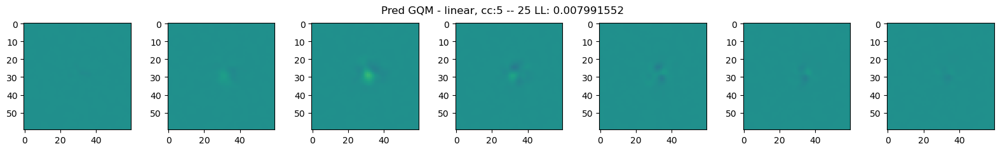

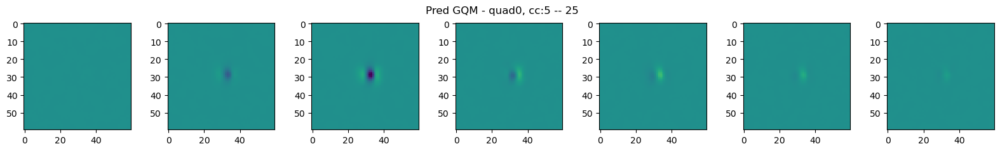

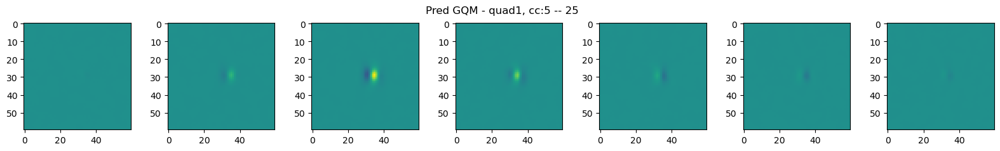

-------------


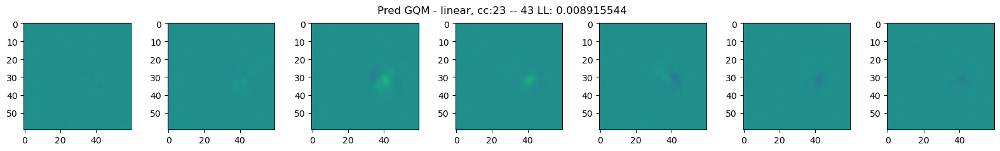

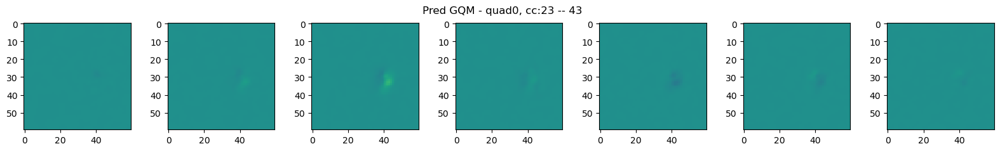

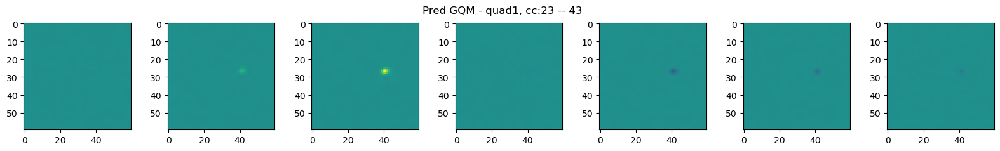

-------------


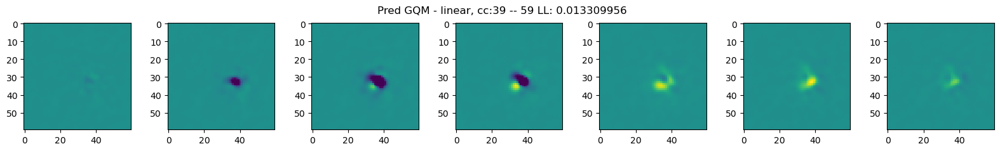

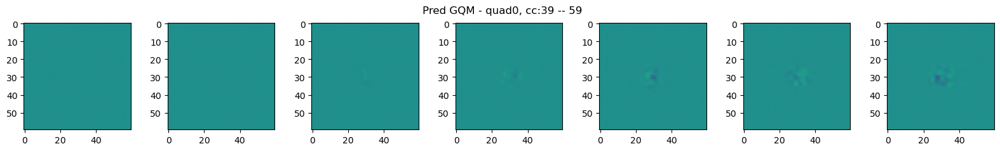

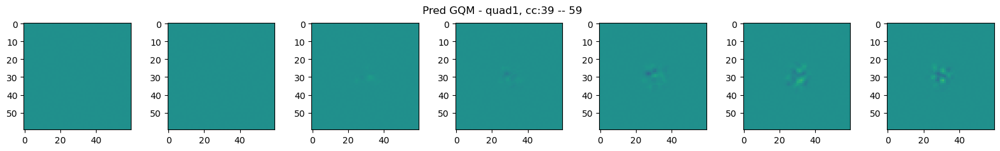

-------------


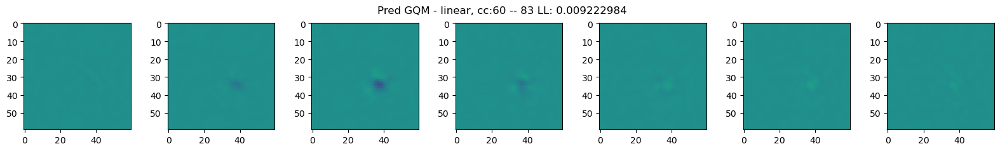

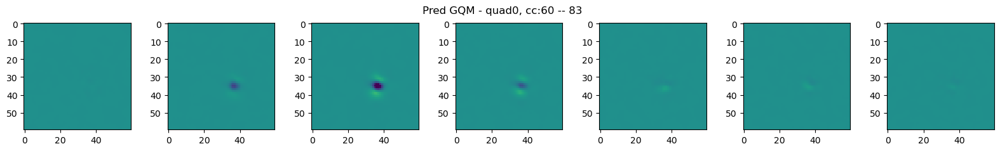

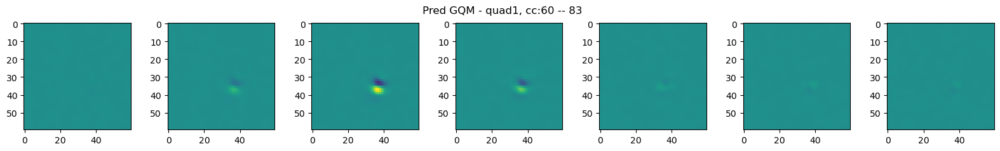

In [25]:
# plot filters
for i, cc in enumerate([5,23,39,60]):
    max_weights = 0
    weights_lin = np.max(gqms[i].ndn.networks[0].layers[0].get_weights())
    weights_quad = np.max(gqms[i].ndn.networks[2].layers[0].get_weights())
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    print('-------------')
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('Pred GQM - linear, cc:' + str(cc) + ' -- ' + str(valET[cc]) + ' LL: ' + str(gqms[i].LLs))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.suptitle('Pred GQM - quad0, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    ss(1,7)
    col = 1
    for lag in range(num_lags-2, num_lags-9, -1):
        plt.subplot(1,7, col)
        imagesc(gqms[i].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.suptitle('Pred GQM - quad1, cc:' + str(cc) + ' -- ' + str(valET[cc]))
        col += 1
    plt.show()

# CNN analysis

## weights

In [99]:
best_trial.params

{'learning_rate': 0.001700868660241172,
 'weight_decay': 0.23620331339890444,
 'LGN_num_filters': 4,
 'num_subs': 38,
 'num_inh': 0.4073419045012585,
 'proj_filter_width': 21,
 'LGN_NLtype': 'lin',
 'num_iter': 5,
 'iter_filter_width': 9}

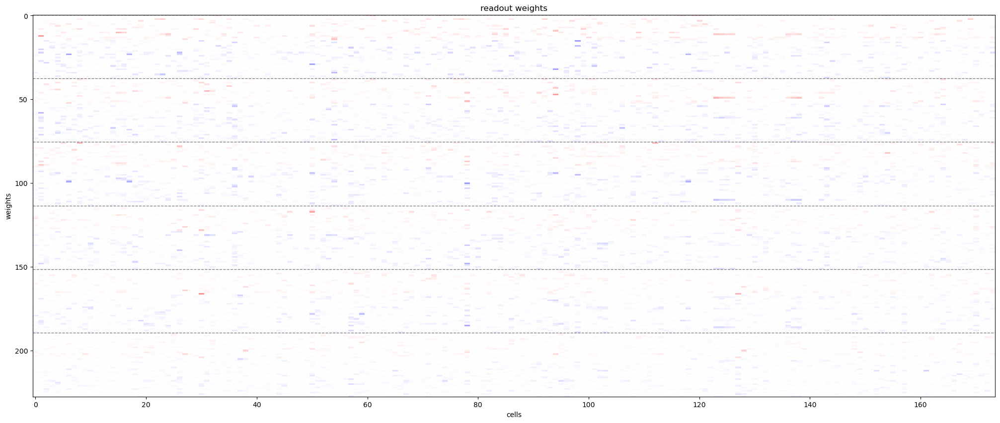

In [100]:
layer_bounds, readout_weights = mplt.plot_readout_weights(best_cnn)

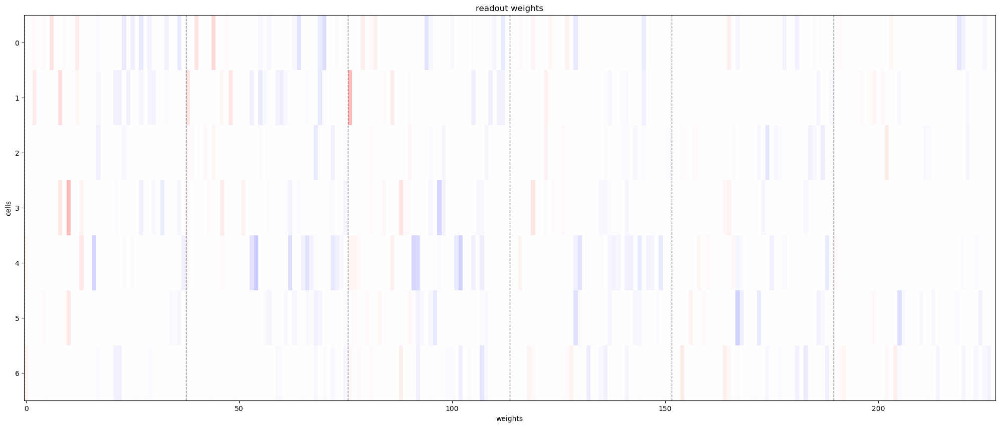

In [102]:
# look at weights for interesting cells
_ = mplt.plot_readout_weights(best_cnn, cells=interesting_cells)

## simple vs. complex

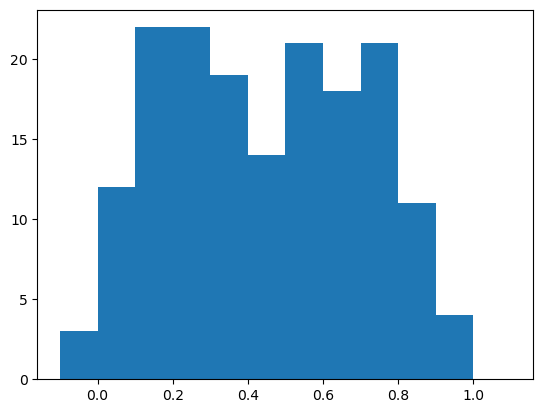

Simple Cells


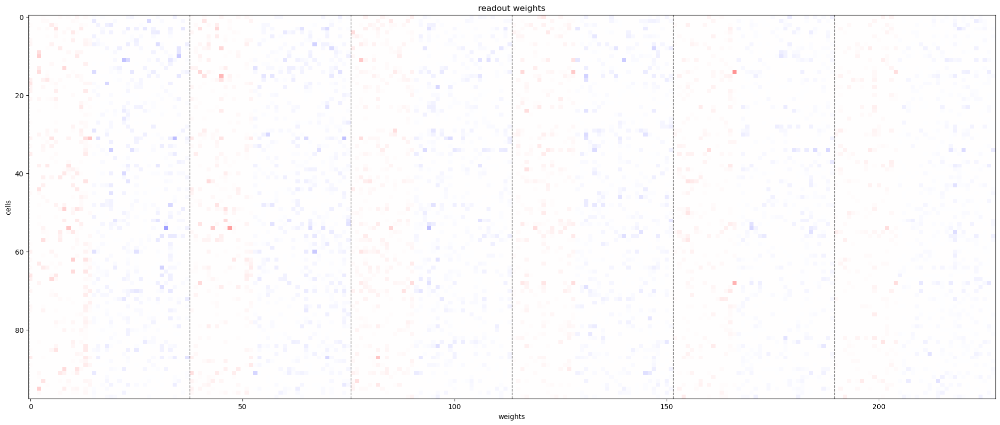

Complex Cells


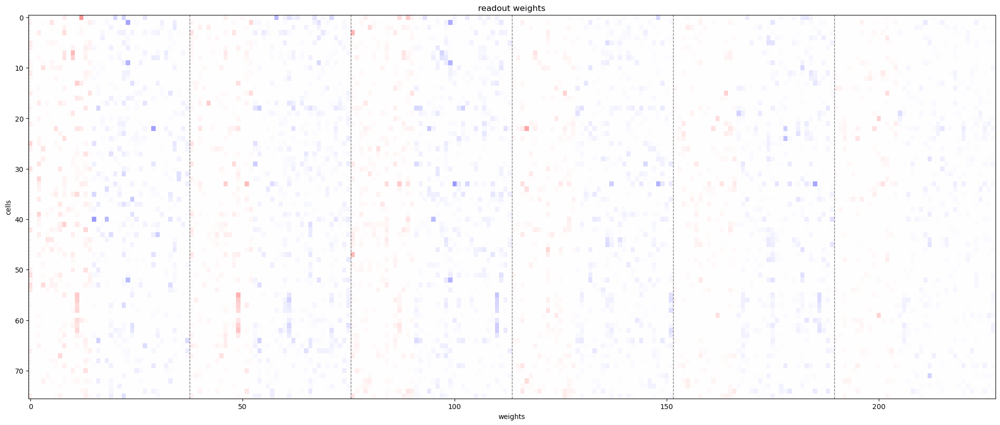

In [103]:
shaps = [val[2] for val in complexity_values]
plt.hist(shaps, bins=np.arange(-0.1, 1.1, 0.1))
plt.show()

simple_cells = [i for i, val in enumerate(complexity_values) if val[2] < 0.5]
complex_cells = [i for i, val in enumerate(complexity_values) if val[2] >= 0.5]

print('Simple Cells')

mplt.plot_readout_weights(best_cnn, cells=simple_cells)

print('Complex Cells')
_ = mplt.plot_readout_weights(best_cnn, cells=complex_cells)

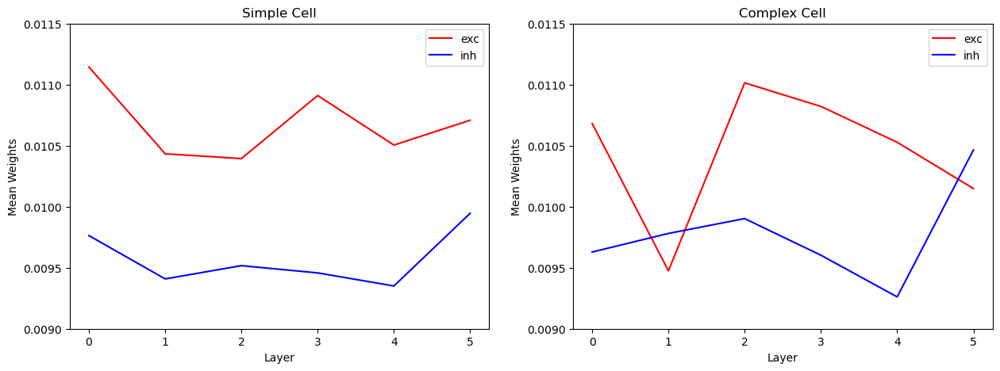

In [104]:
# plot sum of excitatory weights (above 0) and inhibitory weights (below 0) for each layer for simple and complex cells
exc_weights_simp = []
inh_weights_simp = []
exc_weights_comp = []
inh_weights_comp = []
for i in range(len(layer_bounds)-1):
    exc_weights_simp.append(np.mean(readout_weights[np.where(readout_weights[layer_bounds[i]:layer_bounds[i+1], simple_cells] > 0)]))
    inh_weights_simp.append(np.mean(readout_weights[np.where(readout_weights[layer_bounds[i]:layer_bounds[i+1], simple_cells] < 0)]))
    exc_weights_comp.append(np.mean(readout_weights[np.where(readout_weights[layer_bounds[i]:layer_bounds[i+1], complex_cells] > 0)]))
    inh_weights_comp.append(np.mean(readout_weights[np.where(readout_weights[layer_bounds[i]:layer_bounds[i+1], complex_cells] < 0)]))

fig = plt.figure(figsize=(15, 5))
plt.subplot(1,2,1)
plt.plot(exc_weights_simp, label='exc', c='r')
plt.plot(np.abs(inh_weights_simp), label='inh', c='b')
plt.ylim(0.009, 0.0115)
plt.xlabel('Layer')
plt.ylabel('Mean Weights')
plt.legend()
plt.title('Simple Cell')
plt.subplot(1,2,2)
plt.plot(exc_weights_comp, label='exc', c='r')
plt.plot(np.abs(inh_weights_comp), label='inh', c='b')
plt.ylim(0.009, 0.0115)
plt.xlabel('Layer')
plt.ylabel('Mean Weights')
plt.legend()
plt.title('Complex Cell')
plt.show()

In [105]:
layer_bounds, readout_weights.shape

(array([  0,  38,  76, 114, 152, 190, 228]), (228, 174))

## motion selectivity

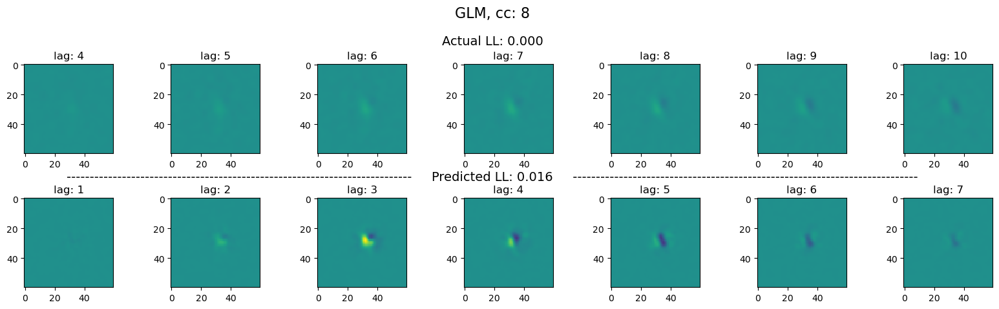

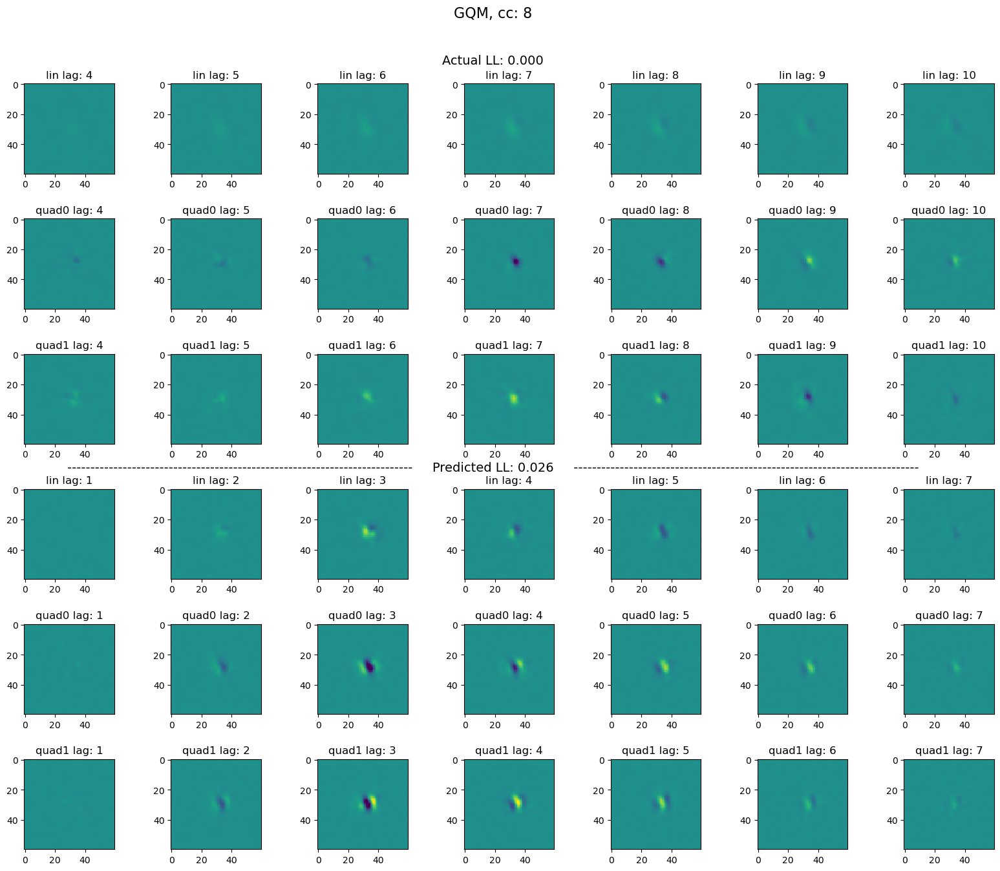

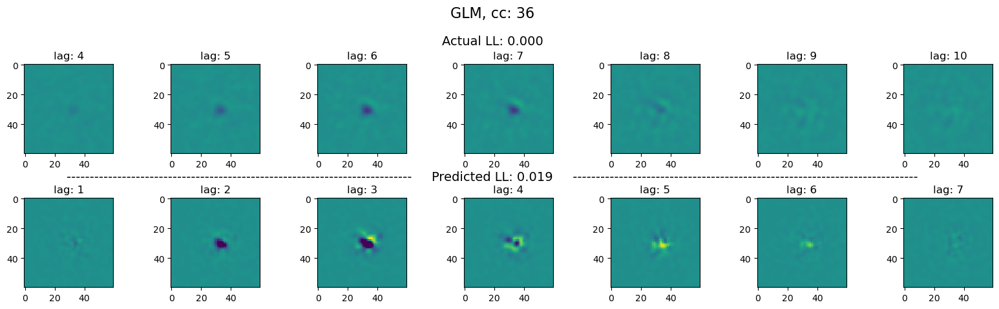

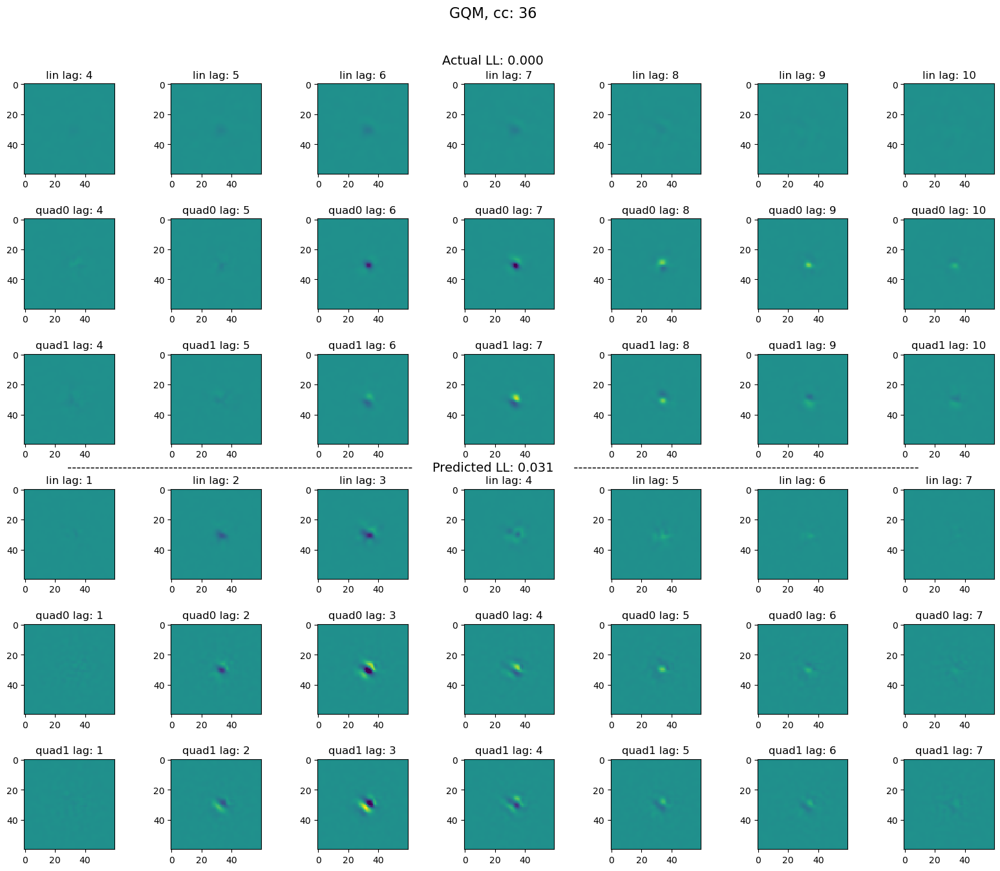

In [48]:
robs_motion_scores = []
pred_motion_scores = []
for cc in [8, 36]:
    ##### GLM #####
    max_weights = np.max([np.max(robs_glms[cc].ndn.networks[0].layers[0].get_weights()),
                          np.max(pred_glms[cc].ndn.networks[0].layers[0].get_weights())])

    fig = plt.figure(figsize=(20, 5))
    grid = matplotlib.gridspec.GridSpec(2, 7)
    grid.update(hspace=0.5) # put spacing between rows

    # plot the robs GLM
    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[0, col])
        imagesc(robs_glms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lag: ' + str(15-lag))

    # plot the pred GLM
    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[1, col])
        imagesc(pred_glms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lag: ' + str(15-lag))

    # plot text indicating the start of the robs section
    plt.text(0.5, 0.86, 'Actual LL: %0.3f' % robs_glms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)
    # plot text indicating the start of the robs section
    plt.text(0.5, 0.44, '---------------------------------------------------------------------------     Predicted LL: %0.3f     ---------------------------------------------------------------------------' % pred_glms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)

    # super title
    plt.subplots_adjust(top=0.8)
    plt.suptitle('GLM, cc: ' + str(cc), fontsize=16)


    ##### GQM #####
    max_weights = 0
    weights_lin = np.max([np.max(robs_gqms[cc].ndn.networks[0].layers[0].get_weights()),
                          np.max(pred_gqms[cc].ndn.networks[0].layers[0].get_weights())])
    weights_quad = np.max([np.max(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()),
                           np.max(pred_gqms[cc].ndn.networks[2].layers[0].get_weights())])
    if weights_lin > max_weights:
        max_weights = weights_lin
    if weights_quad > max_weights:
        max_weights = weights_quad

    fig = plt.figure(figsize=(20, 15))
    grid = matplotlib.gridspec.GridSpec(6, 7)
    grid.update(hspace=0.5) # put spacing between rows

    # plot the robs GQM
    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[0, col])
        imagesc(robs_gqms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lin lag: ' + str(15-lag))

    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[1, col])
        imagesc(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('quad0 lag: ' + str(15-lag))

    for col, lag in enumerate(range(11, 4, -1)):
        ax = plt.subplot(grid[2, col])
        imagesc(robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.title('quad1 lag: ' + str(15-lag))
        col += 1

    # plot the pred GQM
    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[3, col])
        imagesc(pred_gqms[cc].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('lin lag: ' + str(15-lag))

    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[4, col])
        imagesc(pred_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0], max=max_weights)
        plt.title('quad0 lag: ' + str(15-lag))

    for col, lag in enumerate(range(14, 7, -1)):
        ax = plt.subplot(grid[5, col])
        imagesc(pred_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1], max=max_weights)
        plt.title('quad1 lag: ' + str(15-lag))

    # plot text indicating the start of the robs section
    plt.text(0.5, 0.92, 'Actual LL: %0.3f' % robs_gqms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)
    # plot text indicating the start of the robs section
    plt.text(0.5, 0.5, '---------------------------------------------------------------------------     Predicted LL: %0.3f     ---------------------------------------------------------------------------' % pred_gqms[cc].LLs, horizontalalignment='center', transform=fig.transFigure, fontsize=14)

    # super title
    plt.subplots_adjust(top=0.9)
    plt.suptitle('GQM, cc: ' + str(cc), fontsize=16)
    plt.show()

## plot cross-sections

(60, 60, 12) (60, 60, 12) (60, 60, 12)
-------------


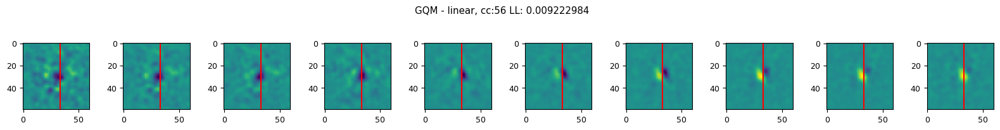

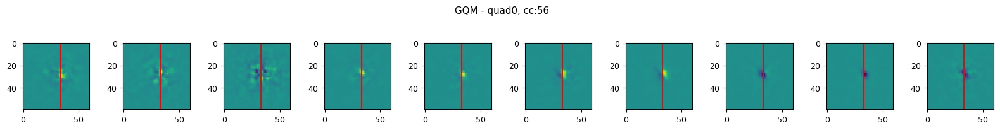

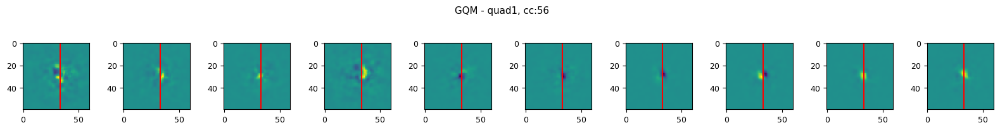

In [277]:
# start with cell 21 (looks like a direction selective cell)
linear = robs_gqms[8].ndn.networks[0].layers[0].get_weights()[:,:, :, 0]
quad0 = robs_gqms[8].ndn.networks[2].layers[0].get_weights()[:,:, :, 0]
quad1 = robs_gqms[8].ndn.networks[2].layers[0].get_weights()[:,:, :, 1]
print(linear.shape, quad0.shape, quad1.shape)

print('-------------')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(robs_gqms[8].ndn.networks[0].layers[0].get_weights()[:,:, lag, 0])
    # draw a vertical line at the center of the image
    plt.axvline(x=33, color='r')
    plt.suptitle('GQM - linear, cc:' + str(valET[interesting_cells[-1]]) + ' LL: ' + str(gqms[-1].LLs))
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(robs_gqms[8].ndn.networks[2].layers[0].get_weights()[:,:, lag, 0])
    plt.suptitle('GQM - quad0, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
ss(1,10)
for lag in range(10):
    plt.subplot(1,10, lag+1)
    imagesc(robs_gqms[8].ndn.networks[2].layers[0].get_weights()[:,:, lag, 1])
    plt.suptitle('GQM - quad1, cc:' + str(valET[interesting_cells[-1]]))
    plt.axvline(x=33, color='r')
plt.show()

[[29 29]
 [31 31]]


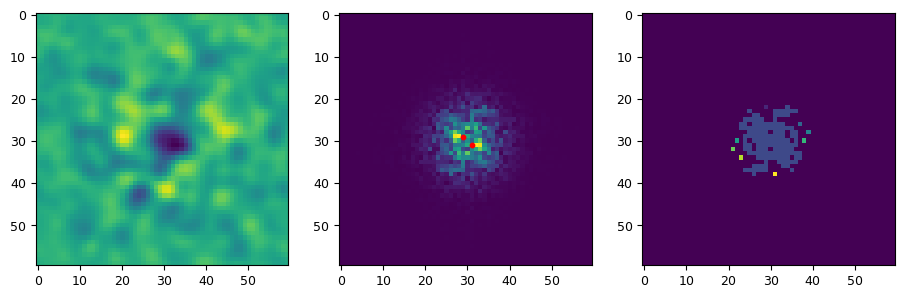

(22.0, 29.0) 1.0
(30.0, 30.0) 141.0
(26.0, 37.0) 1.0
(28.0, 39.0) 1.0
(30.0, 22.0) 1.0
(30.0, 38.0) 1.0
(32.0, 21.0) 1.0
(34.0, 23.0) 1.0
(38.0, 31.0) 1.0
[ERROR] Not enough centers found
[[29 30]
 [31 30]]


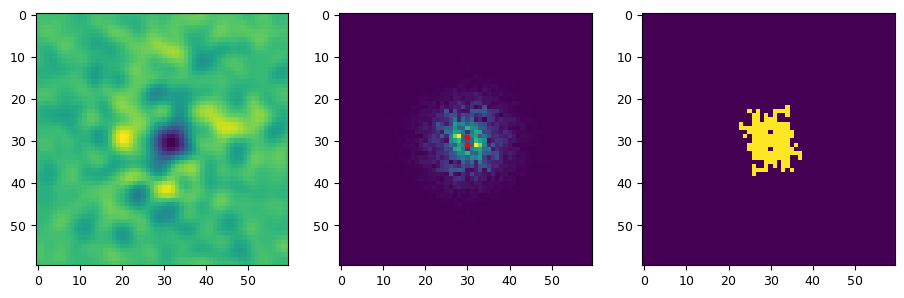

(30.0, 30.0) 129.0
[ERROR] Not enough centers found
[[30 30]]


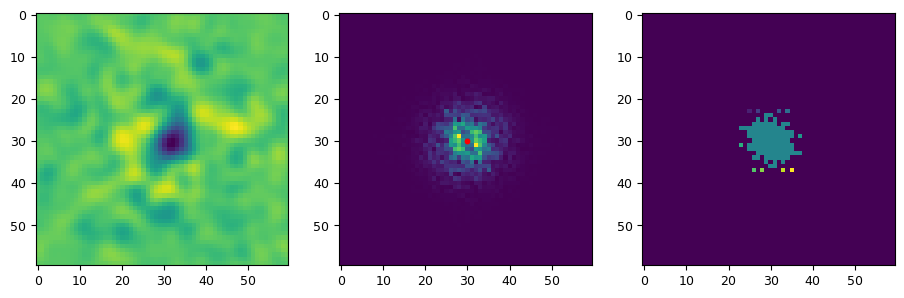

(23.0, 25.0) 1.0
(23.0, 27.0) 1.0
(23.0, 32.0) 1.0
(23.0, 34.0) 1.0
(30.0, 30.0) 101.0
(29.0, 37.0) 1.0
(31.0, 23.0) 1.0
(37.0, 26.0) 1.0
(37.0, 28.0) 1.0
(37.0, 33.0) 1.0
(37.0, 35.0) 1.0
[ERROR] Not enough centers found
[[29 32]
 [31 28]]


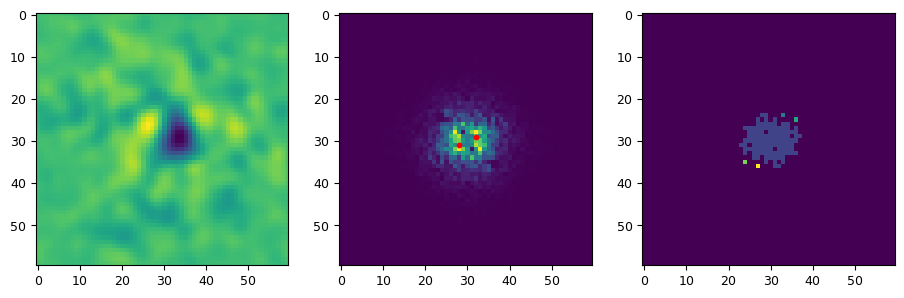

(30.0, 30.0) 107.0
(24.0, 33.0) 1.0
(25.0, 36.0) 1.0
(35.0, 24.0) 1.0
(36.0, 27.0) 1.0
[ERROR] Not enough centers found
[[29 33]
 [31 27]]


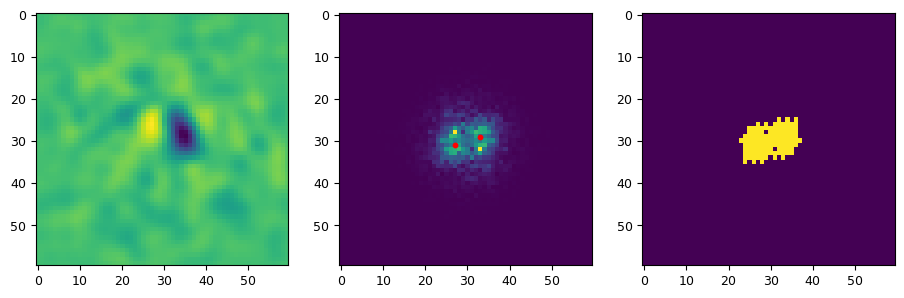

(30.0, 30.0) 109.0
[ERROR] Not enough centers found
[[29 33]
 [31 27]]


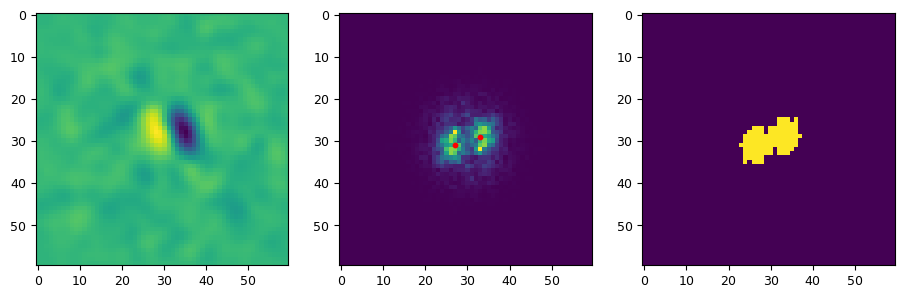

(30.0, 30.0) 101.0
[ERROR] Not enough centers found
[[29 34]
 [31 26]]


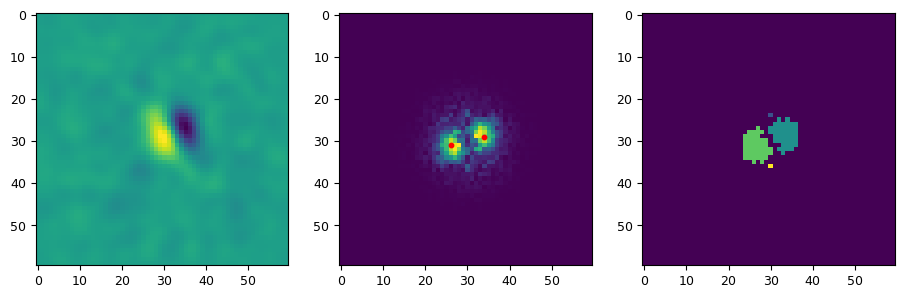

(24.0, 30.0) 1.0
(28.6046511627907, 33.395348837209305) 43.0
(31.3953488372093, 26.6046511627907) 43.0
(36.0, 30.0) 1.0


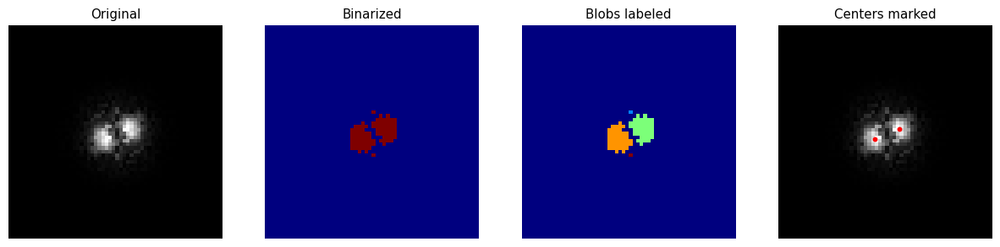

angle 22.34064795999412
distance 7.341768752511867
[[28 33]
 [32 27]]


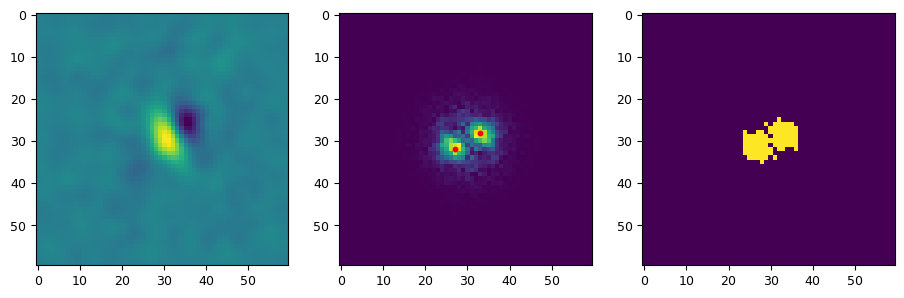

(30.0, 30.0) 85.0
[ERROR] Not enough centers found
[[29 33]
 [31 27]]


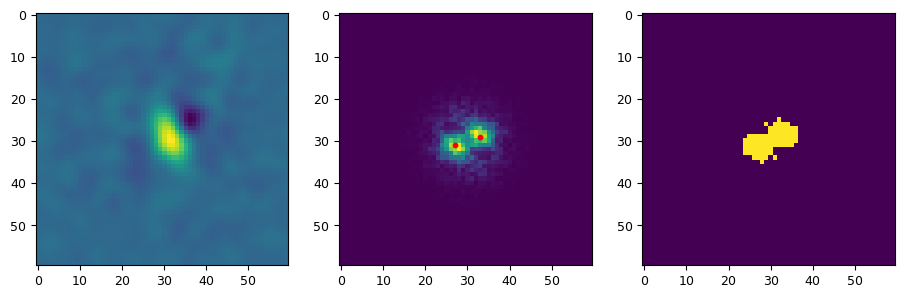

(30.0, 30.0) 77.0
[ERROR] Not enough centers found
[[30 30]]


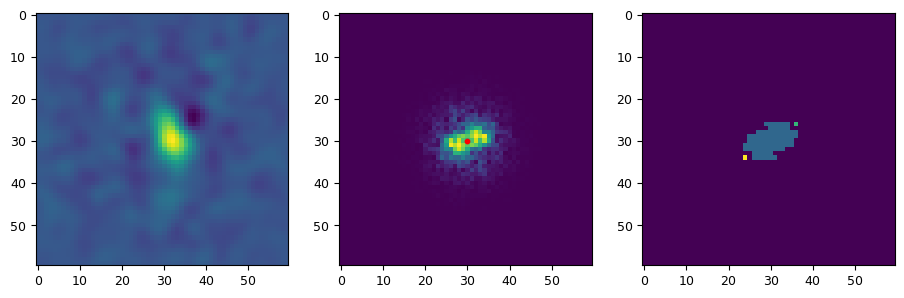

(30.0, 30.0) 77.0
(26.0, 36.0) 1.0
(34.0, 24.0) 1.0
[ERROR] Not enough centers found


In [299]:
from skimage.feature import peak_local_max
from skimage.morphology import erosion
from skimage import filters

for lag in range(10):

    fig = plt.figure(figsize=(15,5))
    grid = plt.GridSpec(1, 4, hspace=0.2, wspace=0.2)
    
    ax = fig.add_subplot(grid[0,0])
    im = linear[:,:,lag].T
    ax.imshow(im)
    
    ax = fig.add_subplot(grid[0,1])
    fftim = np.fft.fft2(im)
    fftim = np.fft.fftshift(fftim) # shift the zero-frequency component to the center of the spectrum
    ax.imshow(np.abs(fftim))
    
    # find the peaks in the fft
    smoothed_fftim = filters.gaussian(np.abs(fftim), sigma=10, truncate=1/5)
    peaks = peak_local_max(np.abs(smoothed_fftim), min_distance=2, threshold_rel=0.5)
    print(peaks)
    # plot the peaks on the fft
    for peak in peaks:
        ax.scatter(peak[1], peak[0], c='r', s=10)
    
    from skimage.filters import threshold_otsu, threshold_multiotsu
    from skimage.measure import label, regionprops
    
    threshold = threshold_otsu(np.abs(fftim))
    fgim = np.abs(fftim) > threshold # binarize the image
    
    # blob detection on the regions
    label_im = label(fgim)
    
    ax = fig.add_subplot(grid[0,2])
    ax.imshow(label_im)
    
    plt.show()
    
    # get the centers of the blobs
    regions = regionprops(label_im)
    centers = []
    for region in regions:
        print(region.centroid, region.area)
        if region.area > 2:
            centers.append(region.centroid)
    
    centers = np.array(centers)
    
    if len(centers) < 2:
        print('[ERROR] Not enough centers found')
        continue
        
    fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(15, 5))
    
    # Plotting the original fftim.
    ax[0].imshow(np.abs(fftim), cmap='gray')
    ax[0].set_title('Original')
    ax[0].axis('off')
    
    # Plotting the Otsu result.
    ax[1].imshow(fgim, cmap='jet')
    ax[1].set_title('Binarized')
    ax[1].axis('off')
    
    ax[2].imshow(label_im, cmap='jet')
    ax[2].set_title('Blobs labeled')
    ax[2].axis('off')
    
    # Plotting the original fftim.
    ax[3].imshow(np.abs(fftim), cmap='gray')
    ax[3].set_title('Centers marked')
    ax[3].axis('off')
    
    # plot the centers
    for center in centers:
        ax[3].scatter(center[1], center[0], c='r', s=10)
    
    plt.subplots_adjust()
    
    plt.show()
    
    # get the angle of the line between the two peaks
    # get the x and y coordinates of the peaks
    x = centers[:, 1]
    y = centers[:, 0]
    # get the vector between the two peaks
    v = np.array([x[1]-x[0], y[1]-y[0]])
    # get the length of the vector
    v_len = np.sqrt(v[0]**2 + v[1]**2)
    # normalize the vector
    v = v / v_len
    # get the angle of the vector
    angle = np.arctan(v[1]/v[0])
    # convert to degrees
    angle = np.abs(angle * 180 / np.pi)
    print('angle', angle)
    
    # get the distance between the two peaks in arc minutes
    # get the distance between the two peaks
    d = np.sqrt((x[1]-x[0])**2 + (y[1]-y[0])**2)
    # convert to arc minutes
    d = d * 60 / 60
    print('distance', d)

/home/mattjac/anaconda3/envs/pytorch2/lib/python3.11/site-packages/matplotlib/axes/_axes.py:6793: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16


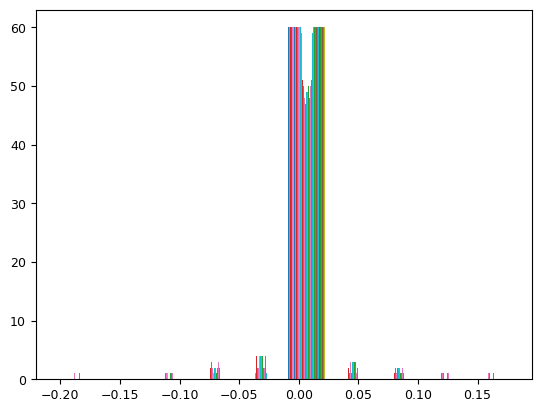

In [222]:
_ = plt.hist(fftim)

angle 33.690067525979785
distance 7.211102550927978


In [145]:
# find the points along the vector along the two peaks
# get the x and y coordinates of the peaks
x = peaks[:, 1]
y = peaks[:, 0]
# get the vector between the two peaks
v = np.array([x[1]-x[0], y[1]-y[0]])
# get the length of the vector
v_len = np.sqrt(v[0]**2 + v[1]**2)
# normalize the vector
v = v / v_len
# get the points along the vector
points = []
for i in range(1, 20):
    points.append([x[0] + i*v[0], y[0] + i*v[1]])
points = np.array(points)
print(points)

[[31.10557281 29.4472136 ]
 [30.21114562 29.89442719]
 [29.31671843 30.34164079]
 [28.42229124 30.78885438]
 [27.52786405 31.23606798]
 [26.63343685 31.68328157]
 [25.73900966 32.13049517]
 [24.84458247 32.57770876]
 [23.95015528 33.02492236]
 [23.05572809 33.47213595]
 [22.1613009  33.91934955]
 [21.26687371 34.36656315]
 [20.37244652 34.81377674]
 [19.47801933 35.26099034]
 [18.58359214 35.70820393]
 [17.68916494 36.15541753]
 [16.79473775 36.60263112]
 [15.90031056 37.04984472]
 [15.00588337 37.49705831]]


In [ ]:
# take a vertical slice of each of the linear and quadratic receptive fields to plot in a single image
x = 33
plt.figure(figsize=(15,5))
linear_slice = linear[:, x, :]
quad0_slice = quad0[:, x, :]
quad1_slice = quad1[:, x, :]
plt.subplot(1,3,1)
imagesc(linear_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,2)
imagesc(quad0_slice)
plt.xlabel('space')
plt.ylabel('time')
plt.subplot(1,3,3)
imagesc(quad1_slice)
plt.xlabel('space')
plt.ylabel('time')

## contour detection

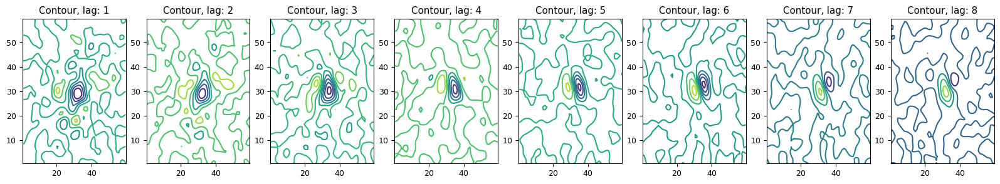

In [283]:
fig = plt.figure(figsize=(20,3))
grid = plt.GridSpec(1, 8, hspace=0.2, wspace=0.2)
for lag in range(1,9):
    ax = fig.add_subplot(grid[0,lag-1])
    qcs = ax.contour(linear[:,:,lag].T, origin='image')
    ax.set_title('Contour, lag: ' + str(lag))
plt.show()

In [284]:
print(qcs.levels)
for path in qcs.collections[0].get_paths():
    print(len(path.vertices))

centers = []
for coll, level in zip(qcs.collections, qcs.levels):
    print('LEVEL', level)
    for path in coll.get_paths():
        print(len(path.vertices))

[-0.003  -0.0015  0.      0.0015  0.003   0.0045  0.006 ]
LEVEL -0.003
LEVEL -0.0015
21
LEVEL 0.0
95
21
7
18
96
177
19
43
64
13
4
36
157
3
21
31
19
9
5
25
21
9
21
11
13
15
LEVEL 0.0015000000000000005
45
LEVEL 0.003
31
LEVEL 0.0045
15
LEVEL 0.006000000000000001


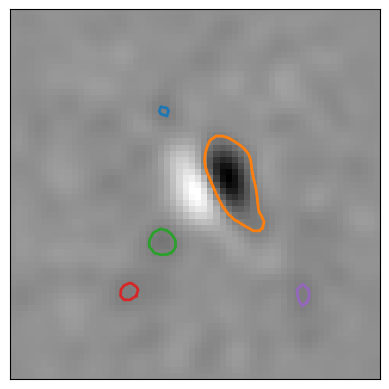

In [121]:
from skimage import measure

# Find contours at a constant value of 0.8
contours = measure.find_contours(im)

# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(im, cmap=plt.cm.gray)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

# multi-otsu

0
0
0


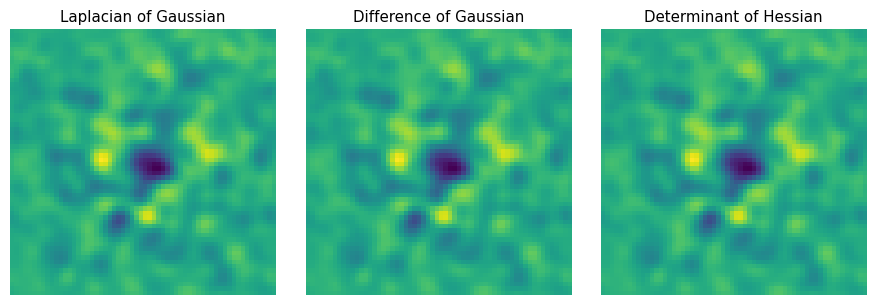

0
0
0


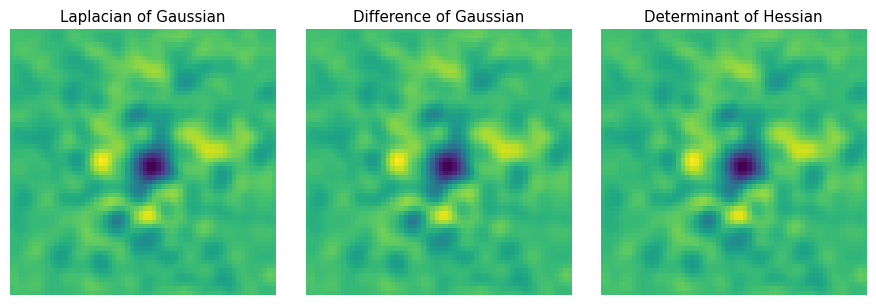

0
0
0


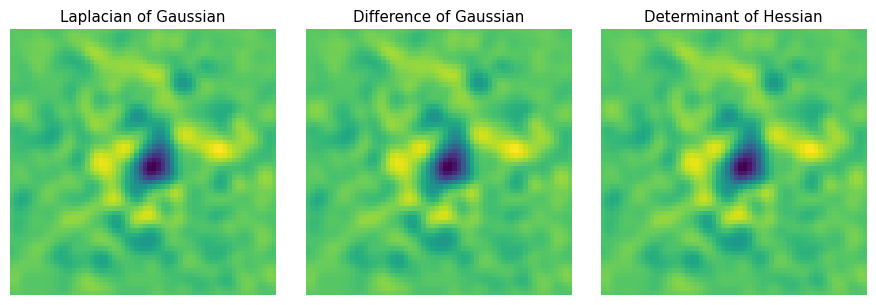

0
0
0


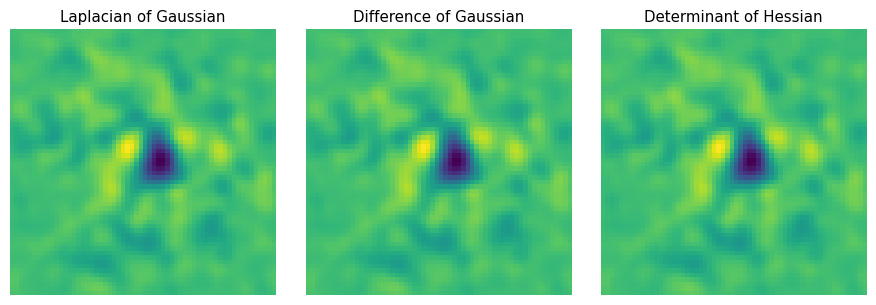

0
0
0


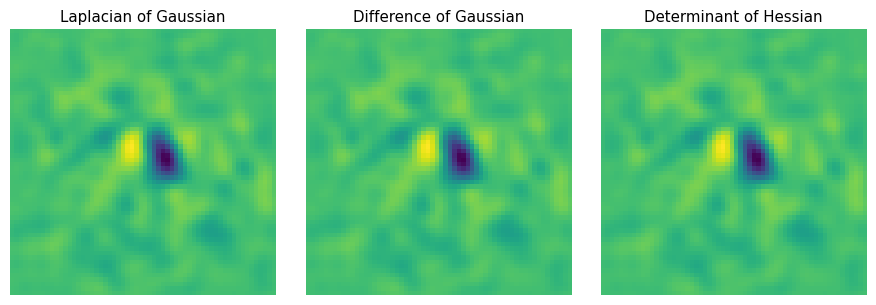

0
0
0


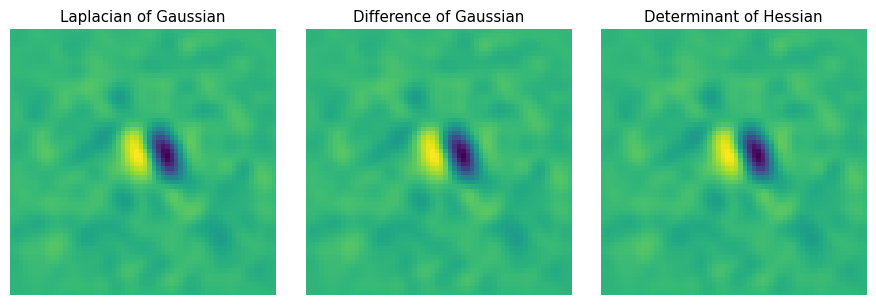

0
0
0


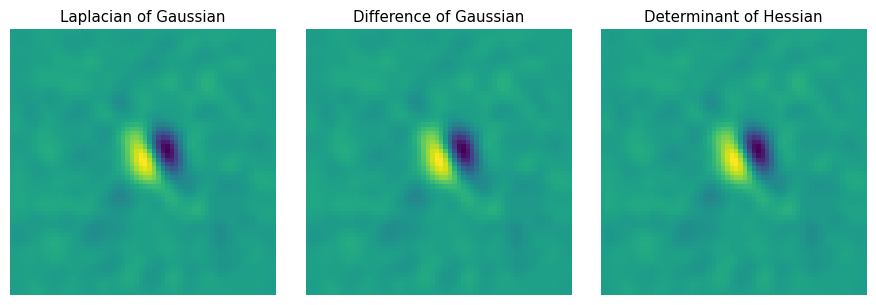

0
0
0


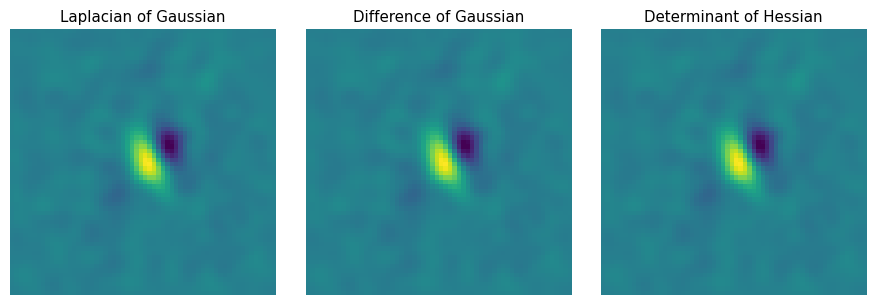

0
0
0


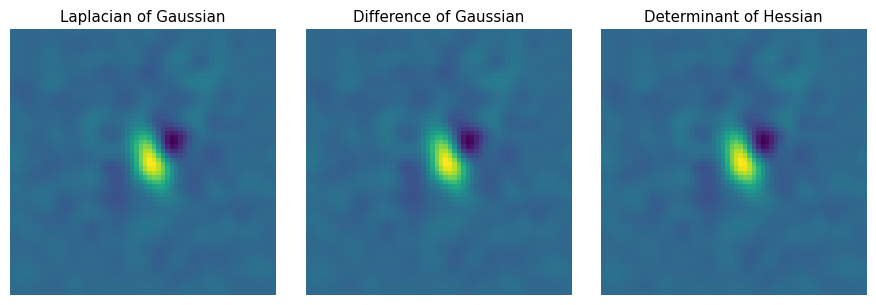

0
0
0


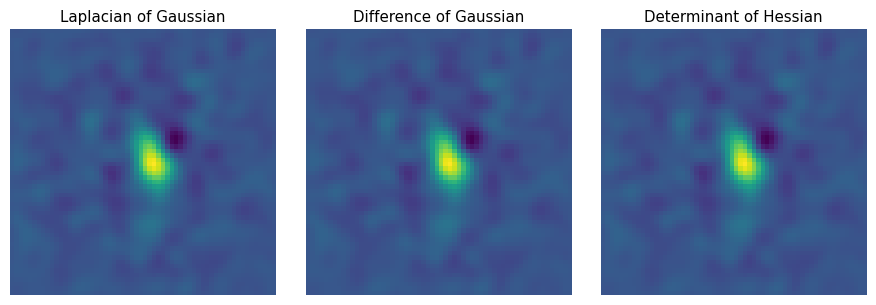

In [293]:
from math import sqrt
from skimage import data
from skimage.feature import blob_dog, blob_log, blob_doh

for lag in range(10):
    im = linear[:,:,lag].T
    blobs_log = blob_log(im)
    
    # Compute radii in the 3rd column.
    blobs_log[:, 2] = blobs_log[:, 2] * sqrt(2)
    
    blobs_dog = blob_dog(im)
    blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)
    
    blobs_doh = blob_doh(im)
    
    blobs_list = [blobs_log, blobs_dog, blobs_doh]
    colors = ['yellow', 'lime', 'red']
    titles = ['Laplacian of Gaussian', 'Difference of Gaussian',
              'Determinant of Hessian']
    sequence = zip(blobs_list, colors, titles)
    
    fig, axes = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)
    ax = axes.ravel()
    
    for idx, (blobs, color, title) in enumerate(sequence):
        print(len(blobs))
        ax[idx].set_title(title)
        ax[idx].imshow(im)
        for blob in blobs:
            y, x, r = blob
            c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
            ax[idx].add_patch(c)
        ax[idx].set_axis_off()
    
    plt.tight_layout()
    plt.show()

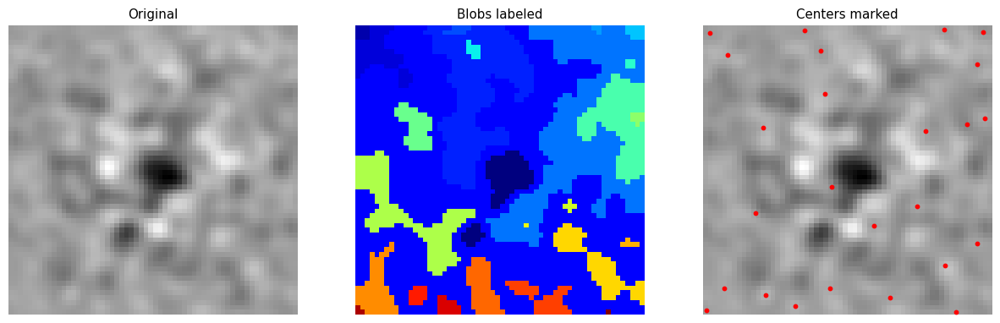

angle 52.473132242498494
distance 5.896162245087289


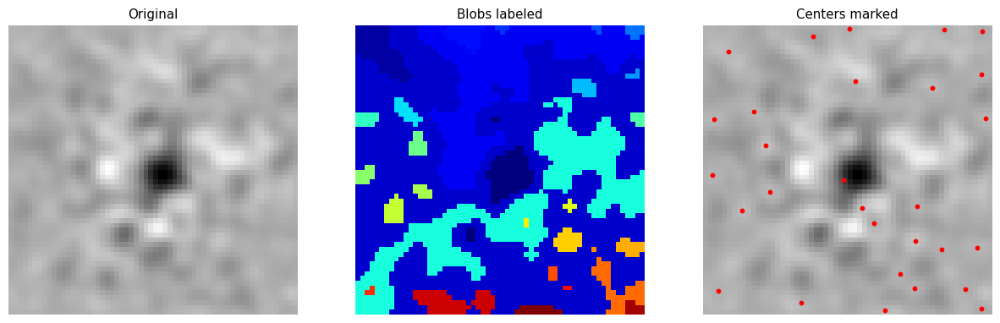

angle 48.2983732214051
distance 35.8460465683798


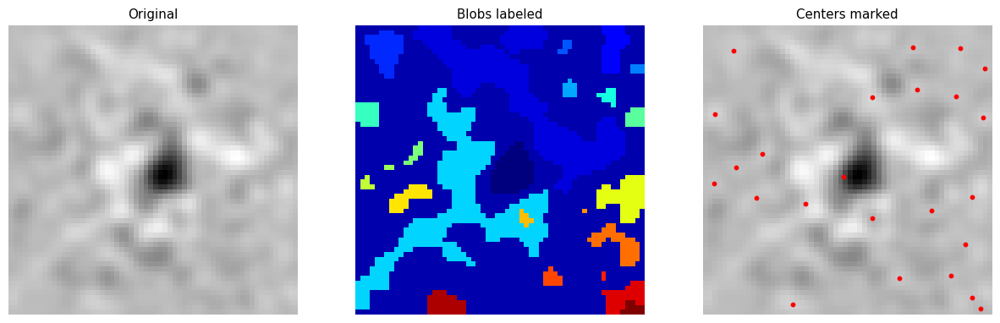

angle 69.85737569704676
distance 17.433185139030858


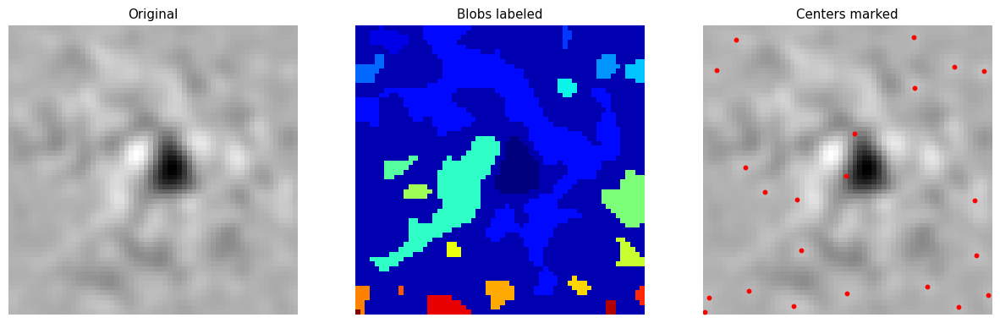

angle 50.938169493630674
distance 36.28064668513909


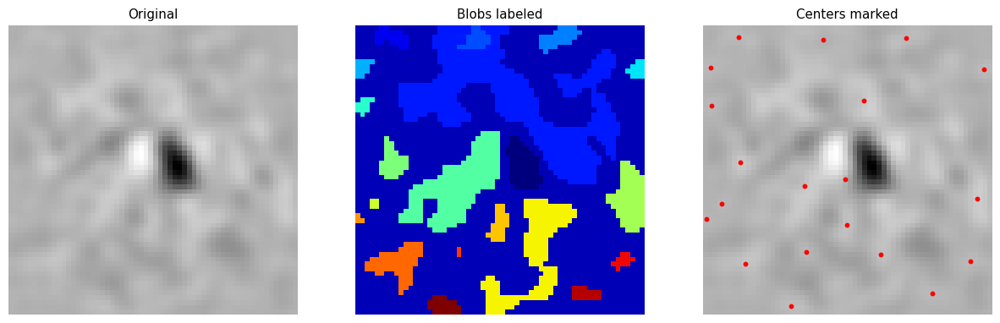

angle 53.11868355411547
distance 36.72012567346024


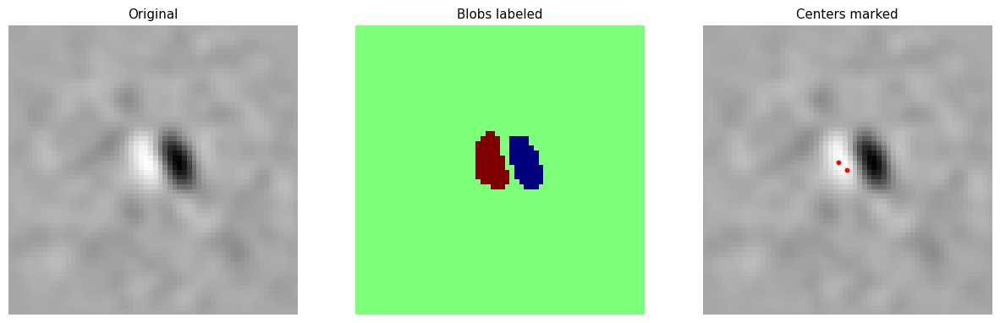

angle 41.88710519696079
distance 2.3963404941539266


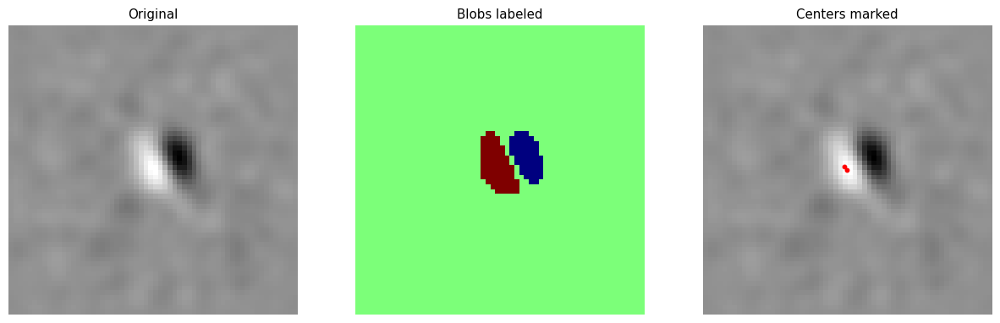

angle 59.54090301920889
distance 0.9751131969874962


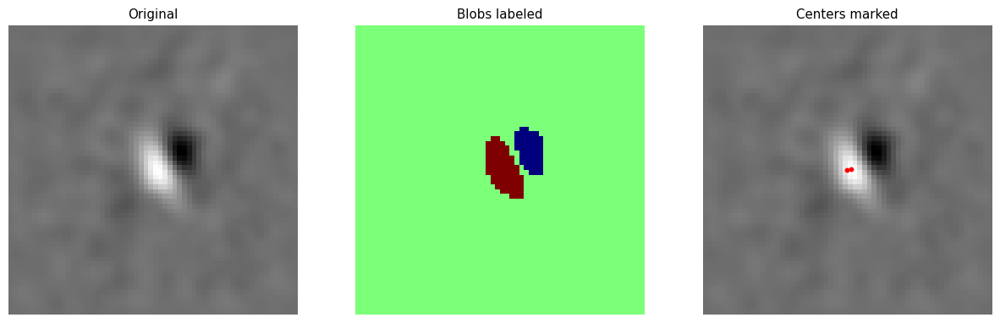

angle 14.341248153014266
distance 0.8691375979909712


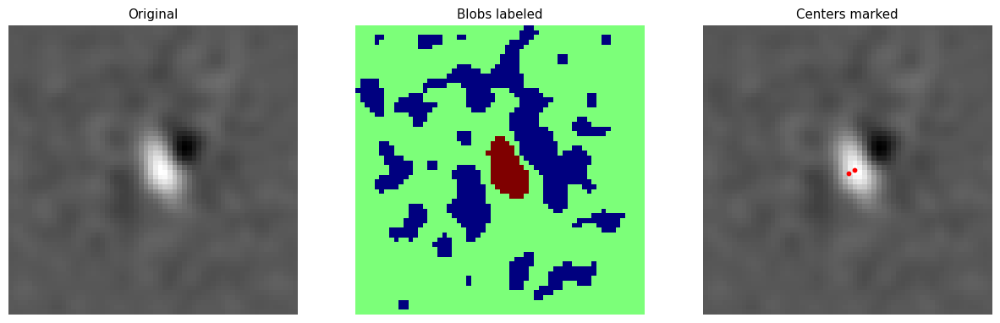

angle 28.0364262790682
distance 1.5395551088294388


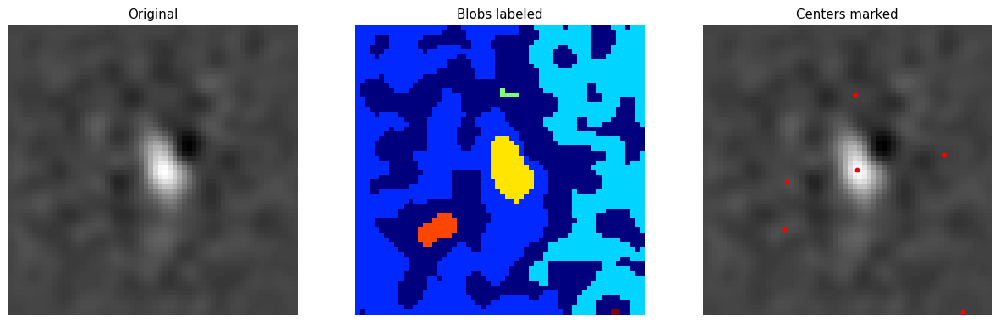

angle 9.701770738639928
distance 33.053520392407755


In [290]:
for lag in range(10):
    im = linear[:,:,lag].T
    
    from skimage import data
    from skimage.filters import threshold_multiotsu
    from skimage.measure import label, regionprops
    
    thresholds = threshold_multiotsu(im)
    
    # label the image based on the thresholds
    regions = np.digitize(im, bins=thresholds)
    
    # blob detection on the regions
    label_im = label(regions)
    
    ax = fig.add_subplot(grid[0,2])
    ax.imshow(label_im)
    
    plt.show()
    
    # get the centers of the blobs
    regions = regionprops(label_im)
    centers = []
    for region in regions:
        centers.append(region.centroid)
    
    centers = np.array(centers)
    
    if len(centers) < 2:
        print('[ERROR] Not enough centers found')
        continue
    
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
    
    # Plotting the original fftim.
    ax[0].imshow(im, cmap='gray')
    ax[0].set_title('Original')
    ax[0].axis('off')
    
    ax[1].imshow(label_im, cmap='jet')
    ax[1].set_title('Blobs labeled')
    ax[1].axis('off')
    
    # Plotting the original fftim.
    ax[2].imshow(im, cmap='gray')
    ax[2].set_title('Centers marked')
    ax[2].axis('off')
    
    # plot the centers
    for center in centers:
        ax[2].scatter(center[1], center[0], c='r', s=10)
    
    plt.subplots_adjust()
    
    plt.show()
    
    # get the angle of the line between the two peaks
    # get the x and y coordinates of the peaks
    x = centers[:, 1]
    y = centers[:, 0]
    # get the vector between the two peaks
    v = np.array([x[1]-x[0], y[1]-y[0]])
    # get the length of the vector
    v_len = np.sqrt(v[0]**2 + v[1]**2)
    # normalize the vector
    v = v / v_len
    # get the angle of the vector
    angle = np.arctan(v[1]/v[0])
    # convert to degrees
    angle = np.abs(angle * 180 / np.pi)
    print('angle', angle)
    
    # get the distance between the two peaks in arc minutes
    # get the distance between the two peaks
    d = np.sqrt((x[1]-x[0])**2 + (y[1]-y[0])**2)
    # convert to arc minutes
    d = d * 60 / 60
    print('distance', d)

# simple motion metric

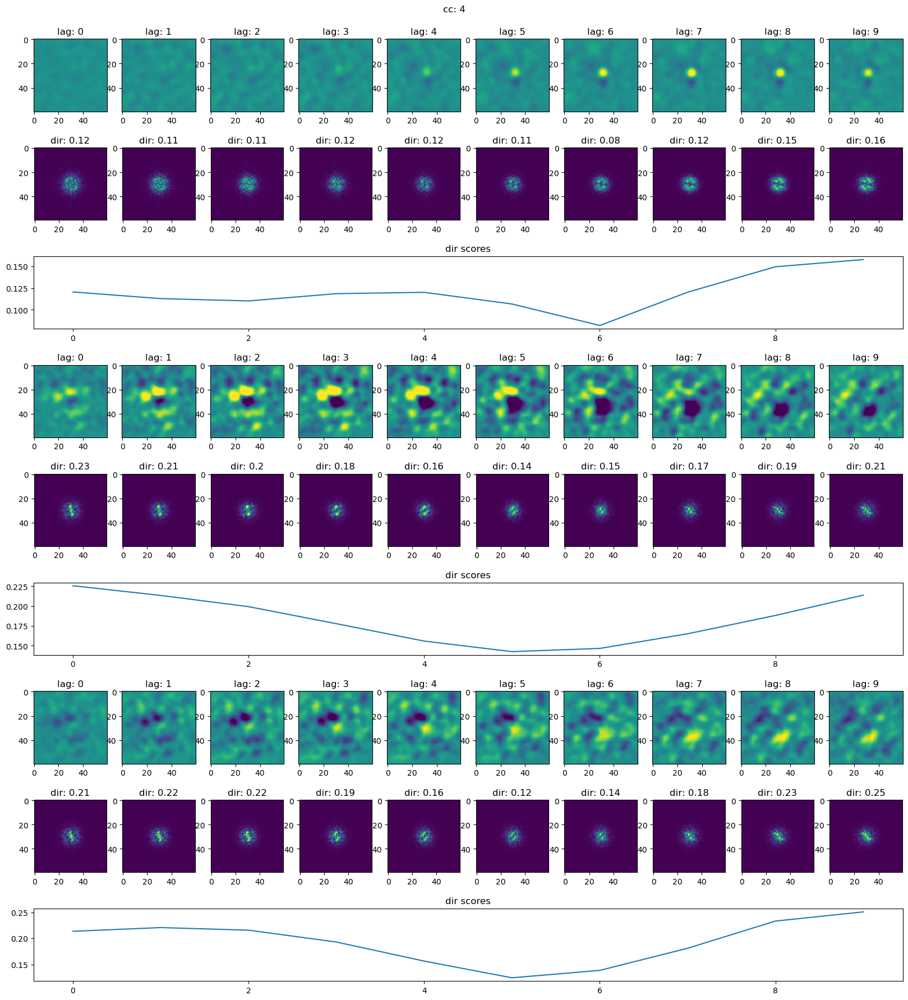

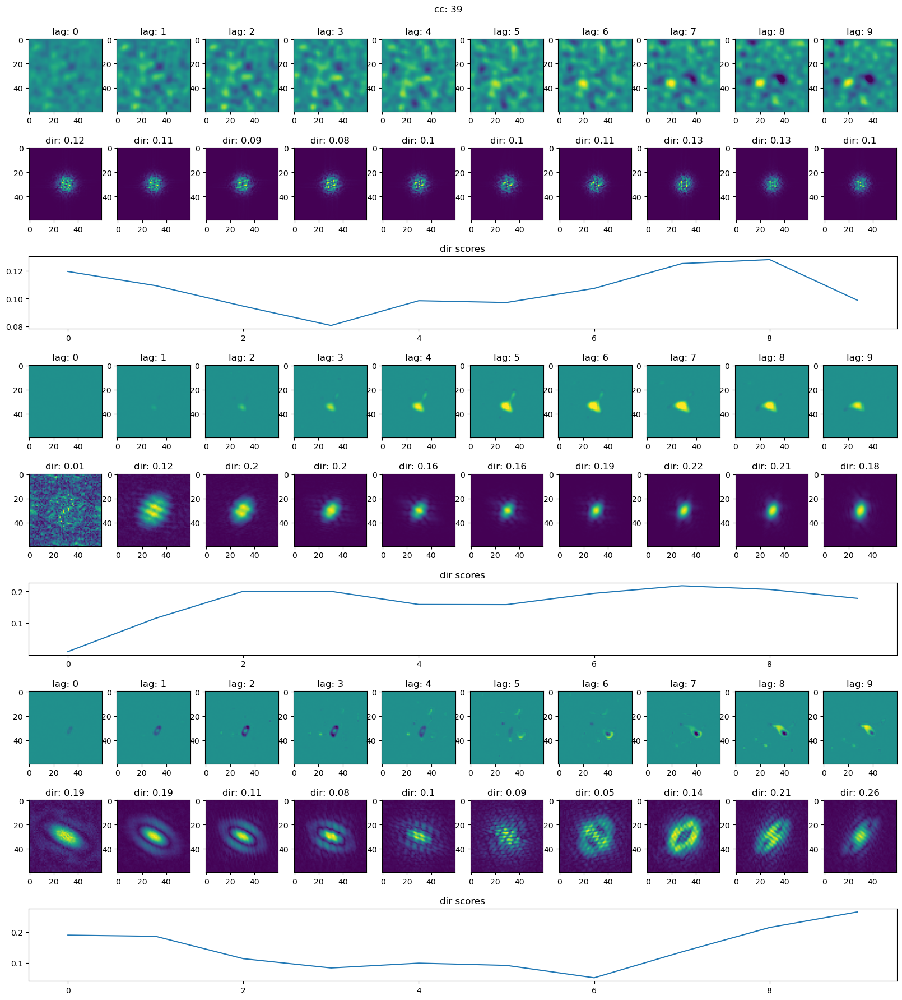

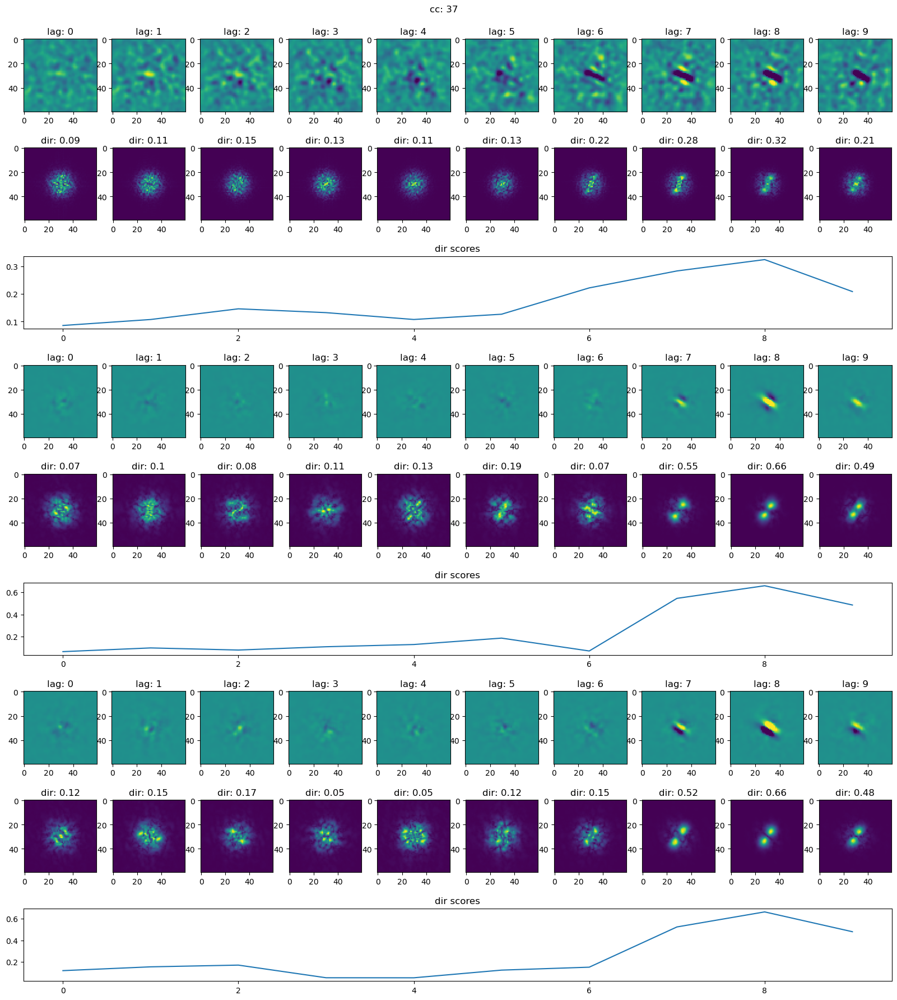

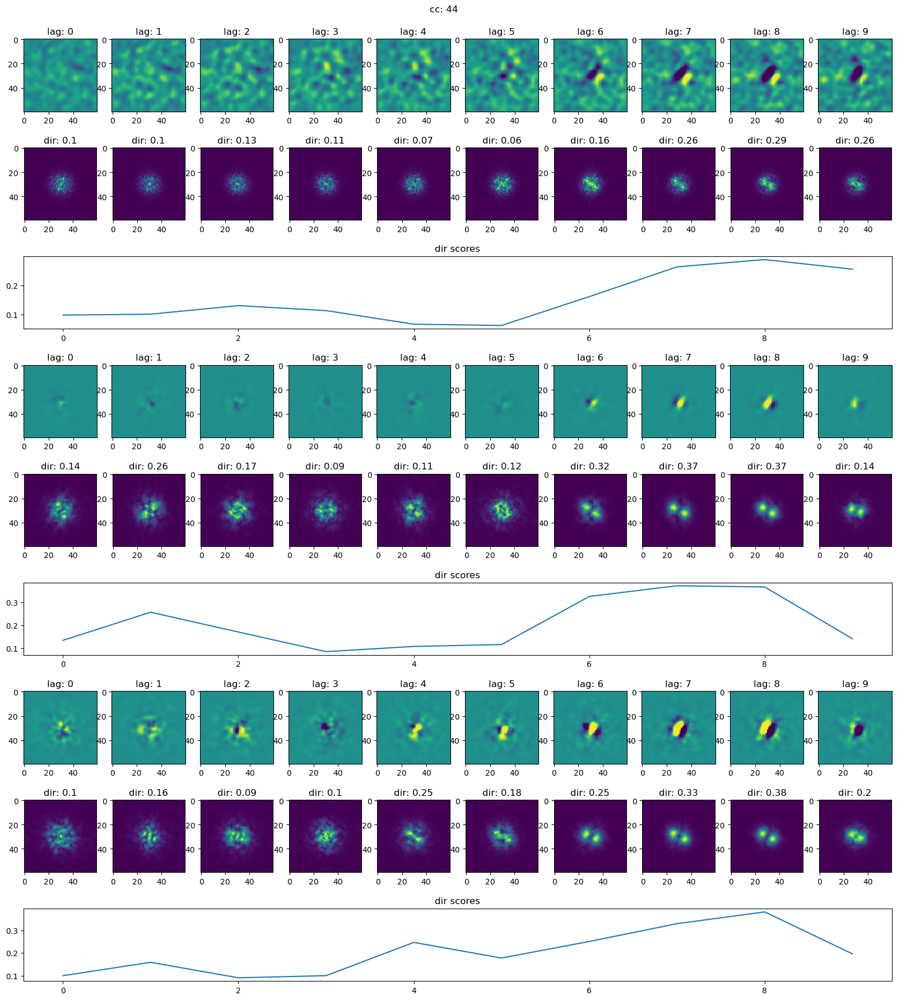

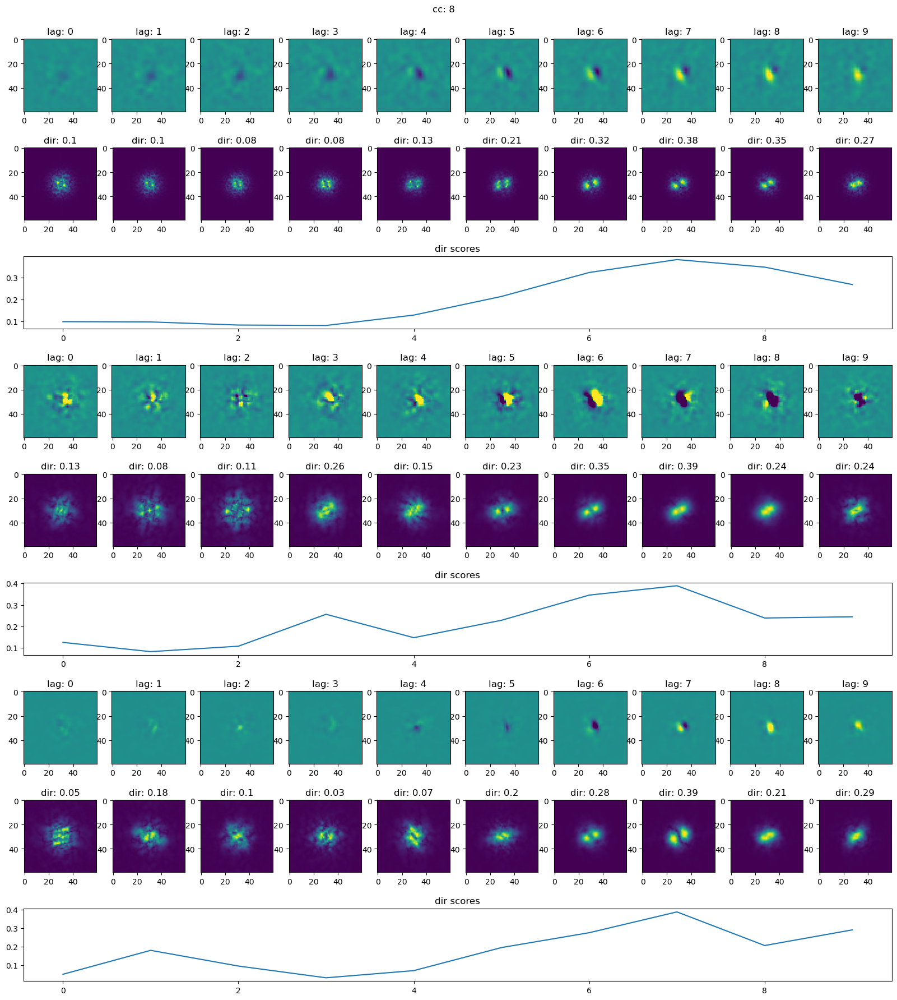

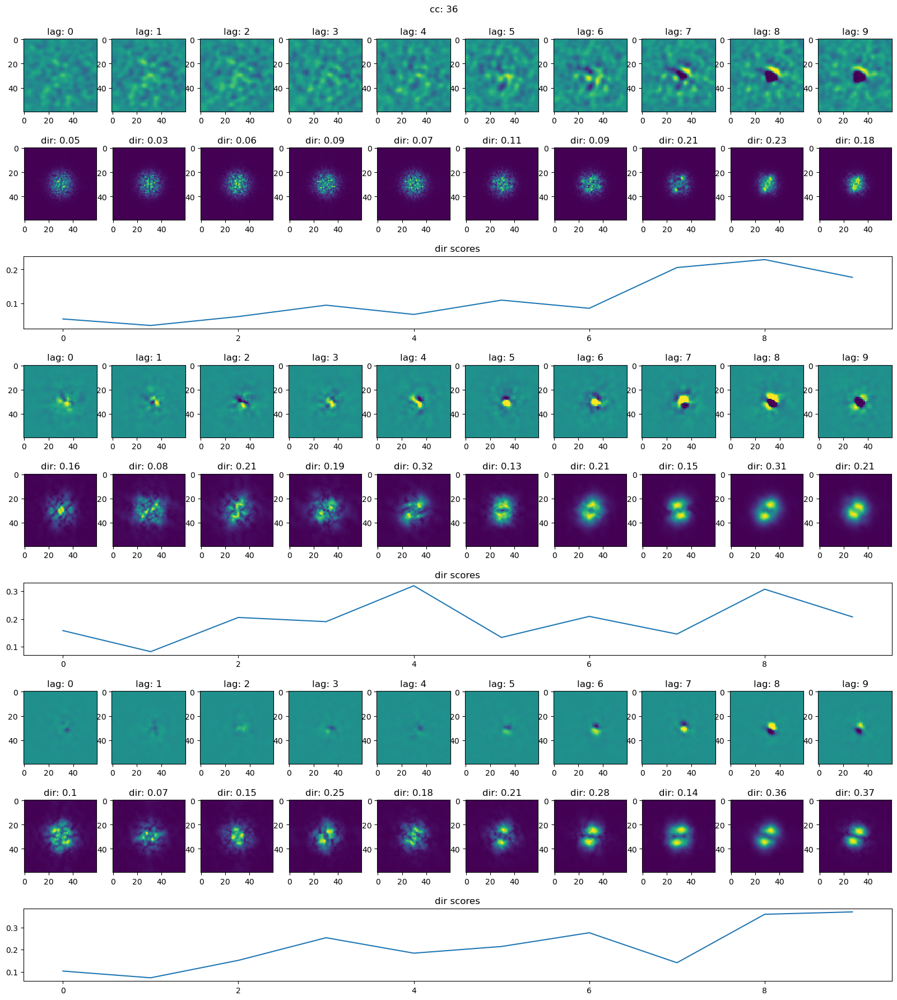

In [80]:
for cc in interesting_cells:
    linear = robs_gqms[cc].ndn.networks[0].layers[0].get_weights()[:,:, :, 0]
    quad0 = robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, :, 0]
    quad1 = robs_gqms[cc].ndn.networks[2].layers[0].get_weights()[:,:, :, 1]

    fig = plt.figure(figsize=(20, 20))
    grid = matplotlib.gridspec.GridSpec(9, 10)
    # set the vertical spacing
    grid.update(hspace=0.5) # put spacing between rows
    # shift the top up to make room for the suptitle
    grid.update(top=0.95)
    
    for layer,row in zip([linear, quad0, quad1], [0,3,6]):
        max_weight = np.max(layer[:,:,lag])
        
        dir_scores = []
        for lag in range(10):
            im = layer[:,:,lag].T

            # plot the im
            ax = plt.subplot(grid[row+0, lag])
            ax.imshow(im, vmin=-max_weight, vmax=max_weight, interpolation='none', aspect='auto')
            ax.set_title('lag: ' + str(lag))
            
            # calculate how much overlap the FFT peaks have in each of the four quadrants
            # look at each quadrant of the fftim, sum the values in each quadrant and divide by the total count
        
            fftim = np.fft.fft2(im)
            fftim = np.fft.fftshift(fftim) # shift the zero-frequency component to the center of the spectrum
            
            # get the center of the fftim
            fftim_abs = np.abs(fftim)
            
            center = np.array([fftim_abs.shape[0]//2, fftim_abs.shape[1]//2])
            
            # get the top two quadrants (left and right)
            quadrantL = fftim_abs[:center[0], center[1]:]
            quadrantR = fftim_abs[:center[0], :center[1]]
            
            # get the right two quadrants (top and bottom)
            quadrantT = fftim_abs[center[0]:, center[1]:]
            quadrantB = fftim_abs[center[0]:, :center[1]]
                
            # sum the values in each quadrant
            quadrantL_sum = np.sum(quadrantL)
            quadrantR_sum = np.sum(quadrantR)
            quadrantT_sum = np.sum(quadrantT)
            quadrantB_sum = np.sum(quadrantB)
            
            dirLR_score = (quadrantL_sum - quadrantR_sum) / (quadrantL_sum + quadrantR_sum)
            dirTB_score = (quadrantT_sum - quadrantB_sum) / (quadrantT_sum + quadrantB_sum)
            dir_score = np.max([np.abs(dirLR_score), np.abs(dirTB_score)])
            dir_scores.append(dir_score)
            
            # plot the image
            ax = plt.subplot(grid[row+1, lag])
            ax.imshow(fftim_abs)
            # set the title as the motion score up to 4 decimal places
            ax.set_title('dir: ' + str(np.round(dir_score, 2)))
        
        # plot the dir_scores
        ax = plt.subplot(grid[row+2, :])
        ax.plot(dir_scores)
        ax.set_title('dir scores')
    plt.suptitle('cc: ' + str(cc))
    plt.show()

# 3D motion metric

best lag: 8
score: 0.2395779308931211


/tmp/ipykernel_3331455/356524353.py:117: RuntimeWarning: divide by zero encountered in scalar divide
  angle = np.arctan(v[1]/v[0])


best lag: 8
score: 0.26097335286807843
best lag: 8
score: 0.2495433018498262


/home/mattjac/projects/mattjac/v1/ColorDataUtils/RFutils.py:242: RuntimeWarning: divide by zero encountered in scalar divide
  return max_x_component, max_y_component, max_network


==== GQM_motion 90 0.21 ====


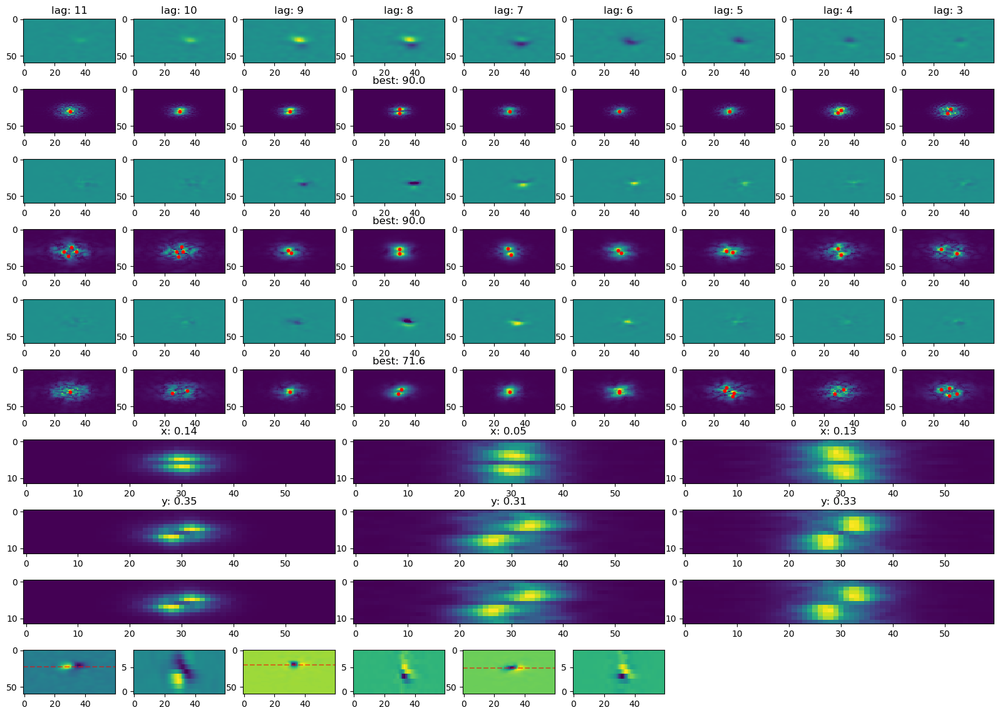

best lag: 8
score: 0.13033146088398415
best lag: 8
best lag: 8
==== GQM_motion 18 0.04 ====


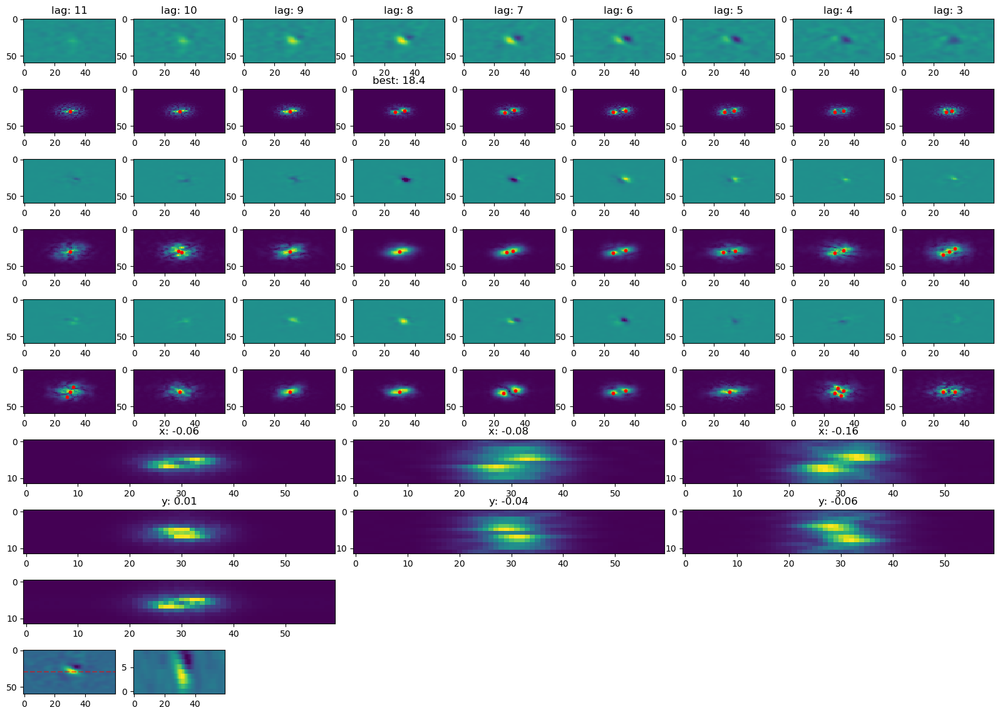

best lag: 9
score: 0.06629919913744176
best lag: 8
score: 0.2374217681322184
best lag: 8
score: 0.22149732092420504
==== GQM_motion 68 0.29 ====


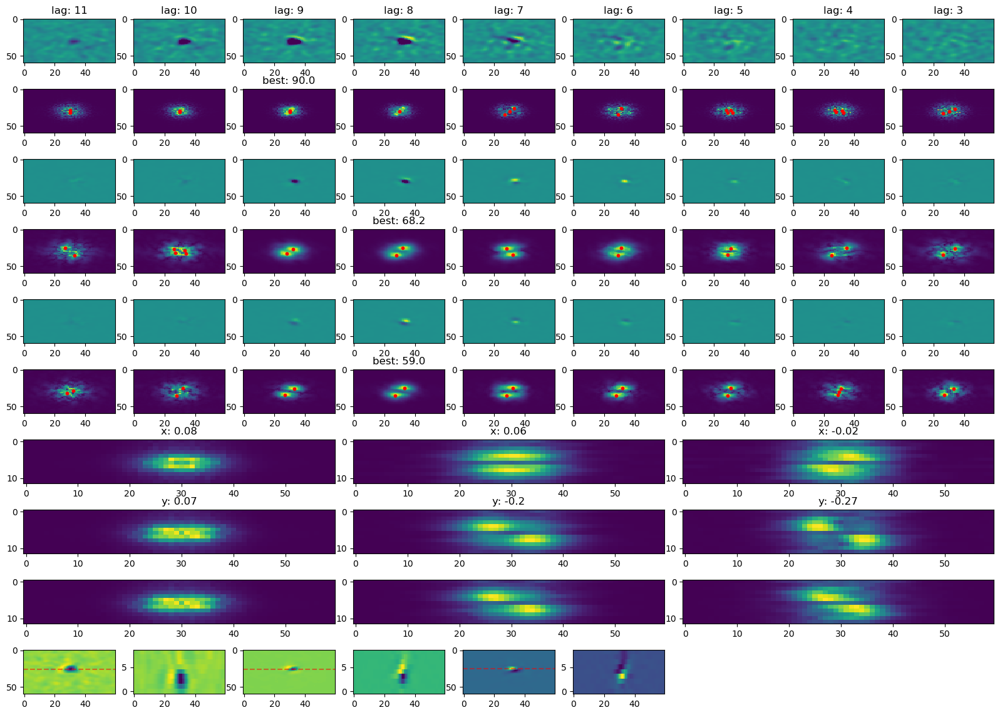

In [280]:
from skimage.feature import peak_local_max
from skimage.morphology import erosion
from skimage import filters
import scipy


def motion2(cur_mod, lin_net, quad_net):
    linear = cur_mod.networks[lin_net].layers[0].get_weights()[:,:, :, 0]
    quad0 = cur_mod.networks[quad_net].layers[0].get_weights()[:,:, :, 0]
    quad1 = cur_mod.networks[quad_net].layers[0].get_weights()[:,:, :, 1]
    
    x_components = []
    y_components = []
    
    for layer in [linear, quad0, quad1]:
        for axis in [0,1]:
            im = layer.swapaxes(0, 1)
            fftim = np.fft.fftn(im)
            fftim = np.fft.fftshift(fftim)
            fftim_abs = np.abs(fftim)
        
            fftim_abs = np.mean(fftim_abs, axis=axis).T
        
            center = np.array([fftim_abs.shape[0]//2, fftim_abs.shape[1]//2])
        
            # get the top two quadrants (left and right)
            quadrantL = fftim_abs[:center[0], center[1]:]
            quadrantR = fftim_abs[:center[0], :center[1]]
        
            # get the right two quadrants (top and bottom)
            quadrantT = fftim_abs[center[0]:, center[1]:]
            quadrantB = fftim_abs[center[0]:, :center[1]]
        
            # sum the values in each quadrant
            quadrantL_sum = np.sum(quadrantL)
            quadrantR_sum = np.sum(quadrantR)
            quadrantT_sum = np.sum(quadrantT)
            quadrantB_sum = np.sum(quadrantB)
        
            dirLR_score = (quadrantL_sum - quadrantR_sum) / (quadrantL_sum + quadrantR_sum)
            dirTB_score = (quadrantT_sum - quadrantB_sum) / (quadrantT_sum + quadrantB_sum)
        
            if axis == 0:
                x_components.append(dirLR_score) # x-component
            else:
                y_components.append(dirLR_score) # y-component
                
    # get the maximum x and y components
    max_x_component = 0
    max_y_component = 0
    max_network = -1
    for network, (x_component, y_component) in enumerate(zip(x_components, y_components)):
        if np.abs(x_component) + np.abs(y_component) > np.abs(max_x_component) + np.abs(max_y_component):
            max_x_component = x_component
            max_y_component = y_component
            max_network = network
            
    return max_x_component, max_y_component, max_network


for cc in [1,8,36]:
    linear = gqms[cc].networks[0].layers[0].get_weights()[:,:, :, 0]
    quad0 = gqms[cc].networks[2].layers[0].get_weights()[:,:, :, 0]
    quad1 = gqms[cc].networks[2].layers[0].get_weights()[:,:, :, 1]

    fig = plt.figure(figsize=(20,14))
    grid = matplotlib.gridspec.GridSpec(10,9)
    # put vertical spacing between rows
    grid.update(hspace=0.6)

    row = 0
    for li, layer in enumerate([linear, quad0, quad1]):
        # find the best lag (the lag with the highest variance)
        max_var = 0
        best_lag = -1
        for lag in range(12):
            var = np.var(layer[:,:,lag])
            if var > max_var:
                max_var = var
                best_lag = lag

        print('best lag:', best_lag)
        
        max_weight = np.max(layer)
        col = 0
        for lag in range(11,2,-1):
            im = layer[:,:,lag].T
            ax = plt.subplot(grid[row, col])
            ax.imshow(im, vmin=-max_weight, vmax=max_weight, interpolation='none', aspect='auto')
            if row == 0:
                ax.set_title('lag: ' + str(lag))
            
            fftim = np.fft.fft2(im)
            fftim = np.fft.fftshift(fftim)
            fftim_abs = np.abs(fftim)
            
            # find the peaks in the fftim_abs and plot them
            smoothed_fftim = filters.gaussian(fftim_abs, sigma=10, truncate=1/5)
            peaks = peak_local_max(np.abs(smoothed_fftim), min_distance=2, threshold_rel=0.5)
            
            angle = None
            if lag == best_lag:
                # plot the centers
                if len(peaks) == 2:
                    # rotate the image so that the peaks are horizontal
                    # get the angle of the line between the two peaks
                    # get the x and y coordinates of the peaks
                    x = peaks[:, 1]
                    y = peaks[:, 0]
                    # get the vector between the two peaks
                    v = np.array([x[1]-x[0], y[1]-y[0]])
                    # get the length of the vector
                    v_len = np.sqrt(v[0]**2 + v[1]**2)
                    # normalize the vector
                    v = v / v_len
                    # get the angle of the vector
                    angle = np.arctan(v[1]/v[0])
                    # convert to degrees
                    angle = np.abs(angle * 180 / np.pi)
                    # transform the image
                    #fftim_abs = scipy.ndimage.rotate(fftim_abs, angle/2)
                    ax = plt.subplot(grid[row+1, col])
                    ax.imshow(fftim_abs, interpolation='none', aspect='auto')
                    ax.set_title('best: ' + str(np.round(angle, 1)))
                    for peak in peaks:
                        ax.scatter(peak[1], peak[0], c='r', s=10)
                        
                    # rotate the base image by the angle and take the 3D FFT of that,
                    # then we can measure the offset in only a single direction to get the amount of motion
                    im2 = layer.swapaxes(0, 1)
                    im2 = scipy.ndimage.rotate(im2, angle, axes=(0,1), reshape=False)
                    fftim2 = np.fft.fftn(im2)
                    fftim2 = np.fft.fftshift(fftim2)
                    fftim2_abs = np.abs(fftim2)
        
                    fftim2_abs = np.mean(fftim2_abs, axis=0).T
                    ax2 = plt.subplot(grid[8, li*3:(li+1)*3])
                    ax2.imshow(fftim2_abs, interpolation='none', aspect='auto')
        
                    center = np.array([fftim2_abs.shape[0]//2, fftim2_abs.shape[1]//2])
                    # get the top two quadrants (left and right)
                    quadrantL = fftim2_abs[:center[0], center[1]:]
                    quadrantR = fftim2_abs[:center[0], :center[1]]
        
                    # get the right two quadrants (top and bottom)
                    quadrantT = fftim2_abs[center[0]:, center[1]:]
                    quadrantB = fftim2_abs[center[0]:, :center[1]]

                    # sum the values in each quadrant
                    quadrantL_sum = np.sum(quadrantL)
                    quadrantR_sum = np.sum(quadrantR)
                    quadrantT_sum = np.sum(quadrantT)
                    quadrantB_sum = np.sum(quadrantB)
            
                    dirLR_score = np.abs((quadrantL_sum - quadrantR_sum) / (quadrantL_sum + quadrantR_sum))
                    dirTB_score = np.abs((quadrantT_sum - quadrantB_sum) / (quadrantT_sum + quadrantB_sum))
                    print('score:', (dirLR_score+dirTB_score) / 2)
                    
                    
                    # take a cross section of the im rotated
                    ax3 = plt.subplot(grid[9, li*2])
                    ax3.imshow(im2[:,:,best_lag], interpolation='none', aspect='auto')
                    
                    # find the y-axis cross section of the im rotated by iterating over all rows of the best lag and choosing the one with the highest variance
                    best_y = np.where(np.var(im2[:,:,best_lag], axis=1) == np.max(np.var(im2[:,:,best_lag], axis=1)))[0][0]
                    # draw a line at the best y
                    ax3.axhline(y=best_y, color='r', linestyle='--', alpha=0.5)
                    
                    motion_im2 = np.zeros((60,9))
                    for lag2idx, lag2 in enumerate(range(11,2,-1)):
                        motion_im2[:,lag2idx] = im2[best_y,:,lag2]
                    ax4 = plt.subplot(grid[9, li*2+1])
                    ax4.imshow(motion_im2.T, interpolation='none', aspect='auto', origin='lower')
                    
                else:
                    ax = plt.subplot(grid[row+1, col])
                    ax.imshow(fftim_abs, interpolation='none', aspect='auto')
                    for peak in peaks:
                        ax.scatter(peak[1], peak[0], c='r', s=10)
            else:
                ax = plt.subplot(grid[row+1, col])
                ax.imshow(fftim_abs, interpolation='none', aspect='auto')
                for peak in peaks:
                    ax.scatter(peak[1], peak[0], c='r', s=10)

            col += 1
        row += 2

    col = 0
    for layer in [linear, quad0, quad1]:
        dir_x, fftim_abs = motion(layer, axis=0)
        ax = plt.subplot(grid[6, col:col+3])
        ax.imshow(fftim_abs, interpolation='none', aspect='auto')
        ax.set_title('x: ' + str(np.round(dir_x, 2)))
        col += 3
    
    col = 0
    for layer in [linear, quad0, quad1]:
        dir_y, fftim_abs = motion(layer, axis=1)
        ax = plt.subplot(grid[7, col:col+3])
        ax.imshow(fftim_abs, interpolation='none', aspect='auto')
        ax.set_title('y: ' + str(np.round(dir_y, 2)))
        col += 3

    angle, score = RFutils.GQM_motion(gqms[cc], 0, 2)
    print('==== GQM_motion', int(np.round(angle)), np.round(score, 2), '====')
    plt.show()

# load ground truth

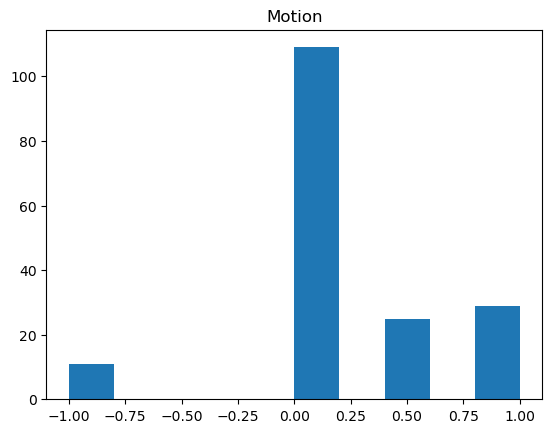

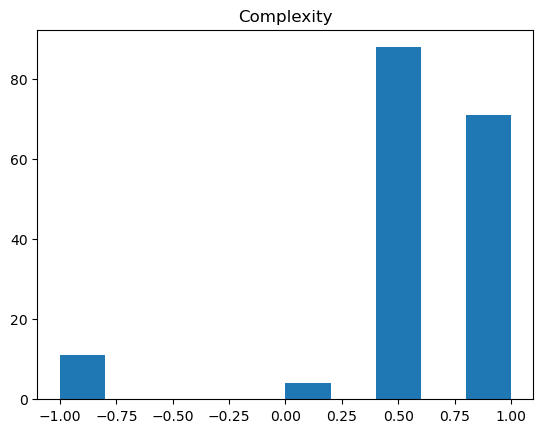

In [66]:
import pandas as pd
with open('labels_715.csv', 'r') as f:
    labels = pd.read_csv(f)
    
# plot the 'motion' column of the labels
plt.hist(labels['motion'])
plt.title('Motion')
plt.show()

# plot the 'complexity' column of the labels
plt.hist(labels['complex'])
plt.title('Complexity')
plt.show()

In [68]:
# load complexity scores for the cells
vals_corr_robs = np.array([val[0] for val in complexity_values])

vals_ground_truth = labels['complex'].values

# remove outliers
vals_ground_truth[vals_ground_truth < 0] = 0
vals_corr_robs[vals_corr_robs < 0] = 0

Text(0, 0.5, 'Complexity (Score)')

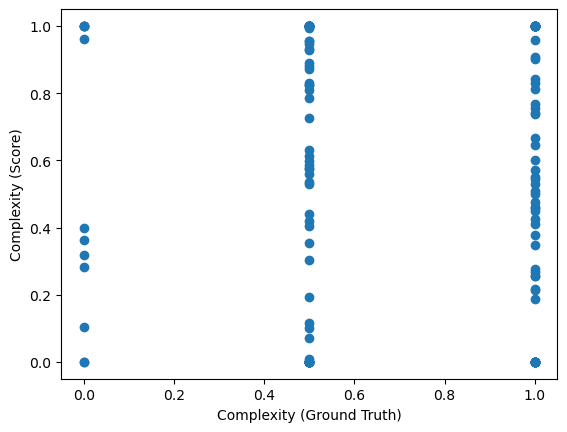

In [69]:
# compare the complexity scores to the ground truth
_ = plt.scatter(labels['complex'], vals_corr_robs)
plt.xlabel('Complexity (Ground Truth)')
plt.ylabel('Complexity (Score)')

Text(0, 0.5, 'time')

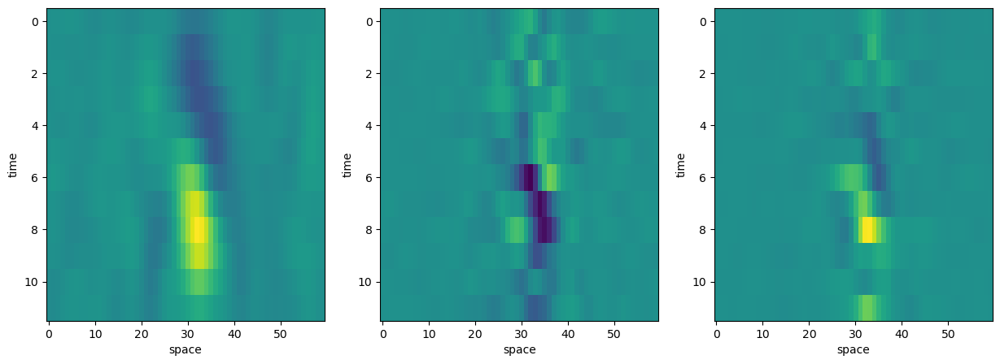